### Credit EDA


 
- This file comprises of all the analysis of the given dataset.
- Note: Some code cells, specifically those that generates Graphs/Charts may run for a longer time.
- Coded using VScode, Ubuntu 22-64bit, 16GB RAM, 4.5GHZ

In [1]:
# import all libraries numpy, pandas, matplotlib, seaborn. 

import numpy as np, pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns; sns.set_theme(color_codes=True)

import warnings
warnings.filterwarnings('ignore')

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = 'all'
# %matplotlib inline

# Set custom display properties in pandas
pd.set_option("display.max_rows", 900)
pd.set_option("display.max_columns", 900) 
pd.set_option('display.float_format', lambda x: '%.3f' % x)

In [2]:
# read 'application_data.csv' and store the dataframe as 'curr_appl_data'
curr_appl_data = pd.read_csv("application_data.csv", sep=",", header=0)

# read 'previous_application.csv' and store the dataframe as 'prev_appl_data'
prev_appl_data = pd.read_csv("previous_application.csv", sep=",", header=0)

#### Custom Functions

In [3]:
# classify_feature_dtype function is used to distinguish numerical columns either as categorical/discrete or non categorical and return as dict
def classify_feature_dtype(df,cols):
    
    d_categories = {'int_cat': [], "float_ts":[] }
    for col in cols:
        if (len(df[col].unique()) < 10):
            d_categories['int_cat'].append(col)
        else:
            d_categories['float_ts'].append(col)
    return d_categories

# show_stats function is used to print all statistical information for a given set of columns
def show_stats(df, cols):
    for col in list(cols):
        print("Total Nulls: {0},\nMode: {1}".format(df[col].isna().sum(), df[col].mode()[0]))
        if len(df[col].unique()) < 50:
            print("\nUnique: {0}\n".format(df[col].unique()))
        if (df[col].dtype == int) or (df[col].dtype == float):
            print("Median   : {0}, \nVariance: {1}, \n\nDescribe: {2} \n".format(df[col].median(), df[col].var(), df[col].describe()))
        print("ValueCounts: {0} \n\n\n".format((df[col].value_counts(normalize=True) * 100).head(5)))
        print("------------------------------------------------------------------")

# check_cols_null_pct - to return the percentage of null values in each columns in a dataframe
def check_cols_null_pct(df):
    df_non_na = df.count() / len(df)  # Ratio of non null values
    df_na_pct = (1 - df_non_na) * 100 # Find the Percentage of null values
    return df_na_pct.sort_values(ascending=False) # Sort the resulting values in descending order

# univariate_plots function generates charts based on the data type of the cols, as part of the univariate analysis 
# it takes dataframe, columns, train data 0,1, and feature type as args.
def univariate_plots(df, cols, t0=None, t1=None, ftype=None):
    
    for col in cols:
        #generate plots and graphs for category type. (generates piechart, countplot, boxplot / if training data is provided it generates bar chart instead)
        if ftype == "category":
            if (t0 is not None) and (t1 is not None):
                fig, axs = plt.subplots(1, 3, figsize=(20, 6))
            else:
                fig, axs = plt.subplots(1, 2, figsize=(20, 6))
            
            col_idx = 0
            
            axs[col_idx].pie(x=df[col].value_counts().head(5), labels=df[col].value_counts().head(5).index, autopct="%1.1f%%", 
                    radius=1, textprops={"fontsize": 10, "color": "Black"}, startangle=90, rotatelabels=False)
            axs[col_idx].set_title("Pichart of {0}".format(col), y=1); plt.xticks(rotation=45); plt.ylabel("Percentage")
            fig.subplots_adjust(wspace=0.5, hspace=0.3)
            
            col_idx += 1

            sns.countplot(data=df, y=col, order=df[col].value_counts().index, palette="viridis",  ax=axs[col_idx])
            axs[col_idx].set_title("Countplot of {0}".format(col)); plt.xticks(rotation=45); plt.xlabel(col); plt.ylabel("Count")
            fig.subplots_adjust(wspace=0.5, hspace=0.3)

            col_idx += 1
            
            if (t0 is not None) and (t1 is not None):
                dff = pd.DataFrame()
                dff['target_0_nodffty']= ((t0[col].value_counts())/len(t0))
                dff['target_1_paydfty']= ((t1[col].value_counts())/len(t1))
                dff.plot.bar(ax=axs[col_idx])
                axs[col_idx].set_title('Plotting data for target in terms of percentage'); plt.xticks(rotation=45); plt.xlabel(col)
                fig.subplots_adjust(wspace=0.5, hspace=0.3)
                
            # else:
            #     sns.boxplot(data=df, y=col, palette="viridis", flierprops=dict( marker="o", markersize=6, markerfacecolor="red", markeredgecolor="black", ),
            #             medianprops=dict(linestyle="-", linewidth=3, color="#FF9900"), whiskerprops=dict(linestyle="-", linewidth=2, color="black"),
            #             capprops=dict(linestyle="-", linewidth=2, color="black"), ax=axs[col_idx])
            #     axs[col_idx].set_title("Boxplot of {0}".format(col)); plt.xticks(rotation=45); plt.xlabel(col)
            #     fig.subplots_adjust(wspace=0.5, hspace=0.3)

            plt.suptitle("Univariate analysis of {0}".format(col), fontsize=12, y=0.95)
            plt.tight_layout()
            plt.subplots_adjust(top=0.85)
            plt.show()
            plt.clf()

        #generate plots and graphs for numerical types. (generates boxplot, histplot, kdeplot, scatterplot)
        elif ftype == "non_categorical":        
            fig, axs = plt.subplots(1, 4, figsize=(20, 6))
            col_idx = 0
            sns.boxplot(data=df, y=col, palette="viridis", 
                        flierprops=dict( marker="o", markersize=6, markerfacecolor="red", markeredgecolor="black"),
                        medianprops=dict(linestyle="-", linewidth=3, color="#FF9900"), whiskerprops=dict(linestyle="-", linewidth=2, color="black"),
                        capprops=dict(linestyle="-", linewidth=2, color="black"), ax=axs[col_idx])
            axs[col_idx].set_title("Boxplot of {0}".format(col)); plt.xticks(rotation=45); plt.xlabel(col)
            fig.subplots_adjust(wspace=0.5, hspace=0.3)
            col_idx += 1

            axs[col_idx].hist(data=df, x=col, label=col)
            axs[col_idx].set_title("Histogram of {0}".format(col)); plt.xticks(rotation=45); plt.xlabel(col)
            fig.subplots_adjust(wspace=0.5, hspace=0.3)
            col_idx += 1

            sns.kdeplot(df[col], shade=True, ax=axs[col_idx])
            axs[col_idx].set_title("KDE plot of {0}".format(col)); plt.xticks(rotation=45); plt.xlabel(col)
            fig.subplots_adjust(wspace=0.5, hspace=0.3)
            col_idx += 1

            sns.scatterplot(df[col], ax=axs[col_idx])
            axs[col_idx].set_title("Scatterplot of {0}".format(col)); plt.xticks(rotation=45); plt.xlabel(col)
            fig.subplots_adjust(wspace=0.5, hspace=0.3)

            plt.suptitle("Univariate analysis of {0}".format(col), fontsize=12, y=0.95)
            plt.tight_layout()
            plt.subplots_adjust(top=0.85)
            plt.show()
            plt.clf()

# bivariate_plots function generates charts based on the data type of the cols, as part of the bivariate analysis 
# it takes dataframe, columns, hue, train data 0,1, as args.
def bivariate_plots(df, col, hue, train0, train1):
    fig = plt.figure(figsize=(20,10))

    ax1 = plt.subplot(221)
    df[col].value_counts().plot.pie(autopct = "%1.1f%%", radius=1.4, textprops={"fontsize": 10, "color": "Black"}, startangle=30, rotatelabels=True, ax=ax1)
    plt.figtext(0.25, 0.55, 'Pie Chart for : '+ col, ha='center')
    # plt.title('Plotting data for the column: '+ col, loc='right', fontdict={'verticalalignment': 'baseline', 'horizontalalignment': 'right'})
    # fig.subplots_adjust(wspace=0.5, hspace=0.3)

    ax2 = plt.subplot(222)
    df = pd.DataFrame()
    df['0']= ((train0[col].value_counts())/len(train0))
    df['1']= ((train1[col].value_counts())/len(train1))
    df.plot.bar(ax=ax2,)
    plt.title('Plotting data for target in terms of total count')
    plt.xticks(rotation=45)
    fig.subplots_adjust(wspace=0.5, hspace=0.3)

    ax3 = plt.subplot(223)
    sns.countplot(x=col, hue=hue, data=train0, ax = ax3)
    plt.xticks(rotation=45)
    plt.title('Plotting data for Target=0 in terms of percentage')
    fig.subplots_adjust(wspace=0.5, hspace=0.3)

    ax4 = plt.subplot(224)
    sns.countplot(x=col, hue=hue, data=train1, ax = ax4)
    plt.xticks(rotation=45)
    plt.title('Plotting data for Target=1 in terms of percentage')
    fig.subplots_adjust(wspace=0.5, hspace=0.3)
    
    plt.tight_layout()
    
    plt.show()
    plt.clf()

#### Data Cleaning - Current Application Dataset

In [4]:
check_cols_null_pct(curr_appl_data)

COMMONAREA_MEDI                69.872
COMMONAREA_AVG                 69.872
COMMONAREA_MODE                69.872
NONLIVINGAPARTMENTS_MODE       69.433
NONLIVINGAPARTMENTS_AVG        69.433
NONLIVINGAPARTMENTS_MEDI       69.433
FONDKAPREMONT_MODE             68.386
LIVINGAPARTMENTS_MODE          68.355
LIVINGAPARTMENTS_AVG           68.355
LIVINGAPARTMENTS_MEDI          68.355
FLOORSMIN_AVG                  67.849
FLOORSMIN_MODE                 67.849
FLOORSMIN_MEDI                 67.849
YEARS_BUILD_MEDI               66.498
YEARS_BUILD_MODE               66.498
YEARS_BUILD_AVG                66.498
OWN_CAR_AGE                    65.991
LANDAREA_MEDI                  59.377
LANDAREA_MODE                  59.377
LANDAREA_AVG                   59.377
BASEMENTAREA_MEDI              58.516
BASEMENTAREA_AVG               58.516
BASEMENTAREA_MODE              58.516
EXT_SOURCE_1                   56.381
NONLIVINGAREA_MODE             55.179
NONLIVINGAREA_AVG              55.179
NONLIVINGARE

- The above outputs list contains many (~40+) columns that have null percentage greater than or equal to 50%.

In [5]:
# Checks the percentage of null values in each columns of a dataframe
curr_appl_na_pct = check_cols_null_pct(curr_appl_data)
curr_appl_data1 = curr_appl_data.loc[:, (curr_appl_na_pct < 50)]
curr_appl_data1.columns

Index(['SK_ID_CURR', 'TARGET', 'NAME_CONTRACT_TYPE', 'CODE_GENDER',
       'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'CNT_CHILDREN', 'AMT_INCOME_TOTAL',
       'AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE', 'NAME_TYPE_SUITE',
       'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS',
       'NAME_HOUSING_TYPE', 'REGION_POPULATION_RELATIVE', 'DAYS_BIRTH',
       'DAYS_EMPLOYED', 'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH', 'FLAG_MOBIL',
       'FLAG_EMP_PHONE', 'FLAG_WORK_PHONE', 'FLAG_CONT_MOBILE', 'FLAG_PHONE',
       'FLAG_EMAIL', 'OCCUPATION_TYPE', 'CNT_FAM_MEMBERS',
       'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY',
       'WEEKDAY_APPR_PROCESS_START', 'HOUR_APPR_PROCESS_START',
       'REG_REGION_NOT_LIVE_REGION', 'REG_REGION_NOT_WORK_REGION',
       'LIVE_REGION_NOT_WORK_REGION', 'REG_CITY_NOT_LIVE_CITY',
       'REG_CITY_NOT_WORK_CITY', 'LIVE_CITY_NOT_WORK_CITY',
       'ORGANIZATION_TYPE', 'EXT_SOURCE_2', 'EXT_SOURCE_3',
       'YEARS_BEGINEXPLUATATION_AVG', 'FLOOR

- Since there are many columns that have null values and are more than 50%it is generally not recommended to impute it, 
- Therefore we drop all columns greater than 50%

In [6]:
#helper function to print all statistical information for given columns in df
show_stats(curr_appl_data1, curr_appl_data1.columns) 

Total Nulls: 0,
Mode: 100002
Median   : 278202.0, 
Variance: 10565820148.159698, 

Describe: count   307511.000
mean    278180.519
std     102790.175
min     100002.000
25%     189145.500
50%     278202.000
75%     367142.500
max     456255.000
Name: SK_ID_CURR, dtype: float64 

ValueCounts: SK_ID_CURR
100002   0.000
337664   0.000
337661   0.000
337660   0.000
337659   0.000
Name: proportion, dtype: float64 



------------------------------------------------------------------
Total Nulls: 0,
Mode: 0

Unique: [1 0]

Median   : 0.0, 
Variance: 0.07421191849651897, 

Describe: count   307511.000
mean         0.081
std          0.272
min          0.000
25%          0.000
50%          0.000
75%          0.000
max          1.000
Name: TARGET, dtype: float64 

ValueCounts: TARGET
0   91.927
1    8.073
Name: proportion, dtype: float64 



------------------------------------------------------------------
Total Nulls: 0,
Mode: Cash loans

Unique: ['Cash loans' 'Revolving loans']

ValueCounts:

In [7]:
DAYS_COLS = curr_appl_data1.filter(like="DAYS").columns  # select all cols that contain DAYS
FLAG_COLS = curr_appl_data1.filter(like="FLAG").columns  # select all cols that contain FLAG

FLOORSMAX_COLS = curr_appl_data1.columns[curr_appl_data1.columns.str.contains("FLOORSMAX")]                 # select all cols that contains FLOORSMAX
BEGINEXPLUATATION_COLS = curr_appl_data1.columns[curr_appl_data1.columns.str.contains("BEGINEXPLUATATION")] # select all cols that contains BEGINEXPLUATATION
AMT_REQ_CREDIT_BUREAU_COLS = curr_appl_data1.columns[curr_appl_data1.columns.str.contains("AMT_REQ_CREDIT_BUREAU")] # select all cols that contains AMT_REQ_CREDIT_BUREAU

# curr_appl_data1["FLOORSMAX"] = curr_appl_data1[FLOORSMAX_COLS].sum(axis=1, skipna=False) / len(FLOORSMAX_COLS)
# curr_appl_data1["YEARS_BEGINEXPLOITATION"] = curr_appl_data1.loc[:, BEGINEXPLUATATION_COLS].sum(axis=1, skipna=False) / len(BEGINEXPLUATATION_COLS)
curr_appl_data1["FLOORSMAX"] = curr_appl_data1[FLOORSMAX_COLS].mean(axis=1, skipna=False)
curr_appl_data1["YEARS_BEGINEXPLOITATION"] = curr_appl_data1.loc[:, BEGINEXPLUATATION_COLS].mean(axis=1, skipna=False)

- The above features are generally considred additional features , 
- In order to minimize the no of cols, clubbed similar cols & created single feature col (considered using mean among Min/Max/Mean/Median, interative approach)  

In [8]:
_ = [curr_appl_data1[col].fillna(curr_appl_data1[col].mode()[0], inplace=True) for col in AMT_REQ_CREDIT_BUREAU_COLS]
curr_appl_data1["FLOORSMAX"] = curr_appl_data1["FLOORSMAX"].fillna( curr_appl_data1["FLOORSMAX"].median())
curr_appl_data1["EXT_SOURCE_2"] = curr_appl_data1["EXT_SOURCE_2"].fillna( curr_appl_data1["EXT_SOURCE_2"].median())
curr_appl_data1["EXT_SOURCE_3"] = curr_appl_data1["EXT_SOURCE_3"].fillna( curr_appl_data1["EXT_SOURCE_3"].median())
curr_appl_data1["TOTALAREA_MODE"] = curr_appl_data1["TOTALAREA_MODE"].fillna( curr_appl_data1["TOTALAREA_MODE"].mean())
curr_appl_data1["NAME_TYPE_SUITE"] = curr_appl_data1["NAME_TYPE_SUITE"].fillna( curr_appl_data1["NAME_TYPE_SUITE"].mode()[0])
curr_appl_data1["CNT_FAM_MEMBERS"] = curr_appl_data1["CNT_FAM_MEMBERS"].fillna( curr_appl_data1["CNT_FAM_MEMBERS"].mode()[0])
curr_appl_data1["EMERGENCYSTATE_MODE"] = curr_appl_data1["EMERGENCYSTATE_MODE"].fillna( curr_appl_data1["EMERGENCYSTATE_MODE"].mode()[0])
curr_appl_data1["DAYS_LAST_PHONE_CHANGE"] = curr_appl_data1["DAYS_LAST_PHONE_CHANGE"].fillna(curr_appl_data1["DAYS_LAST_PHONE_CHANGE"].median())
curr_appl_data1["YEARS_BEGINEXPLOITATION"] = curr_appl_data1["YEARS_BEGINEXPLOITATION"].fillna(curr_appl_data1["YEARS_BEGINEXPLOITATION"].mean())
curr_appl_data1["OBS_30_CNT_SOCIAL_CIRCLE"] = curr_appl_data1["OBS_30_CNT_SOCIAL_CIRCLE"].fillna(curr_appl_data1["OBS_30_CNT_SOCIAL_CIRCLE"].mode()[0])
curr_appl_data1["OBS_60_CNT_SOCIAL_CIRCLE"] = curr_appl_data1["OBS_60_CNT_SOCIAL_CIRCLE"].fillna(curr_appl_data1["OBS_60_CNT_SOCIAL_CIRCLE"].mode()[0])
curr_appl_data1["DEF_30_CNT_SOCIAL_CIRCLE"] = curr_appl_data1["DEF_30_CNT_SOCIAL_CIRCLE"].fillna(curr_appl_data1["DEF_30_CNT_SOCIAL_CIRCLE"].mode()[0])
curr_appl_data1["DEF_60_CNT_SOCIAL_CIRCLE"] = curr_appl_data1["DEF_60_CNT_SOCIAL_CIRCLE"].fillna(curr_appl_data1["DEF_60_CNT_SOCIAL_CIRCLE"].mode()[0])
# curr_appl_data1 = curr_appl_data1[~curr_appl_data1[["AMT_ANNUITY", "AMT_GOODS_PRICE"]].isna().any(axis=1)]
curr_appl_data1["AMT_ANNUITY"] = curr_appl_data1["AMT_ANNUITY"].fillna( curr_appl_data1["AMT_ANNUITY"].mean())
curr_appl_data1["AMT_GOODS_PRICE"] = curr_appl_data1["AMT_GOODS_PRICE"].fillna( curr_appl_data1["AMT_GOODS_PRICE"].mean())

- since there are many null values among cols, tried to impute it based on stats for the specific columns. 
- for categorical/discrete columns, considered Mode if the frequency of the topmost value is above 50%.
- for numerical columns - considered Mean, Median, based on distribution and skewness.
- AMT_ANNUITY, AMT_GOODS_PRICE are considered critical features, 
- To impute such features, we need to identify whether it is MAR, MNAR, MCAR. also to analyse dependency cols and distribution set to finetune the imputation.
- for this analysis, since the missing values are negligible (>200) values , we considered it to be of less impact to the outcome of the analysis, 
- To keep the dataset as it is, we therefore decided to fill null values with the mean of the column, instead of dropping it.

In [9]:
curr_appl_data1 = curr_appl_data1.drop(FLOORSMAX_COLS, axis=1)
curr_appl_data1 = curr_appl_data1.drop(BEGINEXPLUATATION_COLS, axis=1)

- FLOORSMAX_COLS, BEGINEXPLUATATION_COLS collections are featured engineered and hence reduntant, therefore we dropped those columns

In [10]:
# curr_appl_data1["EMERGENCYSTATE_MODE"] = curr_appl_data1["EMERGENCYSTATE_MODE"].replace(to_replace=["Yes", "No"], value=[1, 0])

curr_appl_data1["FLAG_OWN_CAR"] = curr_appl_data1["FLAG_OWN_CAR"].replace(to_replace=["Y", "N"], value=["Yes", "No"])
curr_appl_data1["FLAG_OWN_REALTY"] = curr_appl_data1["FLAG_OWN_REALTY"].replace(to_replace=["Y", "N"], value=["Yes", "No"])

curr_appl_data1["NAME_TYPE_SUITE"] = curr_appl_data1["NAME_TYPE_SUITE"].replace(to_replace="Spouse, partner", value="Spouse")
curr_appl_data1["NAME_TYPE_SUITE"] = curr_appl_data1["NAME_TYPE_SUITE"].replace(to_replace=["Other_A", "Other_B"], value=["Others", "Others"])
curr_appl_data1["NAME_HOUSING_TYPE"] = curr_appl_data1["NAME_HOUSING_TYPE"].replace(to_replace="House / apartment", value="House")
curr_appl_data1["NAME_FAMILY_STATUS"] = curr_appl_data1["NAME_FAMILY_STATUS"].replace(to_replace="Single / not married", value="Single")
curr_appl_data1["NAME_EDUCATION_TYPE"] = curr_appl_data1["NAME_EDUCATION_TYPE"].replace(to_replace="Secondary / secondary special", value="Secondary")

- Some categorical column values are more detailed, therefore replaced with more apt and common terms

In [11]:
curr_appl_data1[DAYS_COLS] = (abs(curr_appl_data1[DAYS_COLS]) / 365).astype(int)

- DAYS_COLS - Is a list of days type columns, represented in days count, 
- There were inconsistencies, therefore made all values absolute, then converted it to years count by dividing it with 365.

In [12]:
days_to_years = {i: i.replace("DAYS", "YEARS") for i in DAYS_COLS}
curr_appl_data1 = curr_appl_data1.rename(columns=days_to_years)
curr_appl_data1.rename(columns={'YEARS_BIRTH': 'AGE_IN_YEARS'})
YEARS_COLS = curr_appl_data1.filter(like="YEARS").columns

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,AGE_IN_YEARS,YEARS_EMPLOYED,YEARS_REGISTRATION,YEARS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,TOTALAREA_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,YEARS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,FLOORSMAX,YEARS_BEGINEXPLOITATION
0,100002,1,Cash loans,M,No,Yes,0,202500.000,406597.500,24700.500,351000.000,Unaccompanied,Working,Secondary,Single,House,0.019,25,1,9,5,1,1,0,1,1,0,Laborers,1.000,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.263,0.139,0.015,No,2.000,2.000,2.000,2.000,3,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.000,0.000,0.000,0.000,0.000,1.000,0.083,0.972
1,100003,0,Cash loans,F,No,No,0,270000.000,1293502.500,35698.500,1129500.000,Family,State servant,Higher education,Married,House,0.004,45,3,3,0,1,1,0,1,1,0,Core staff,2.000,1,1,MONDAY,11,0,0,0,0,0,0,School,0.622,0.535,0.071,No,1.000,0.000,1.000,0.000,2,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.000,0.000,0.000,0.000,0.000,0.000,0.292,0.985
2,100004,0,Revolving loans,M,Yes,Yes,0,67500.000,135000.000,6750.000,135000.000,Unaccompanied,Working,Secondary,Single,House,0.010,52,0,11,6,1,1,1,1,1,0,Laborers,1.000,2,2,MONDAY,9,0,0,0,0,0,0,Government,0.556,0.730,0.103,No,0.000,0.000,0.000,0.000,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.000,0.000,0.000,0.000,0.000,0.000,0.167,0.978
3,100006,0,Cash loans,F,No,Yes,0,135000.000,312682.500,29686.500,297000.000,Unaccompanied,Working,Secondary,Civil marriage,House,0.008,52,8,26,6,1,1,0,1,0,0,Laborers,2.000,2,2,WEDNESDAY,17,0,0,0,0,0,0,Business Entity Type 3,0.650,0.535,0.103,No,2.000,0.000,2.000,0.000,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.000,0.000,0.000,0.000,0.000,0.000,0.167,0.978
4,100007,0,Cash loans,M,No,Yes,0,121500.000,513000.000,21865.500,513000.000,Unaccompanied,Working,Secondary,Single,House,0.029,54,8,11,9,1,1,0,1,0,0,Core staff,1.000,2,2,THURSDAY,11,0,0,0,0,1,1,Religion,0.323,0.535,0.103,No,0.000,0.000,0.000,0.000,3,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.000,0.000,0.000,0.000,0.000,0.000,0.167,0.978
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307506,456251,0,Cash loans,M,No,No,0,157500.000,254700.000,27558.000,225000.000,Unaccompanied,Working,Secondary,Separated,With parents,0.033,25,0,23,5,1,1,0,1,0,0,Sales staff,1.000,1,1,THURSDAY,15,0,0,0,0,0,0,Services,0.682,0.535,0.290,No,0.000,0.000,0.000,0.000,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.000,0.000,0.000,0.000,0.000,0.000,0.556,0.984
307507,456252,0,Cash loans,F,No,Yes,0,72000.000,269550.000,12001.500,225000.000,Unaccompanied,Pensioner,Secondary,Widow,House,0.025,56,1000,12,11,1,0,0,1,1,0,NaN,1.000,2,2,MONDAY,8,0,0,0

- Renamed DAYS columns to YEARS , since the values are already converted

In [13]:
curr_appl_na_pct1 = check_cols_null_pct(curr_appl_data1)
curr_appl_na_pct1
show_stats(curr_appl_data1, curr_appl_data1.columns)

OCCUPATION_TYPE               31.346
SK_ID_CURR                     0.000
FLAG_DOCUMENT_2                0.000
FLAG_DOCUMENT_8                0.000
FLAG_DOCUMENT_7                0.000
FLAG_DOCUMENT_6                0.000
FLAG_DOCUMENT_5                0.000
FLAG_DOCUMENT_4                0.000
FLAG_DOCUMENT_3                0.000
YEARS_LAST_PHONE_CHANGE        0.000
FLAG_DOCUMENT_10               0.000
DEF_60_CNT_SOCIAL_CIRCLE       0.000
OBS_60_CNT_SOCIAL_CIRCLE       0.000
DEF_30_CNT_SOCIAL_CIRCLE       0.000
OBS_30_CNT_SOCIAL_CIRCLE       0.000
EMERGENCYSTATE_MODE            0.000
TOTALAREA_MODE                 0.000
EXT_SOURCE_3                   0.000
FLAG_DOCUMENT_9                0.000
FLAG_DOCUMENT_11               0.000
ORGANIZATION_TYPE              0.000
FLAG_DOCUMENT_21               0.000
FLOORSMAX                      0.000
AMT_REQ_CREDIT_BUREAU_YEAR     0.000
AMT_REQ_CREDIT_BUREAU_QRT      0.000
AMT_REQ_CREDIT_BUREAU_MON      0.000
AMT_REQ_CREDIT_BUREAU_WEEK     0.000
A

Total Nulls: 0,
Mode: 100002
Median   : 278202.0, 
Variance: 10565820148.159698, 

Describe: count   307511.000
mean    278180.519
std     102790.175
min     100002.000
25%     189145.500
50%     278202.000
75%     367142.500
max     456255.000
Name: SK_ID_CURR, dtype: float64 

ValueCounts: SK_ID_CURR
100002   0.000
337664   0.000
337661   0.000
337660   0.000
337659   0.000
Name: proportion, dtype: float64 



------------------------------------------------------------------
Total Nulls: 0,
Mode: 0

Unique: [1 0]

Median   : 0.0, 
Variance: 0.07421191849651897, 

Describe: count   307511.000
mean         0.081
std          0.272
min          0.000
25%          0.000
50%          0.000
75%          0.000
max          1.000
Name: TARGET, dtype: float64 

ValueCounts: TARGET
0   91.927
1    8.073
Name: proportion, dtype: float64 



------------------------------------------------------------------
Total Nulls: 0,
Mode: Cash loans

Unique: ['Cash loans' 'Revolving loans']

ValueCounts:

- Apart from OCCUPATION_TYPE column all other columns are either dropped, or imputed
- OCCUPATION_TYPE column still has 31% missing values, upon analysis , it is decided that it cannot be replaced only with MODE, since there is no significant representation of categories. 
- Also the column cannot be dropped since it is a critical feature, therefore we decided to identify whether it is MAR, MCAR, MNAR.
- So we keep the column as it is until later stage.

In [14]:
curr_appl_data1["AMT_CREDIT_BINS"] = pd.cut(curr_appl_data1['AMT_CREDIT'], bins=[0,200000,400000,600000,800000,1000000,10000000], labels=["0-200K","200-400k","400-600k","600-800k","800-1M","1M+"])
curr_appl_data1["YEARS_EMPLOYED_BINS"] = pd.cut(curr_appl_data1['YEARS_EMPLOYED'], bins=[-100,10,20,30,40,50,60,1000], labels=["0-10","10-20","20-30","30-40","40-50","50-60","60+"])
curr_appl_data1['AGE_Category'] = pd.cut(curr_appl_data1['YEARS_BIRTH'], [0,30,40,50,60,200], labels=["<30","30-40","40-50","50-60","60+"])
curr_appl_data1

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,YEARS_BIRTH,YEARS_EMPLOYED,YEARS_REGISTRATION,YEARS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,TOTALAREA_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,YEARS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,FLOORSMAX,YEARS_BEGINEXPLOITATION,AMT_CREDIT_BINS,YEARS_EMPLOYED_BINS,AGE_Category
0,100002,1,Cash loans,M,No,Yes,0,202500.000,406597.500,24700.500,351000.000,Unaccompanied,Working,Secondary,Single,House,0.019,25,1,9,5,1,1,0,1,1,0,Laborers,1.000,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.263,0.139,0.015,No,2.000,2.000,2.000,2.000,3,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.000,0.000,0.000,0.000,0.000,1.000,0.083,0.972,400-600k,0-10,<30
1,100003,0,Cash loans,F,No,No,0,270000.000,1293502.500,35698.500,1129500.000,Family,State servant,Higher education,Married,House,0.004,45,3,3,0,1,1,0,1,1,0,Core staff,2.000,1,1,MONDAY,11,0,0,0,0,0,0,School,0.622,0.535,0.071,No,1.000,0.000,1.000,0.000,2,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.000,0.000,0.000,0.000,0.000,0.000,0.292,0.985,1M+,0-10,40-50
2,100004,0,Revolving loans,M,Yes,Yes,0,67500.000,135000.000,6750.000,135000.000,Unaccompanied,Working,Secondary,Single,House,0.010,52,0,11,6,1,1,1,1,1,0,Laborers,1.000,2,2,MONDAY,9,0,0,0,0,0,0,Government,0.556,0.730,0.103,No,0.000,0.000,0.000,0.000,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.000,0.000,0.000,0.000,0.000,0.000,0.167,0.978,0-200K,0-10,50-60
3,100006,0,Cash loans,F,No,Yes,0,135000.000,312682.500,29686.500,297000.000,Unaccompanied,Working,Secondary,Civil marriage,House,0.008,52,8,26,6,1,1,0,1,0,0,Laborers,2.000,2,2,WEDNESDAY,17,0,0,0,0,0,0,Business Entity Type 3,0.650,0.535,0.103,No,2.000,0.000,2.000,0.000,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.000,0.000,0.000,0.000,0.000,0.000,0.167,0.978,200-400k,0-10,50-60
4,100007,0,Cash loans,M,No,Yes,0,121500.000,513000.000,21865.500,513000.000,Unaccompanied,Working,Secondary,Single,House,0.029,54,8,11,9,1,1,0,1,0,0,Core staff,1.000,2,2,THURSDAY,11,0,0,0,0,1,1,Religion,0.323,0.535,0.103,No,0.000,0.000,0.000,0.000,3,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.000,0.000,0.000,0.000,0.000,0.000,0.167,0.978,400-600k,0-10,50-60
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307506,456251,0,Cash loans,M,No,No,0,157500.000,254700.000,27558.000,225000.000,Unaccompanied,Working,Secondary,Separated,With parents,0.033,25,0,23,5,1,1,0,1,0,0,Sales staff,1.000,1,1,THURSDAY,15,0,0,0,0,0,0,Services,0.682,0.535,0.290,No,0.000,0.000,0.000,0.000,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.000,0.000,0.000,0.000,0.000,0.000,0.556,0.984,200-400k,0-10,<30
307507,456252,0,C

In [15]:
curr_appl_data1[curr_appl_data1['OCCUPATION_TYPE'].isna()]['NAME_INCOME_TYPE'].value_counts(normalize=True)

NAME_INCOME_TYPE
Pensioner              0.574
Working                0.259
Commercial associate   0.128
State servant          0.039
Unemployed             0.000
Student                0.000
Businessman            0.000
Maternity leave        0.000
Name: proportion, dtype: float64

Majority of the null values are under Pensioner category, therefore it is highly acceptable to replace Null values in Occupation Types with Pensioner as category

In [16]:
curr_appl_data1["OCCUPATION_TYPE"] = curr_appl_data1["OCCUPATION_TYPE"].fillna('Pensioner')

#### Univariate and Outlier analysis

In [17]:
curr_target_train_0 = curr_appl_data1.loc[curr_appl_data1['TARGET'] == 0]
curr_target_train_1 = curr_appl_data1.loc[curr_appl_data1['TARGET'] == 1]     

- The Requirement is to analyze the features based on Target variable, we therefore segmented it into two parts:
- Train 1 - All the data that is  client with payment difficulties
- Train 0 - All the other set, that doesn't fall under  

- As part of univariate analysis, we will generate plots and charts for all the columns depending on the data type. The inferences are explained below

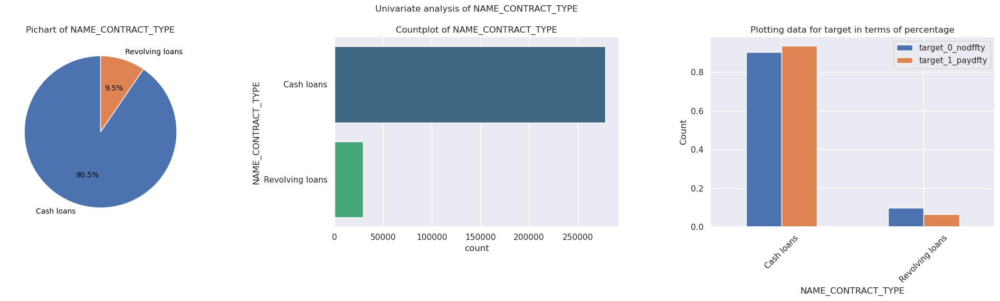

<Figure size 640x480 with 0 Axes>

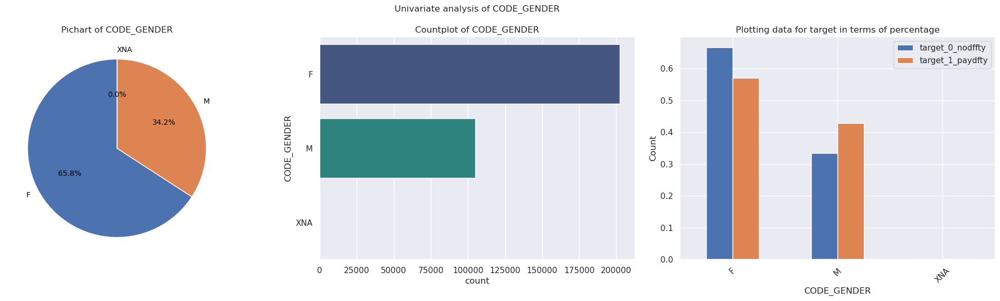

<Figure size 640x480 with 0 Axes>

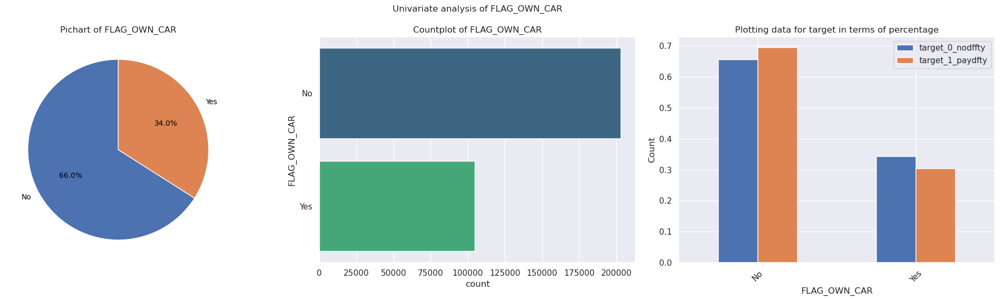

<Figure size 640x480 with 0 Axes>

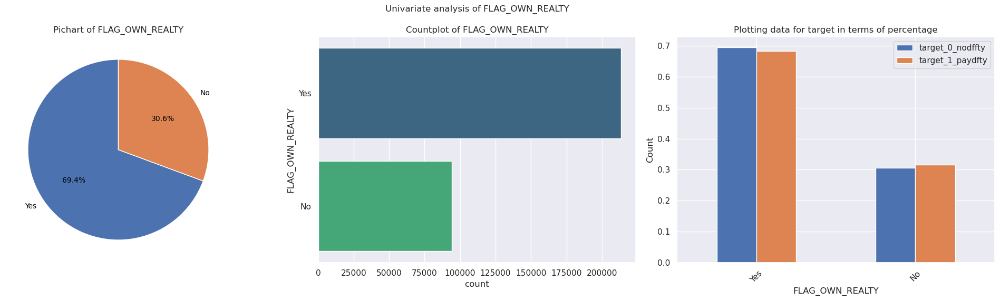

<Figure size 640x480 with 0 Axes>

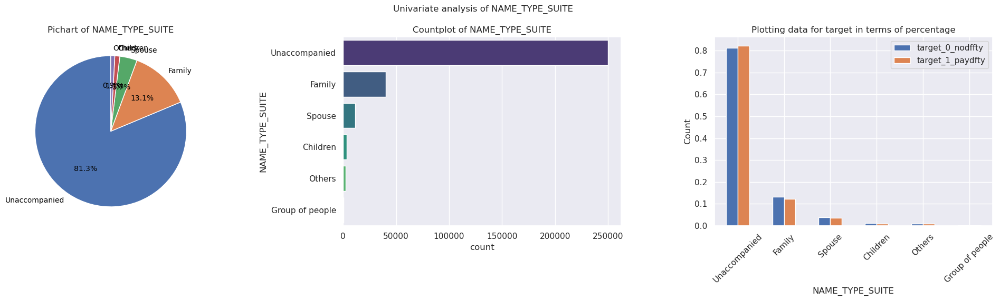

<Figure size 640x480 with 0 Axes>

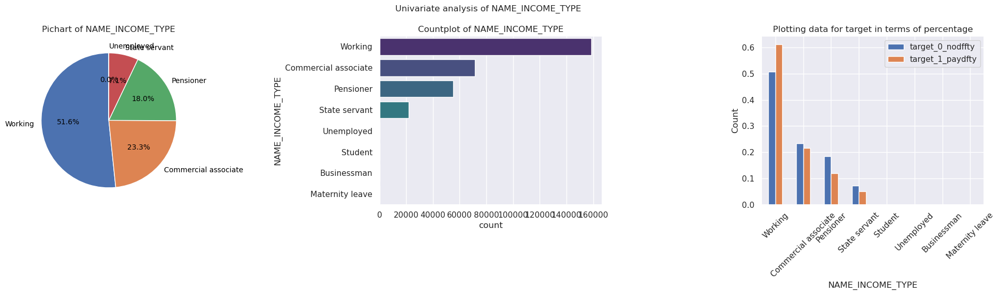

<Figure size 640x480 with 0 Axes>

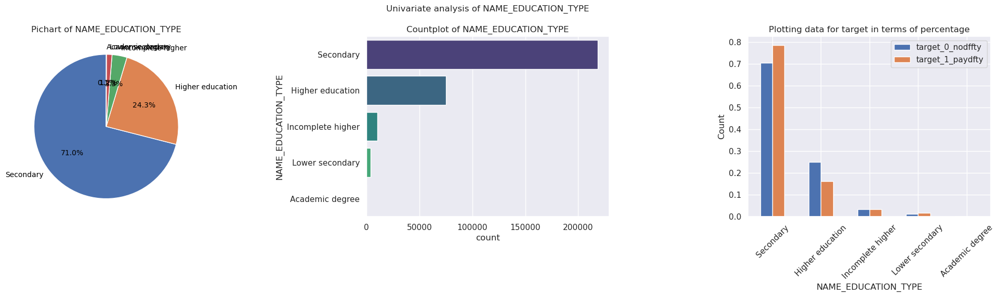

<Figure size 640x480 with 0 Axes>

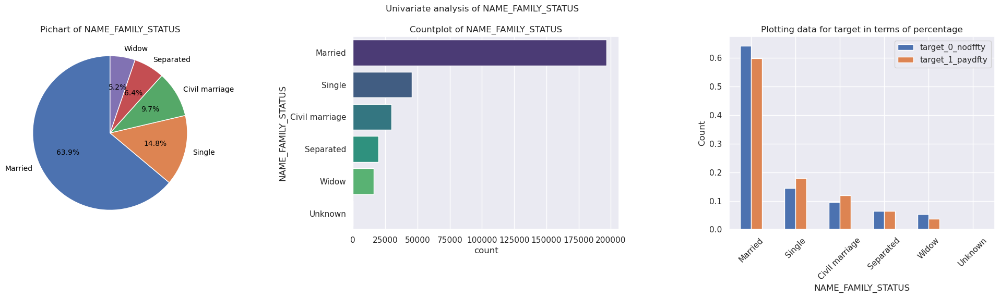

<Figure size 640x480 with 0 Axes>

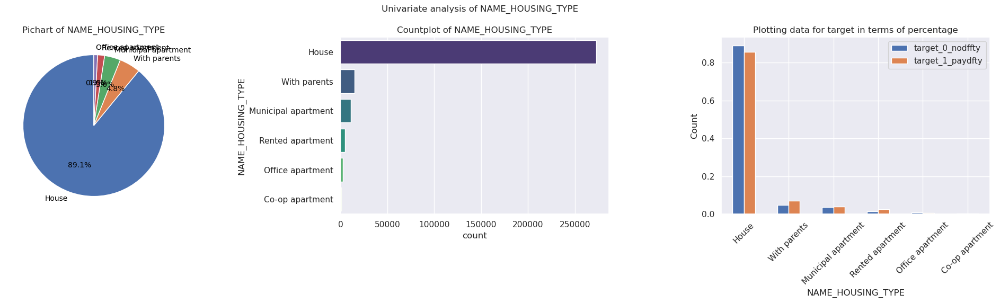

<Figure size 640x480 with 0 Axes>

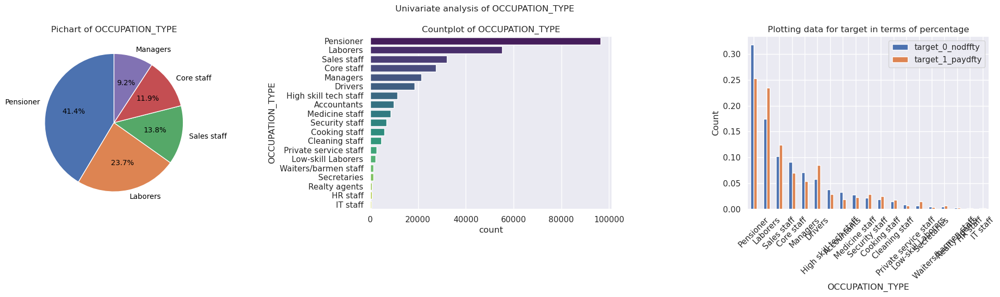

<Figure size 640x480 with 0 Axes>

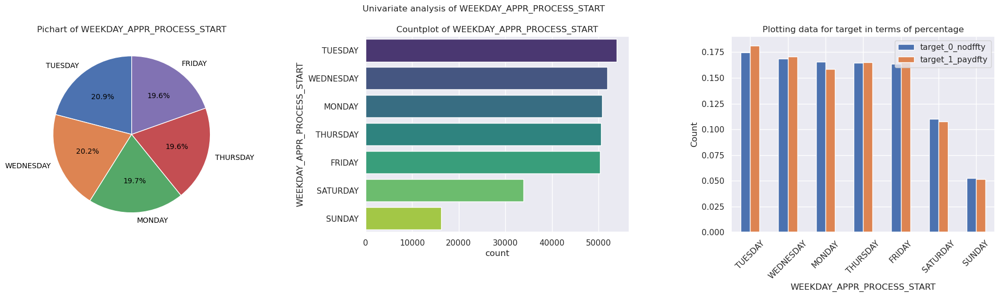

<Figure size 640x480 with 0 Axes>

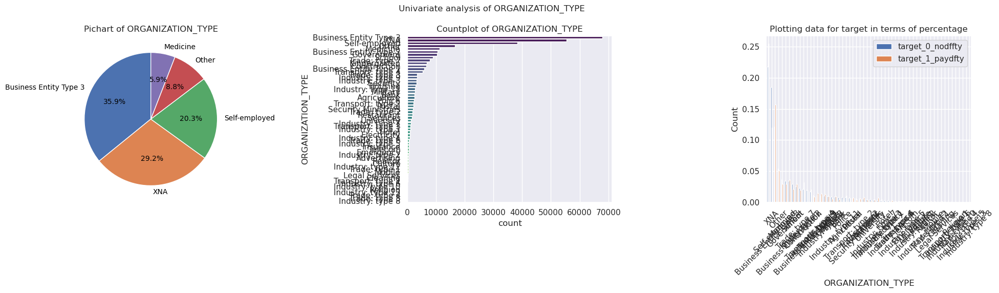

<Figure size 640x480 with 0 Axes>

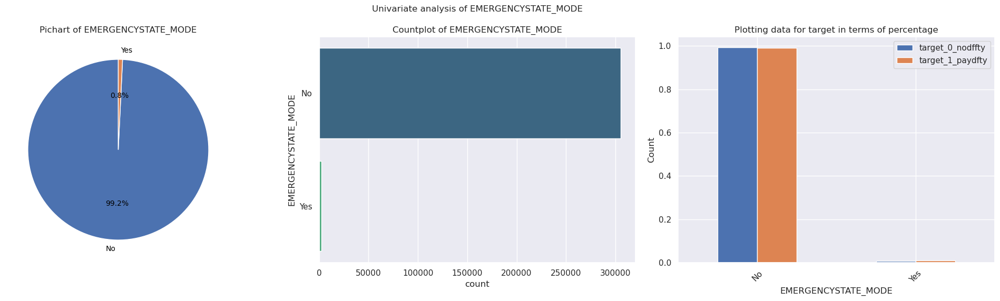

--------------------------------------------------------------------------


<Figure size 640x480 with 0 Axes>

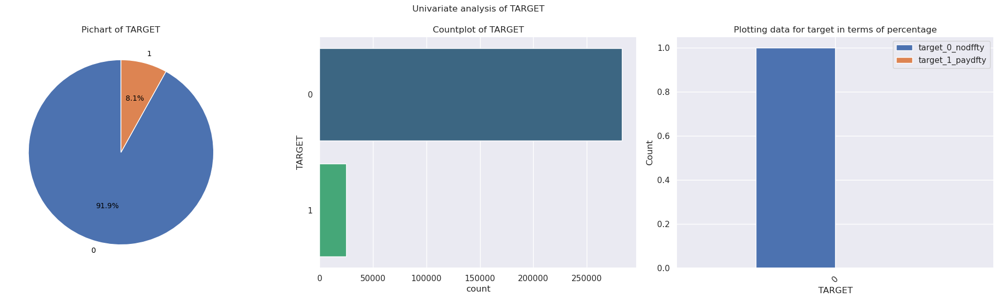

<Figure size 640x480 with 0 Axes>

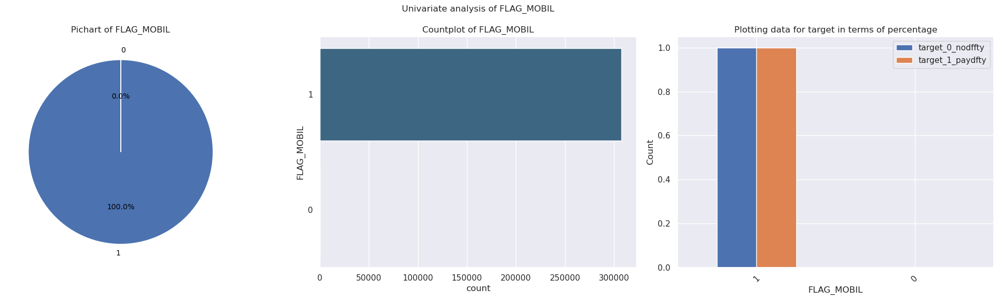

<Figure size 640x480 with 0 Axes>

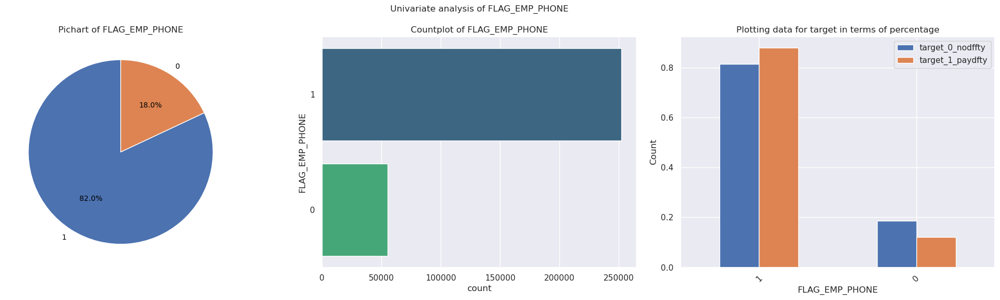

<Figure size 640x480 with 0 Axes>

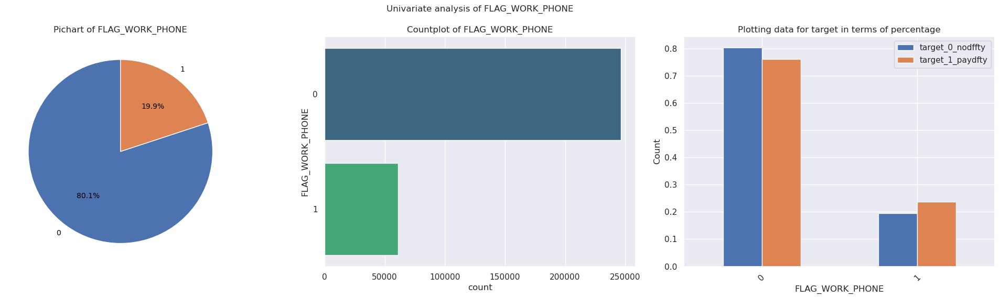

<Figure size 640x480 with 0 Axes>

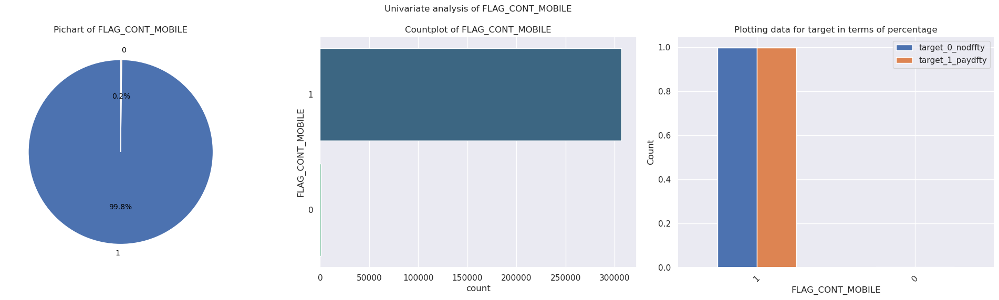

<Figure size 640x480 with 0 Axes>

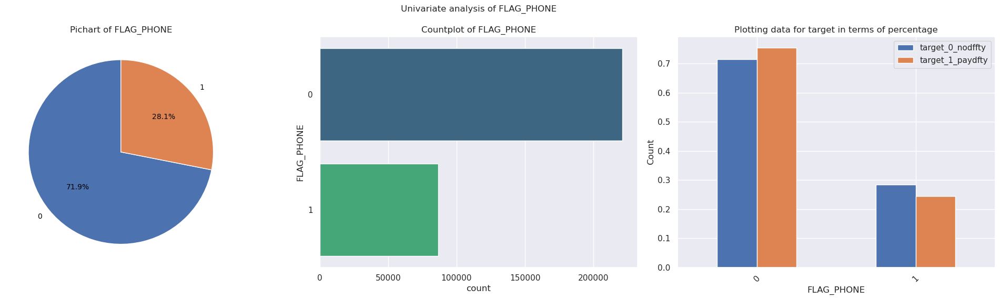

<Figure size 640x480 with 0 Axes>

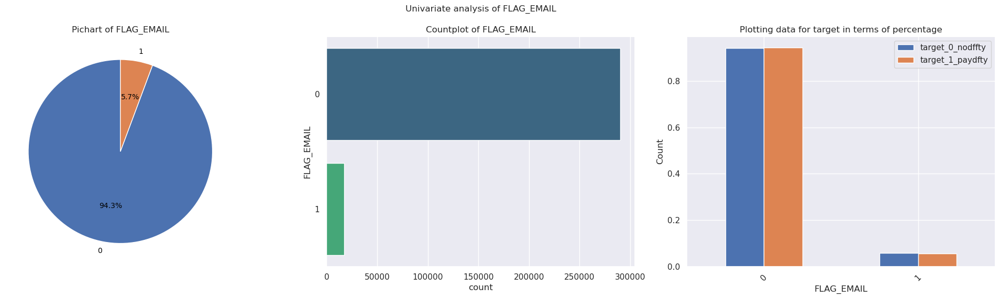

<Figure size 640x480 with 0 Axes>

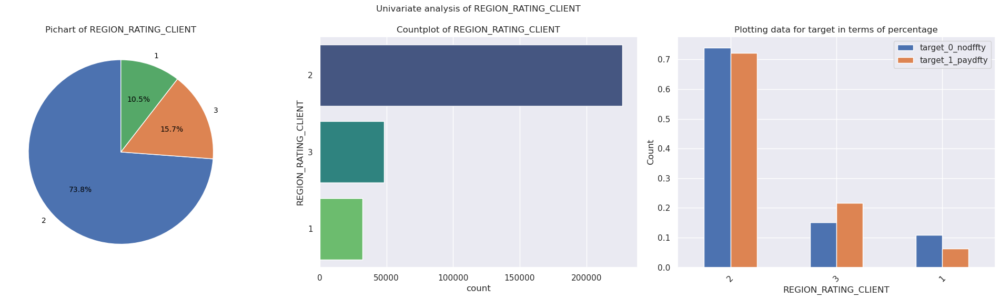

<Figure size 640x480 with 0 Axes>

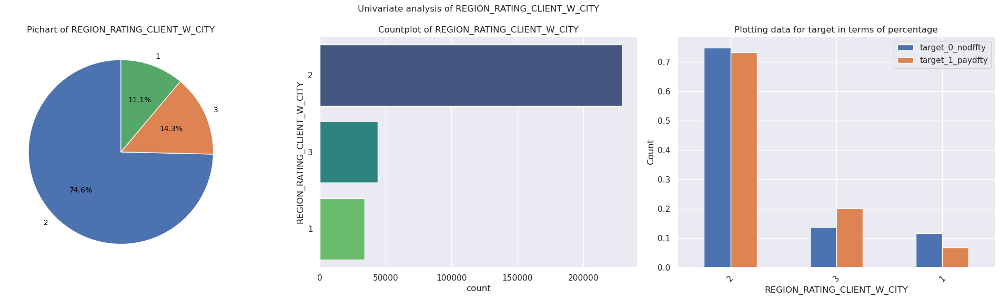

<Figure size 640x480 with 0 Axes>

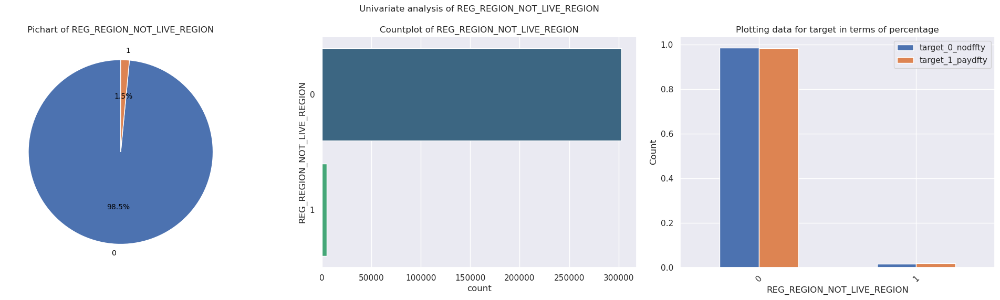

<Figure size 640x480 with 0 Axes>

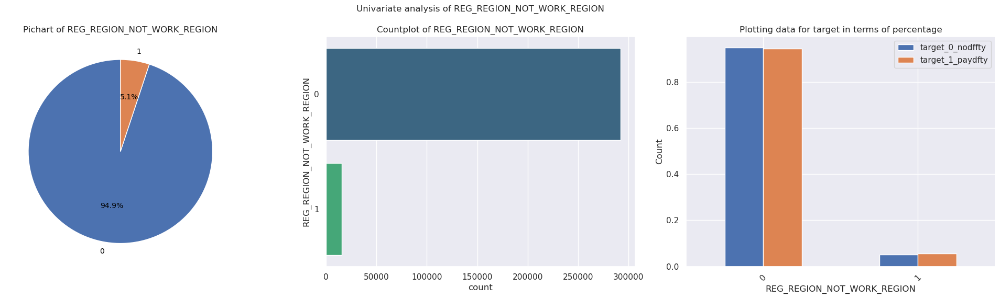

<Figure size 640x480 with 0 Axes>

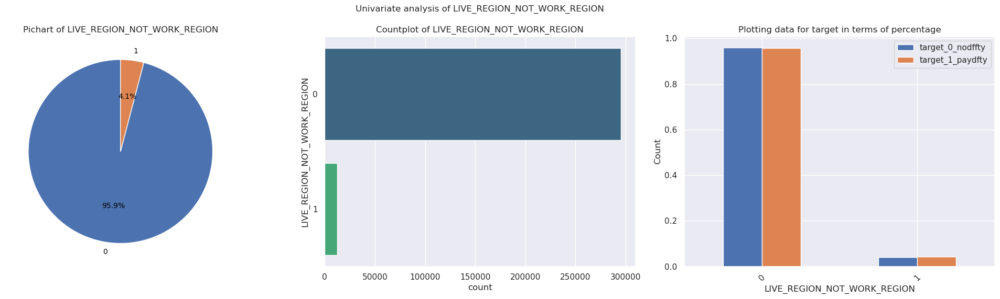

<Figure size 640x480 with 0 Axes>

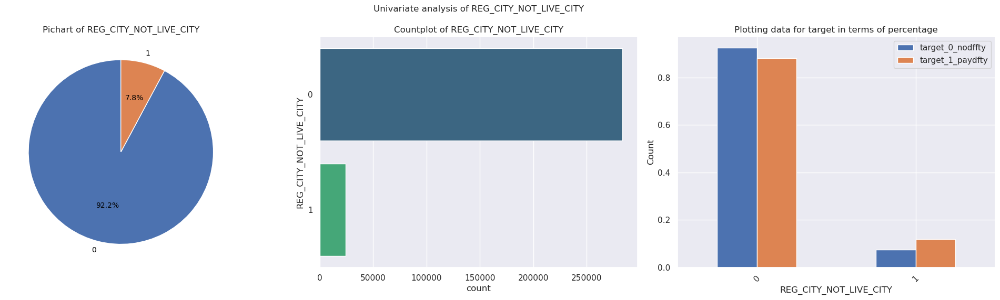

<Figure size 640x480 with 0 Axes>

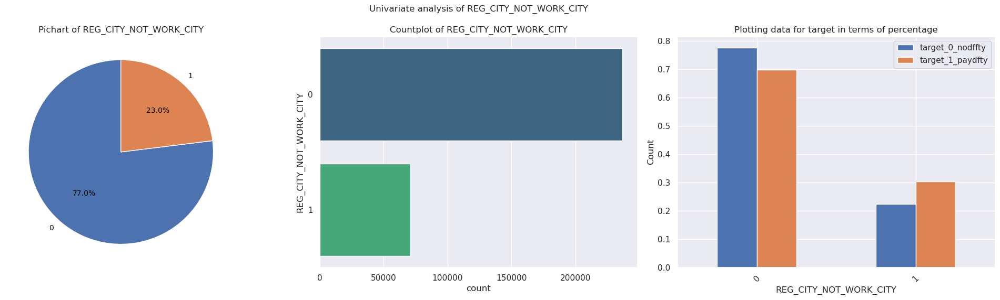

<Figure size 640x480 with 0 Axes>

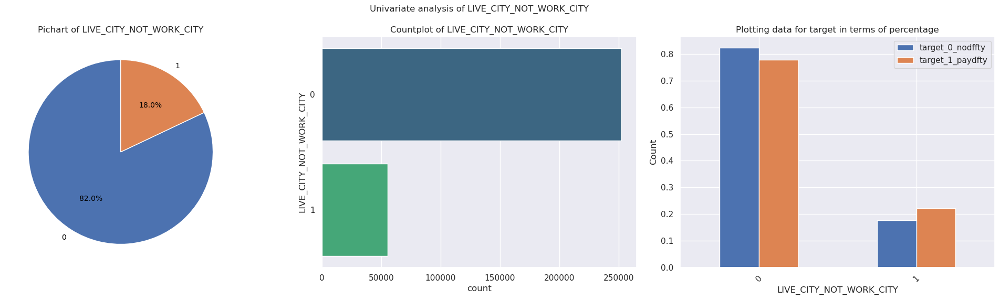

<Figure size 640x480 with 0 Axes>

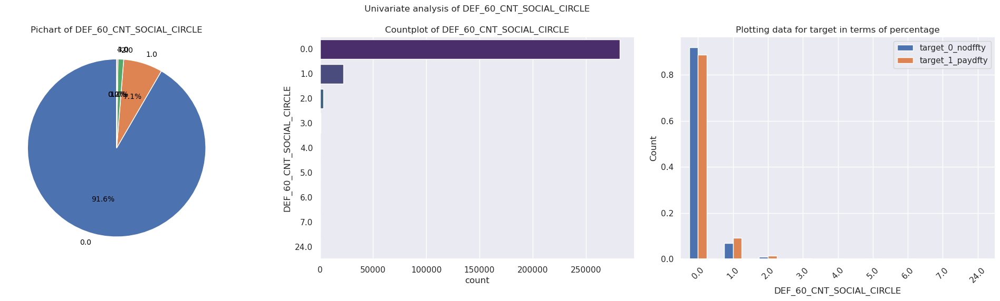

<Figure size 640x480 with 0 Axes>

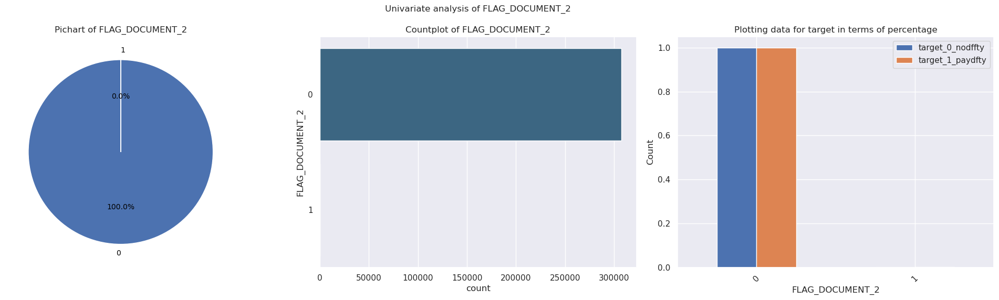

<Figure size 640x480 with 0 Axes>

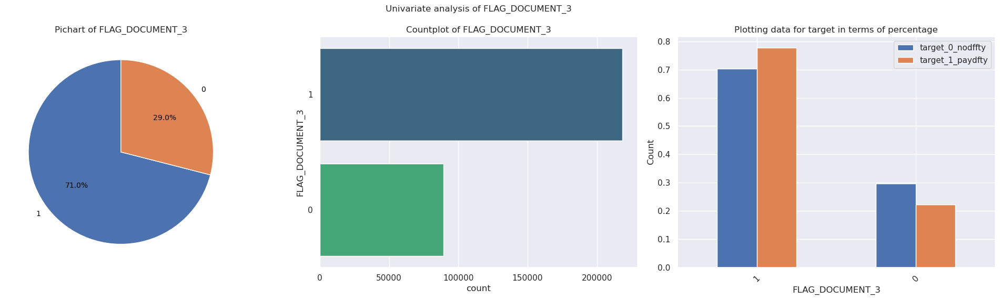

<Figure size 640x480 with 0 Axes>

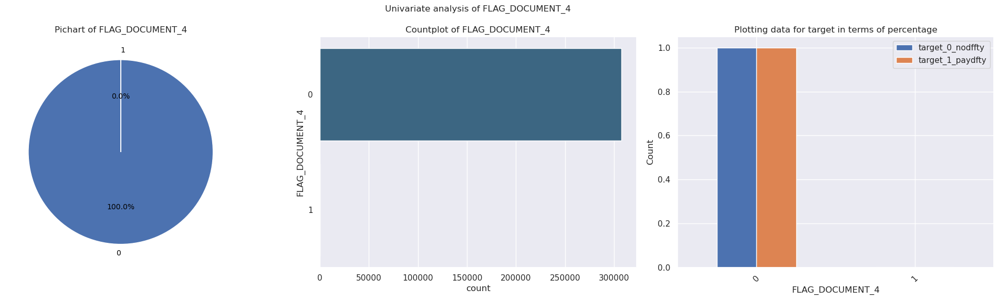

<Figure size 640x480 with 0 Axes>

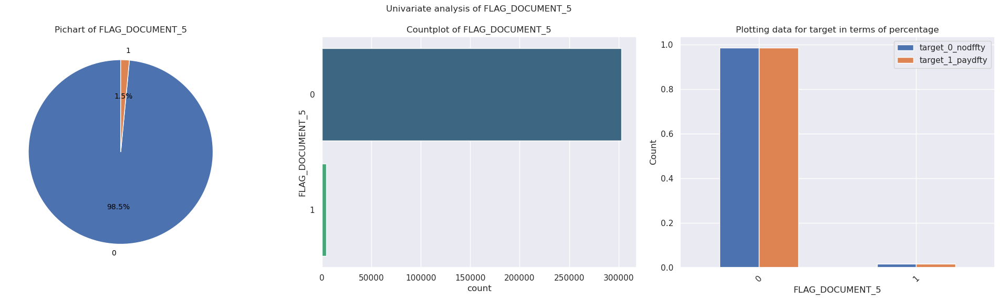

<Figure size 640x480 with 0 Axes>

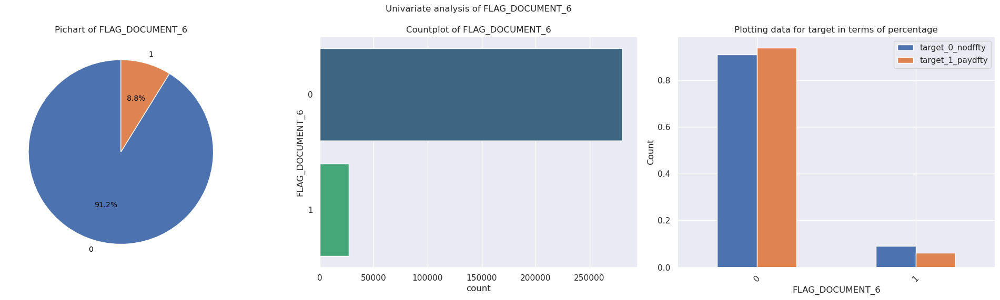

<Figure size 640x480 with 0 Axes>

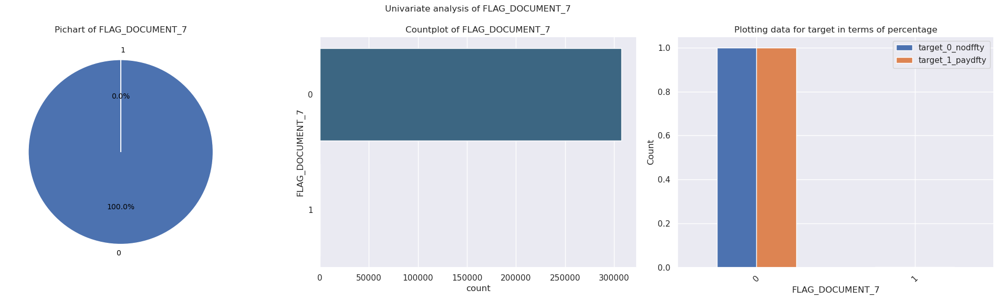

<Figure size 640x480 with 0 Axes>

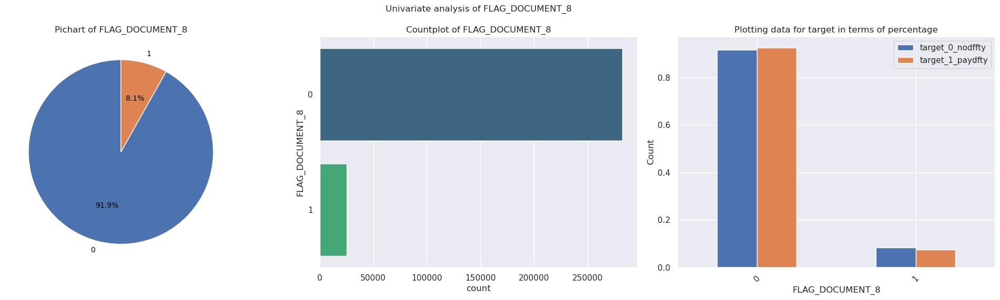

<Figure size 640x480 with 0 Axes>

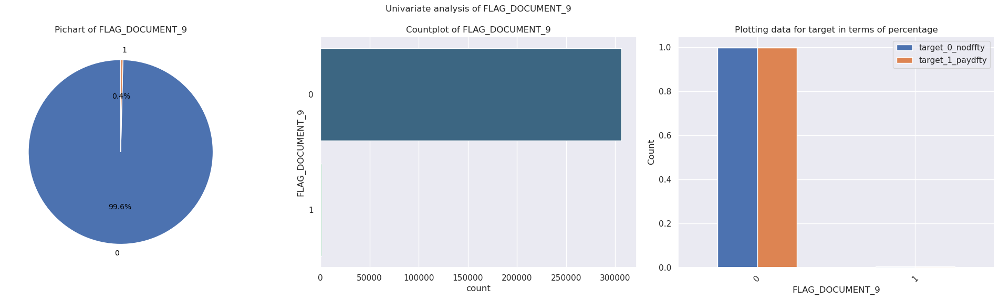

<Figure size 640x480 with 0 Axes>

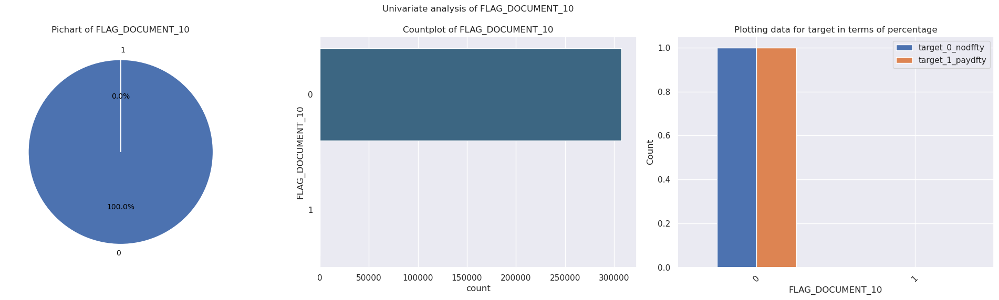

<Figure size 640x480 with 0 Axes>

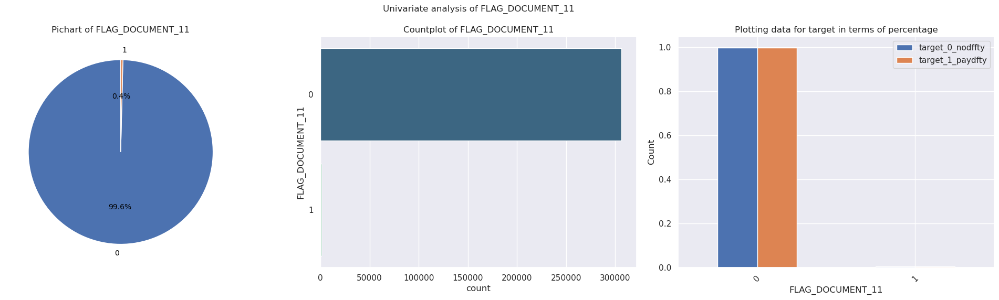

<Figure size 640x480 with 0 Axes>

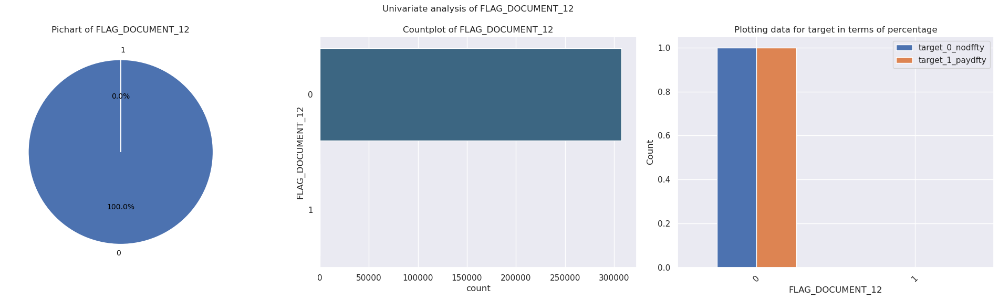

<Figure size 640x480 with 0 Axes>

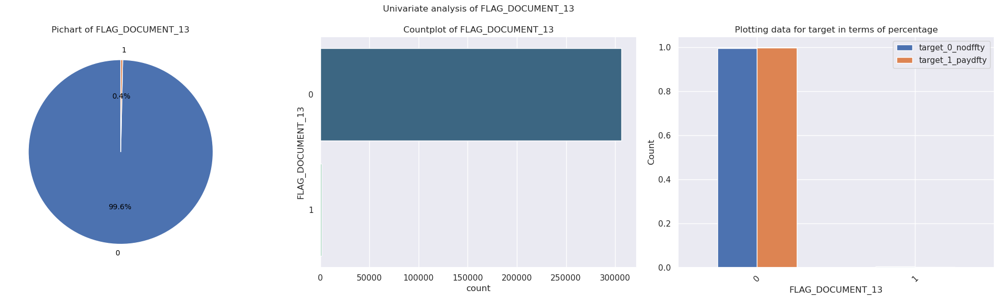

<Figure size 640x480 with 0 Axes>

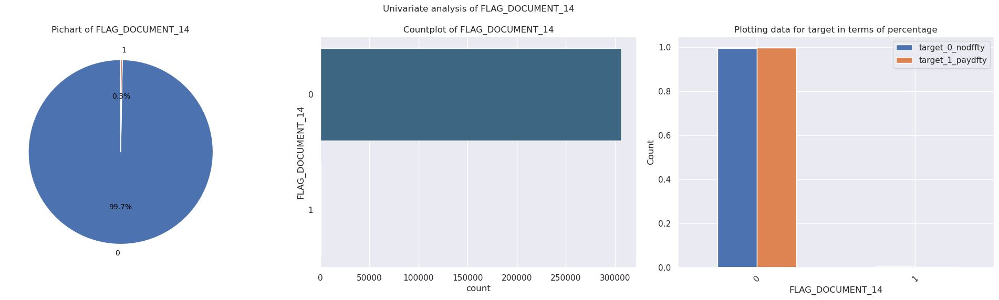

<Figure size 640x480 with 0 Axes>

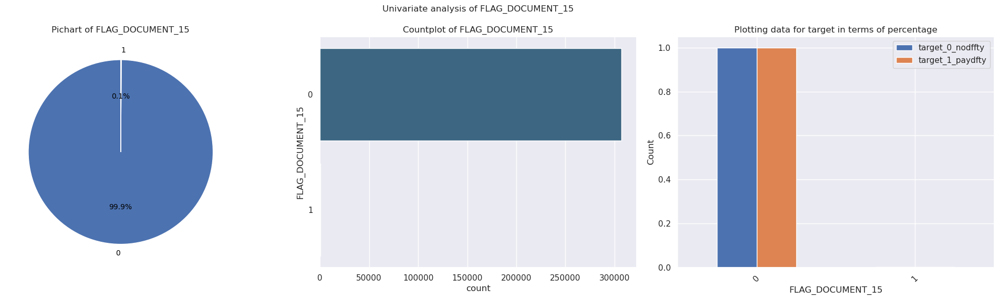

<Figure size 640x480 with 0 Axes>

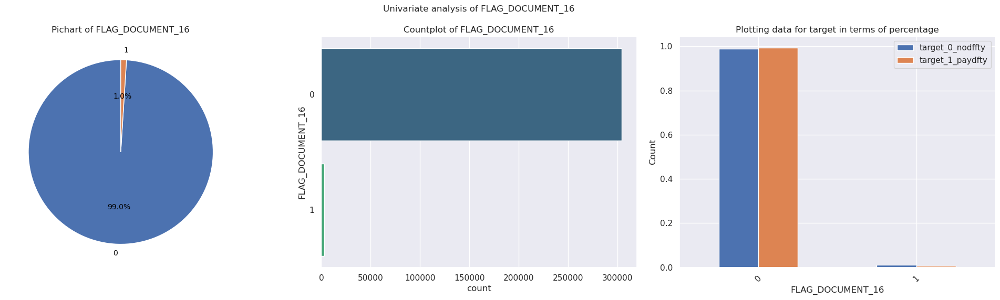

<Figure size 640x480 with 0 Axes>

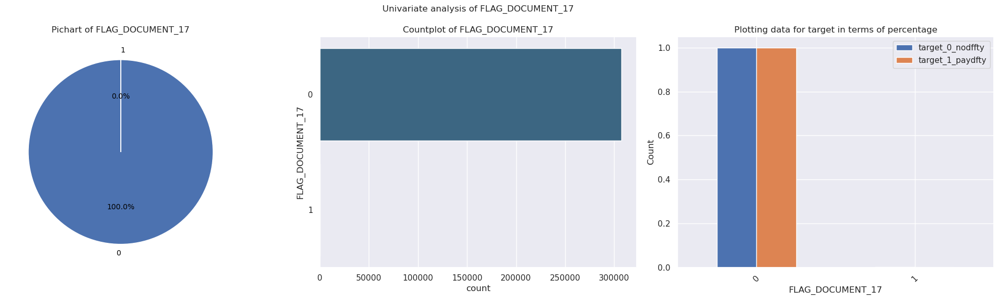

<Figure size 640x480 with 0 Axes>

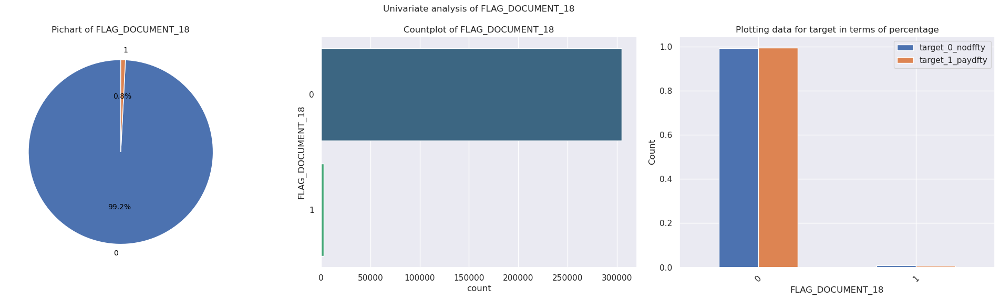

<Figure size 640x480 with 0 Axes>

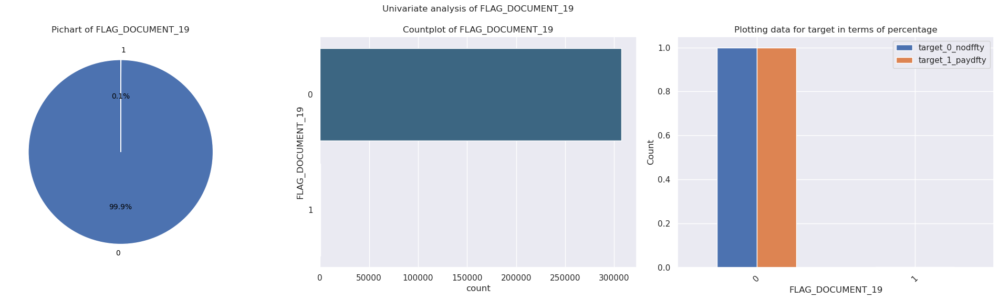

<Figure size 640x480 with 0 Axes>

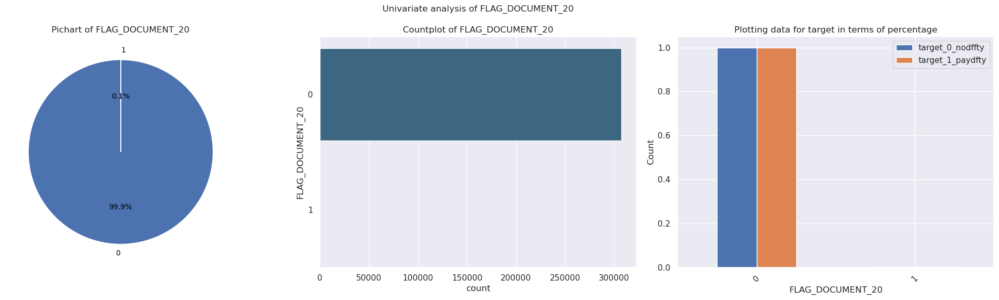

<Figure size 640x480 with 0 Axes>

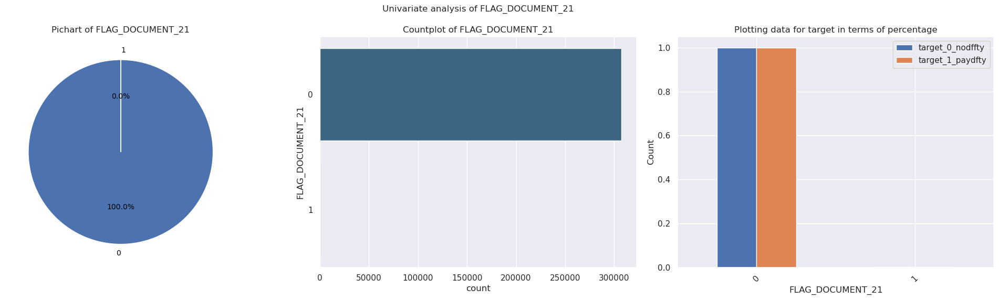

<Figure size 640x480 with 0 Axes>

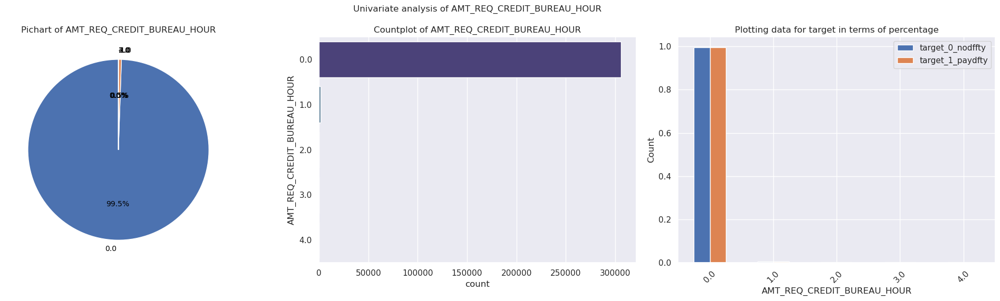

<Figure size 640x480 with 0 Axes>

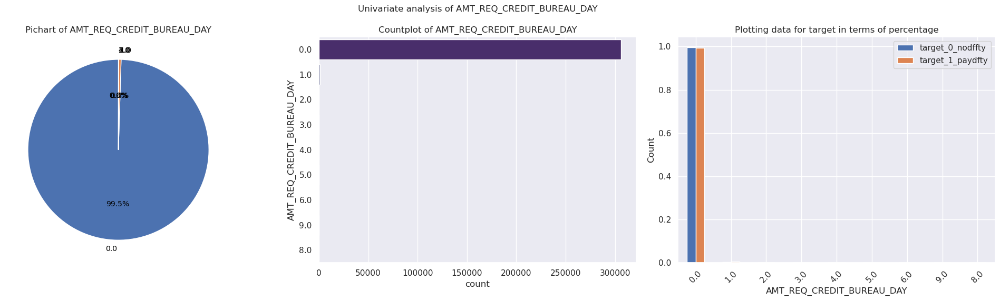

<Figure size 640x480 with 0 Axes>

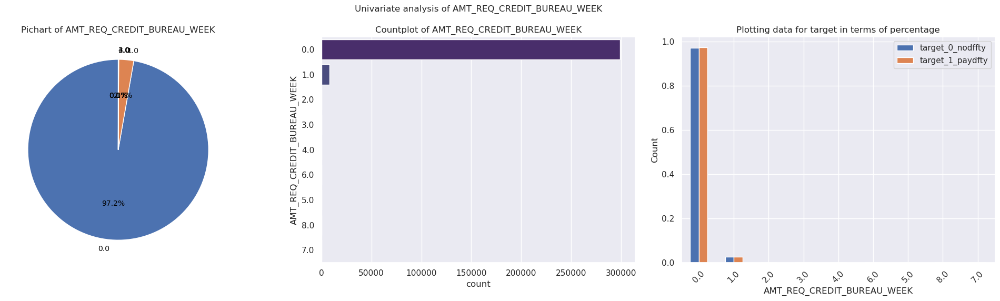

--------------------------------------------------------------------------


<Figure size 640x480 with 0 Axes>

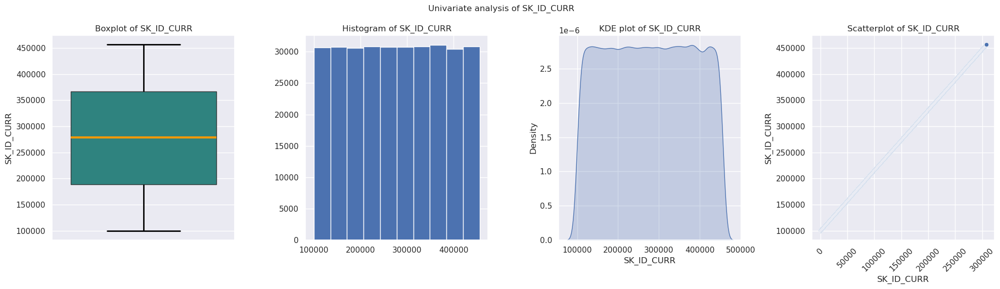

<Figure size 640x480 with 0 Axes>

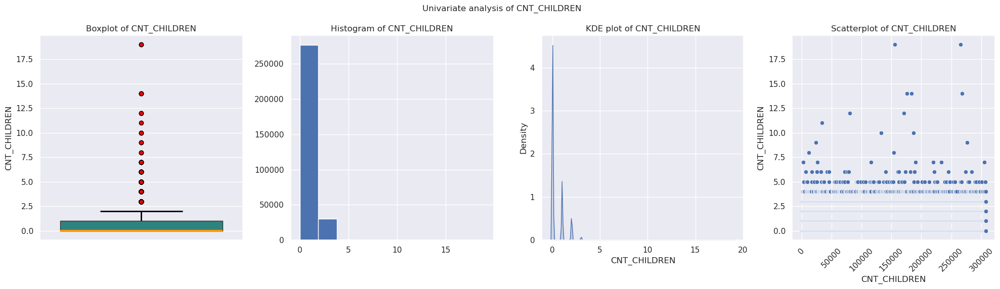

<Figure size 640x480 with 0 Axes>

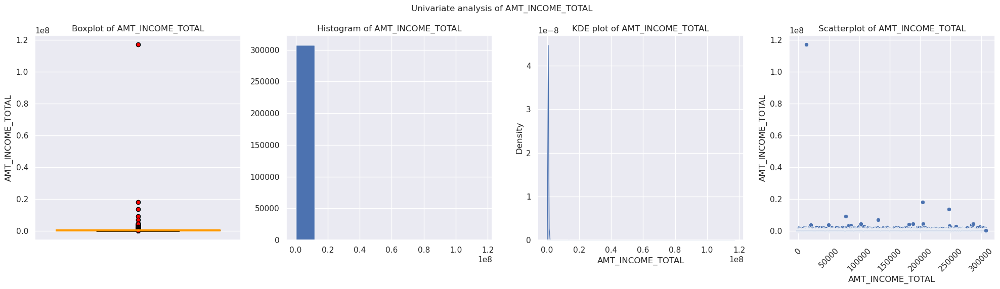

<Figure size 640x480 with 0 Axes>

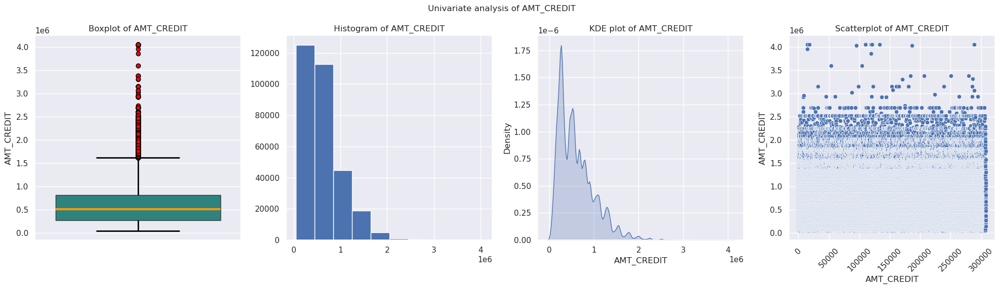

<Figure size 640x480 with 0 Axes>

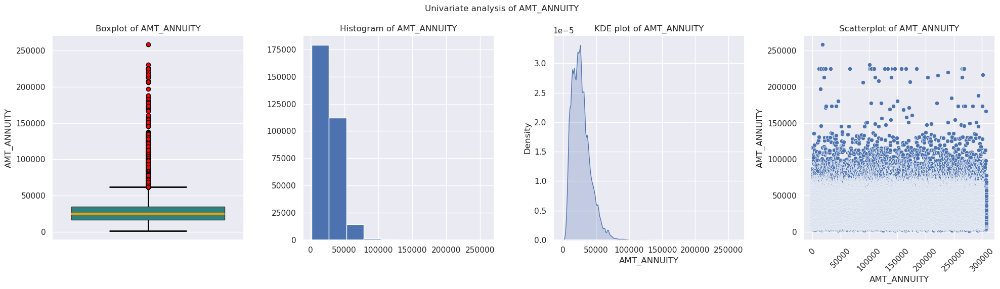

<Figure size 640x480 with 0 Axes>

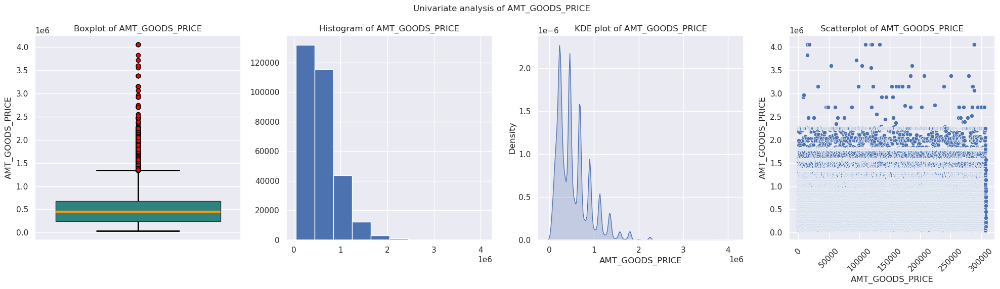

<Figure size 640x480 with 0 Axes>

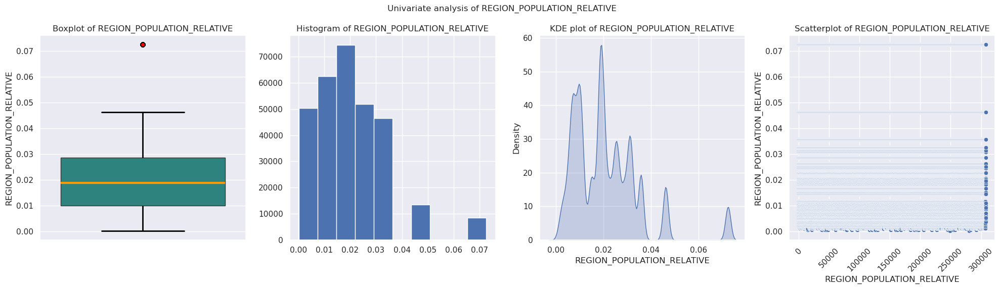

<Figure size 640x480 with 0 Axes>

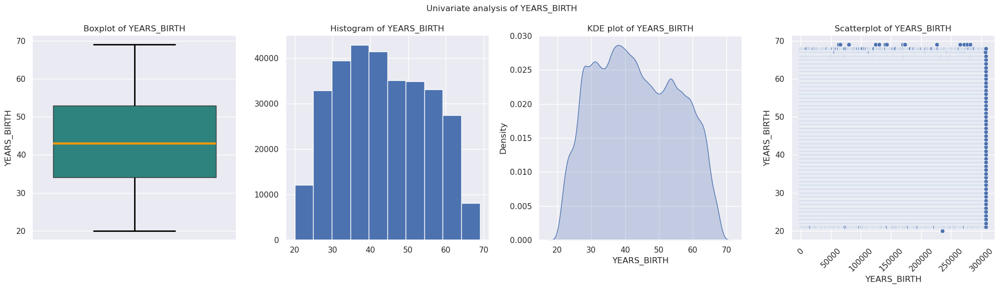

<Figure size 640x480 with 0 Axes>

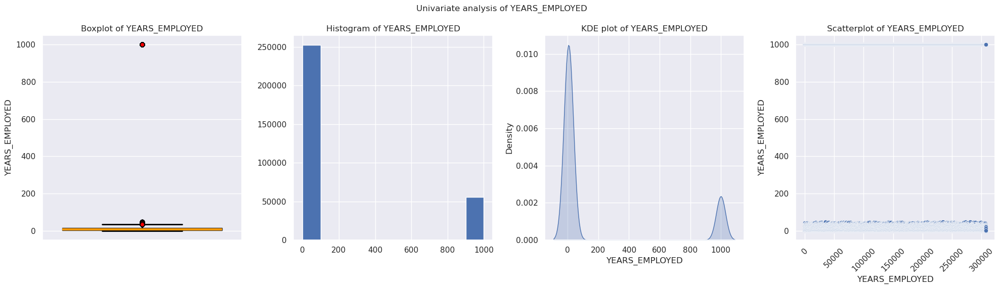

<Figure size 640x480 with 0 Axes>

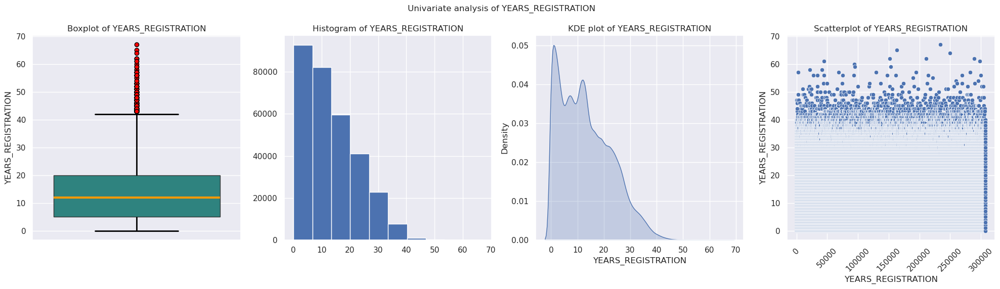

<Figure size 640x480 with 0 Axes>

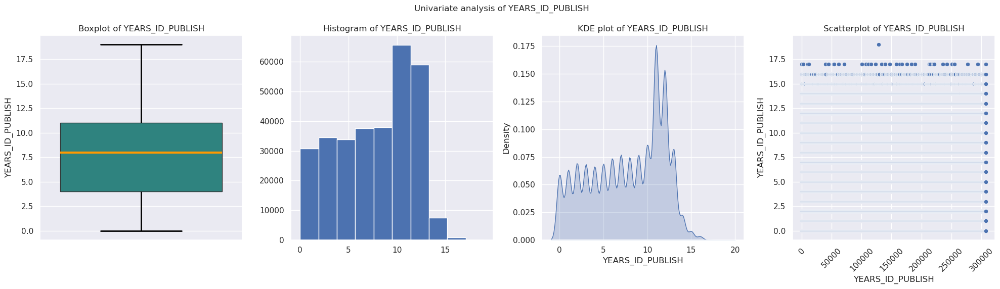

<Figure size 640x480 with 0 Axes>

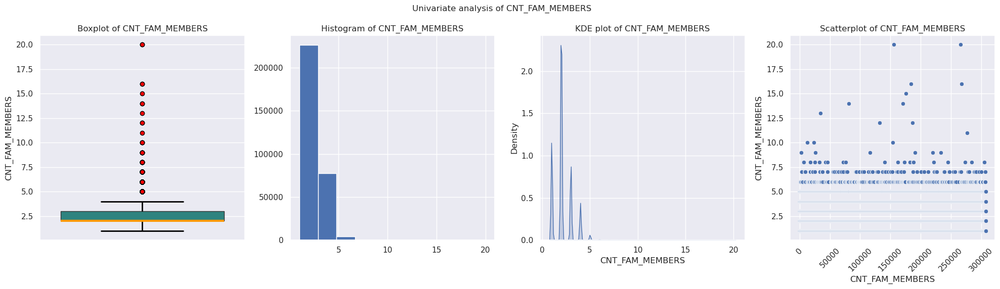

<Figure size 640x480 with 0 Axes>

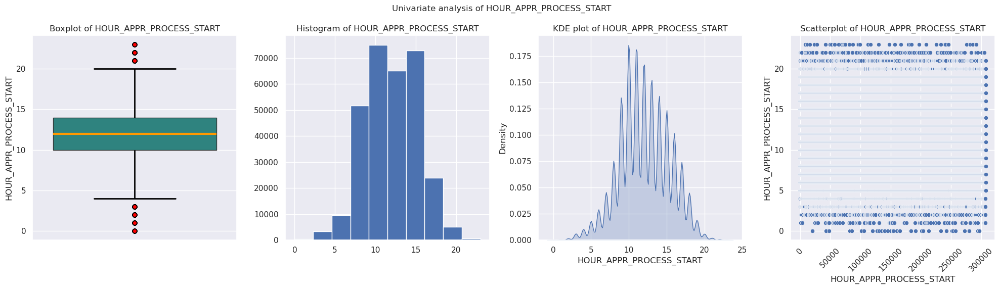

<Figure size 640x480 with 0 Axes>

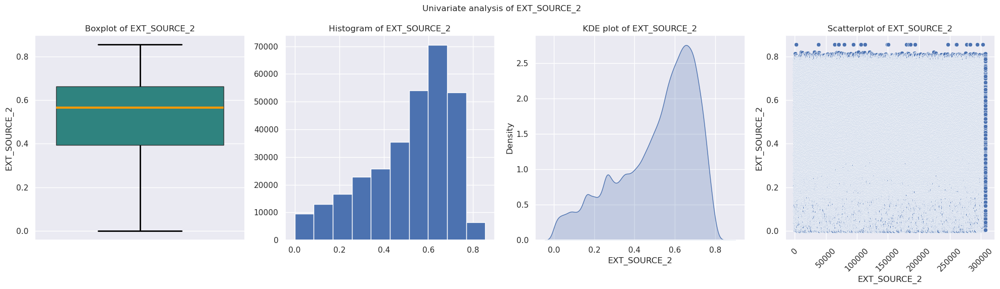

<Figure size 640x480 with 0 Axes>

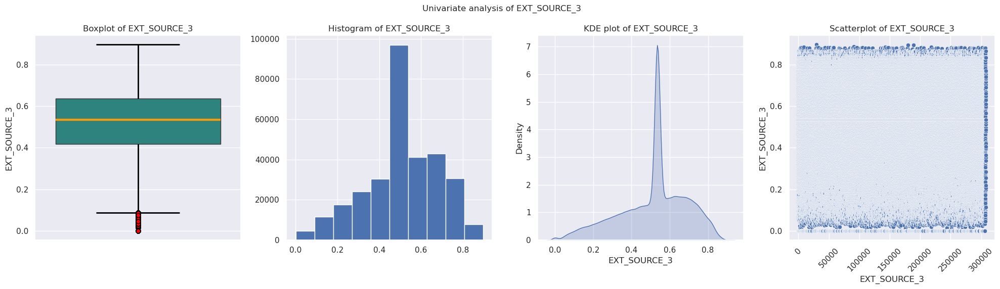

<Figure size 640x480 with 0 Axes>

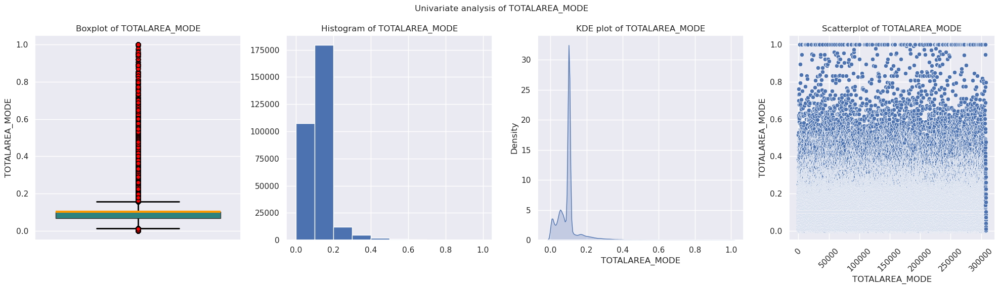

<Figure size 640x480 with 0 Axes>

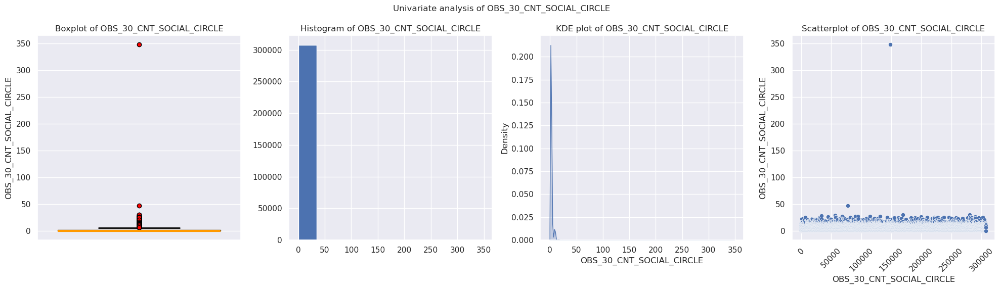

<Figure size 640x480 with 0 Axes>

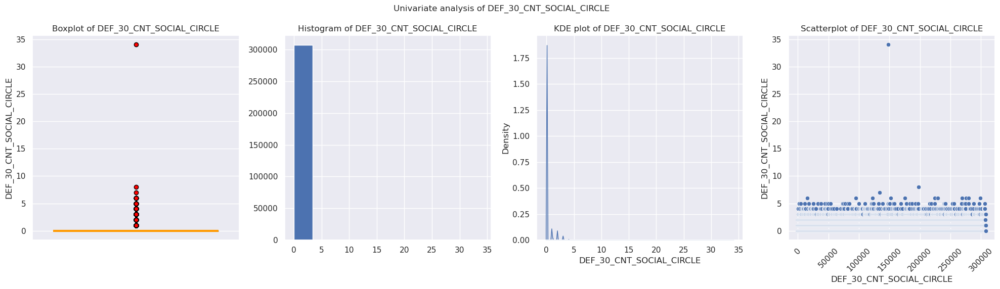

<Figure size 640x480 with 0 Axes>

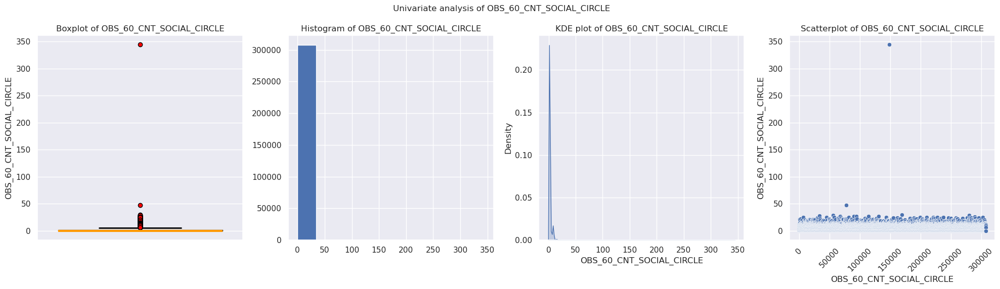

<Figure size 640x480 with 0 Axes>

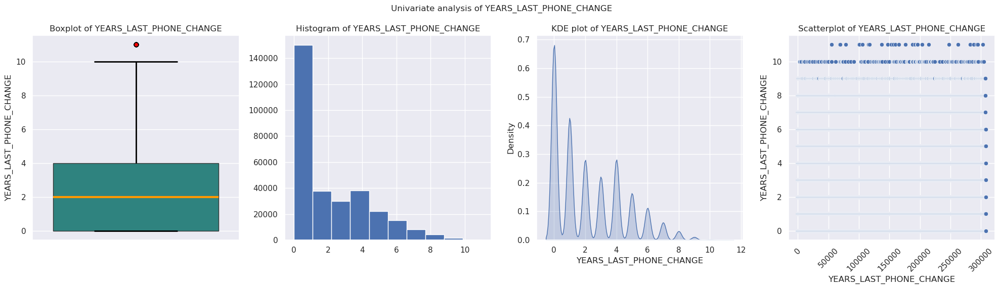

<Figure size 640x480 with 0 Axes>

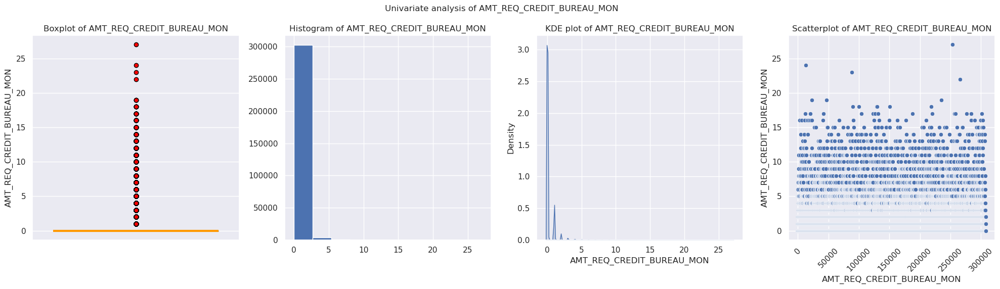

<Figure size 640x480 with 0 Axes>

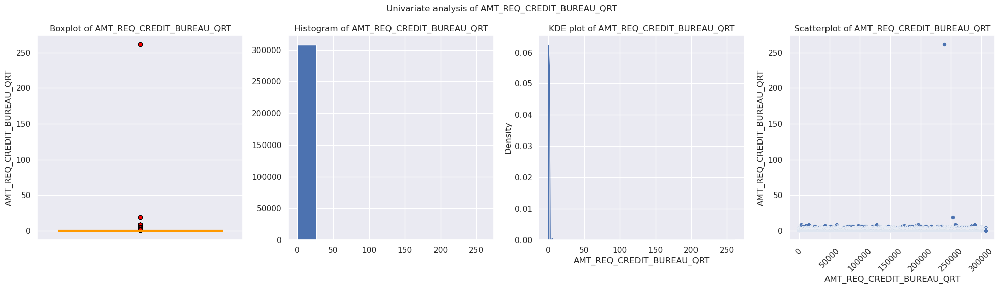

<Figure size 640x480 with 0 Axes>

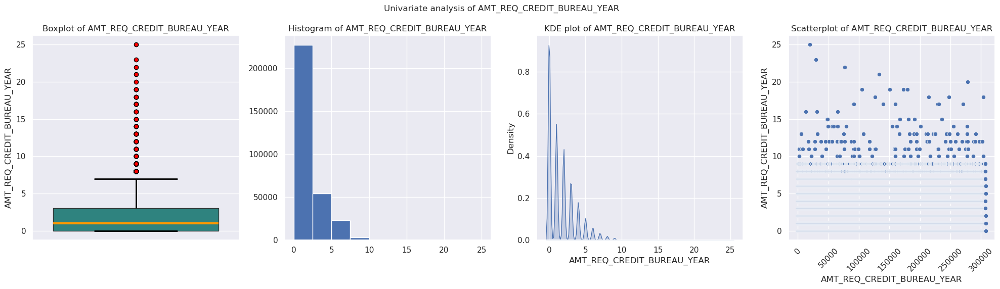

<Figure size 640x480 with 0 Axes>

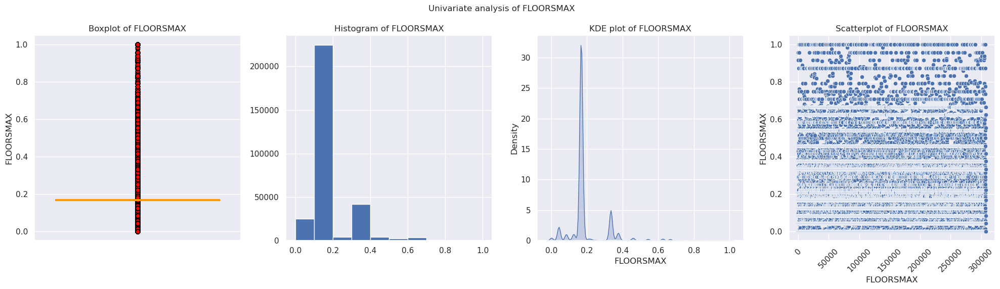

<Figure size 640x480 with 0 Axes>

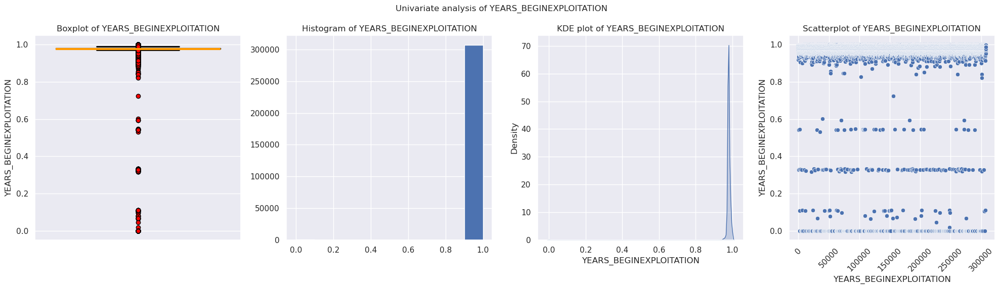

<Figure size 640x480 with 0 Axes>

In [18]:
curr_desc_cols = curr_appl_data1.describe().columns
dtype_dict = classify_feature_dtype(curr_appl_data1,curr_desc_cols)
curr_dtype_dict = dtype_dict['float_ts']

# univariate_plots(curr_appl_data1.head(60), curr_appl_data1.select_dtypes(object).columns, t0=curr_target_train_0, t1=curr_target_train_1, ftype="category")
# print("--------------------------------------------------------------------------")
# univariate_plots(curr_appl_data1.head(60), dtype_dict['int_cat'], t0=curr_target_train_0, t1=curr_target_train_1, ftype="category")
# print("--------------------------------------------------------------------------")
# univariate_plots(curr_appl_data1.head(60), dtype_dict['float_ts'], ftype="non_categorical")

univariate_plots(curr_appl_data1, curr_appl_data1.select_dtypes(object).columns, t0 = curr_target_train_0, t1 = curr_target_train_1, ftype = "category")
print("--------------------------------------------------------------------------")
univariate_plots(curr_appl_data1, dtype_dict['int_cat'], t0 = curr_target_train_0, t1 = curr_target_train_1, ftype = "category")
print("--------------------------------------------------------------------------")
univariate_plots(curr_appl_data1, dtype_dict['float_ts'], ftype = "non_categorical")

- Univariate and Outlier analysis:
- Important Observations

* Name_Contract Type: 
    - In the given dataset, Majority of the loans are cash based loans.
    - Clients find Cash based loans attractive.

* Code Gender:
    - Majority of the clients are Females,
    - Females interest towards loan application is higher compared to Males.
    - They are more responsible towards timely repayment of the installments

* Flag Own Car:
    - Majority of the applicants do not own car.

* Flag Own Realty:
    - Majority of the applicants own a property.

* Name_Income_Type:
    - Majority of the applicants are working citizens.


* Name_education_type:
    - Majority of the applicants requesting for loan have completed secondary education

* Name_Family_Status:
    * Most applicants requesting for loan are Married.
 
* Housing Type:
    * Majority of the applicants own a house

* Occupation Type:
    * Most applications are laborers.
    * The possibility of their loan getting rejected are very high.
 
* Target Feature
    * Majority of the applicants do not have any payment difficulties
 
* Flag_Mobile:
    * Almost everyone owns a mobile.

* Flag_columns:
    * Majority of the flag columns are mostly one category, therefore not much insights can be derived.

* CNT_children:
    * There are outliers in cnt_children feature.
    * Many applicants have either one or two childrens

* AMT_INcome:
    * There are outliers in the income feature.

* AMT_Credit:
    * There are outlier in the AMT_credit feature.
    * Binnig or capping needs to be done.

* AMT_Annuity:
    * Majority of the applicants have similar annuity
    * skewed distribution

* Years_Birth
    * Majority if the population is between 30 -40 age
 
* Years employed
    * There are outliers
 
* Years Registration:
    * Majority are applicants have recently changed their registrations.
 
* CNT_Family Members:
    * There are outliers
    * Most applicants have between 1 to 5 family members 

* Most clients applied for the loan between 10-13 hrs, which is predictable.

* Years employed:
    * Outliers are present

* Ext source 2:
    * Most clients have around 0.6 rating

* Ext source 3:
    * Most clients have around 0.5 rating

#### Data Cleaning - Previous Application Dataset

In [19]:
prev_appl_na_pct = check_cols_null_pct(prev_appl_data)
prev_appl_data1 = prev_appl_data.loc[:, (prev_appl_na_pct < 50)]
prev_appl_data1.columns

Index(['SK_ID_PREV', 'SK_ID_CURR', 'NAME_CONTRACT_TYPE', 'AMT_ANNUITY',
       'AMT_APPLICATION', 'AMT_CREDIT', 'AMT_GOODS_PRICE',
       'WEEKDAY_APPR_PROCESS_START', 'HOUR_APPR_PROCESS_START',
       'FLAG_LAST_APPL_PER_CONTRACT', 'NFLAG_LAST_APPL_IN_DAY',
       'NAME_CASH_LOAN_PURPOSE', 'NAME_CONTRACT_STATUS', 'DAYS_DECISION',
       'NAME_PAYMENT_TYPE', 'CODE_REJECT_REASON', 'NAME_TYPE_SUITE',
       'NAME_CLIENT_TYPE', 'NAME_GOODS_CATEGORY', 'NAME_PORTFOLIO',
       'NAME_PRODUCT_TYPE', 'CHANNEL_TYPE', 'SELLERPLACE_AREA',
       'NAME_SELLER_INDUSTRY', 'CNT_PAYMENT', 'NAME_YIELD_GROUP',
       'PRODUCT_COMBINATION', 'DAYS_FIRST_DRAWING', 'DAYS_FIRST_DUE',
       'DAYS_LAST_DUE_1ST_VERSION', 'DAYS_LAST_DUE', 'DAYS_TERMINATION',
       'NFLAG_INSURED_ON_APPROVAL'],
      dtype='object')

- Since there are many columns that have null values and are more than 50% it is generally not recommended to impute it, 
- Therefore we drop all columns gt 50%

In [20]:
show_stats(prev_appl_data1, prev_appl_data1.columns)
prev_appl_na_pct1 = check_cols_null_pct(prev_appl_data1)
prev_appl_na_pct1

Total Nulls: 0,
Mode: 1000001
Median   : 1923110.5, 
Variance: 283660585606.6597, 

Describe: count   1670214.000
mean    1923089.135
std      532597.959
min     1000001.000
25%     1461857.250
50%     1923110.500
75%     2384279.750
max     2845382.000
Name: SK_ID_PREV, dtype: float64 

ValueCounts: SK_ID_PREV
2030495   0.000
1035848   0.000
1526498   0.000
2148893   0.000
2437429   0.000
Name: proportion, dtype: float64 



------------------------------------------------------------------
Total Nulls: 0,
Mode: 187868
Median   : 278714.5, 
Variance: 10570888003.009909, 

Describe: count   1670214.000
mean     278357.174
std      102814.824
min      100001.000
25%      189329.000
50%      278714.500
75%      367514.000
max      456255.000
Name: SK_ID_CURR, dtype: float64 

ValueCounts: SK_ID_CURR
187868   0.005
265681   0.004
173680   0.004
242412   0.004
206783   0.004
Name: proportion, dtype: float64 



------------------------------------------------------------------
Total Nulls:

NAME_TYPE_SUITE               49.120
DAYS_FIRST_DRAWING            40.298
DAYS_TERMINATION              40.298
DAYS_LAST_DUE                 40.298
DAYS_LAST_DUE_1ST_VERSION     40.298
DAYS_FIRST_DUE                40.298
NFLAG_INSURED_ON_APPROVAL     40.298
AMT_GOODS_PRICE               23.082
AMT_ANNUITY                   22.287
CNT_PAYMENT                   22.286
PRODUCT_COMBINATION            0.021
AMT_CREDIT                     0.000
WEEKDAY_APPR_PROCESS_START     0.000
HOUR_APPR_PROCESS_START        0.000
NAME_CONTRACT_TYPE             0.000
AMT_APPLICATION                0.000
NAME_YIELD_GROUP               0.000
NAME_SELLER_INDUSTRY           0.000
SELLERPLACE_AREA               0.000
CHANNEL_TYPE                   0.000
NAME_PRODUCT_TYPE              0.000
NAME_PORTFOLIO                 0.000
NAME_GOODS_CATEGORY            0.000
NAME_CLIENT_TYPE               0.000
SK_ID_CURR                     0.000
CODE_REJECT_REASON             0.000
NAME_PAYMENT_TYPE              0.000
D

In [21]:
prev_appl_data1.select_dtypes(object)
prev_appl_data1.isna().sum()

,NAME_CONTRACT_TYPE,WEEKDAY_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,NAME_SELLER_INDUSTRY,NAME_YIELD_GROUP,PRODUCT_COMBINATION
0,Consumer loans,SATURDAY,Y,XAP,Approved,Cash through the bank,XAP,NaN,Repeater,Mobile,POS,XNA,Country-wide,Connectivity,middle,POS mobile with interest
1,Cash loans,THURSDAY,Y,XNA,Approved,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Contact center,XNA,low_action,Cash X-Sell: low
2,Cash loans,TUESDAY,Y,XNA,Approved,Cash through the bank,XAP,"Spouse, partner",Repeater,XNA,Cash,x-sell,Credit and cash offices,XNA,high,Cash X-Sell: high
3,Cash loans,MONDAY,Y,XNA,Approved,Cash through the bank,XAP,NaN,Repeater,XNA,Cash,x-sell,Credit and cash offices,XNA,middle,Cash X-Sell: middle
4,Cash loans,THURSDAY,Y,Repairs,Refused,Cash through the bank,HC,NaN,Repeater,XNA,Cash,walk-in,Credit and cash offices,XNA,high,Cash Street: high
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1670209,Consumer loans,WEDNESDAY,Y,XAP,Approved,Cash through the bank,XAP,NaN,Refreshed,Furniture,POS,XNA,Stone,Furniture,low_normal,POS industry with interest
1670210,Consumer loans,TUESDAY,Y,XAP,Approved,Cash through the bank,XAP,Unaccompanied,New,Furniture,POS,XNA,Stone,Furniture,middle,POS industry with interest
1670211,Consumer loans,MONDAY,Y,XAP,Approved,Cash through the bank,XAP,"Spouse, partner",Repeater,Consumer Electronics,POS,XNA,Country-wide,Consumer electronics,low_normal,POS household with interest
1670212,Cash loans,WEDNESDAY,Y,XNA,Approved,Cash through the bank,XAP,Family,Repeater,XNA,Cash,x-sell,AP+ (Cash loan),XNA,low_normal,Cash X-Sell: low


SK_ID_PREV                          0
SK_ID_CURR                          0
NAME_CONTRACT_TYPE                  0
AMT_ANNUITY                    372235
AMT_APPLICATION                     0
AMT_CREDIT                          1
AMT_GOODS_PRICE                385515
WEEKDAY_APPR_PROCESS_START          0
HOUR_APPR_PROCESS_START             0
FLAG_LAST_APPL_PER_CONTRACT         0
NFLAG_LAST_APPL_IN_DAY              0
NAME_CASH_LOAN_PURPOSE              0
NAME_CONTRACT_STATUS                0
DAYS_DECISION                       0
NAME_PAYMENT_TYPE                   0
CODE_REJECT_REASON                  0
NAME_TYPE_SUITE                820405
NAME_CLIENT_TYPE                    0
NAME_GOODS_CATEGORY                 0
NAME_PORTFOLIO                      0
NAME_PRODUCT_TYPE                   0
CHANNEL_TYPE                        0
SELLERPLACE_AREA                    0
NAME_SELLER_INDUSTRY                0
CNT_PAYMENT                    372230
NAME_YIELD_GROUP                    0
PRODUCT_COMB

In [22]:
prev_appl_data1["DAYS_LAST_DUE"] = prev_appl_data1["DAYS_LAST_DUE"].fillna(prev_appl_data1["DAYS_LAST_DUE"].median())
prev_appl_data1["DAYS_FIRST_DUE"] = prev_appl_data1["DAYS_FIRST_DUE"].fillna(prev_appl_data1["DAYS_FIRST_DUE"].median())
prev_appl_data1["DAYS_TERMINATION"] = prev_appl_data1["DAYS_TERMINATION"].fillna(prev_appl_data1["DAYS_TERMINATION"].median())
prev_appl_data1["DAYS_FIRST_DRAWING"] = prev_appl_data1["DAYS_FIRST_DRAWING"].fillna(prev_appl_data1["DAYS_FIRST_DRAWING"].median())
prev_appl_data1["DAYS_LAST_DUE_1ST_VERSION"] = prev_appl_data1["DAYS_LAST_DUE_1ST_VERSION"].fillna(prev_appl_data1["DAYS_LAST_DUE_1ST_VERSION"].median())

prev_appl_data1["NFLAG_INSURED_ON_APPROVAL"] = prev_appl_data1["NFLAG_INSURED_ON_APPROVAL"].fillna(prev_appl_data1["NFLAG_INSURED_ON_APPROVAL"].mode()[0])
prev_appl_data1["NAME_TYPE_SUITE"] = prev_appl_data1["NAME_TYPE_SUITE"].fillna(prev_appl_data1["NAME_TYPE_SUITE"].mode()[0])

- Impute all missing values with median of the columns
- Imputed categorical columns with the mode of that column.

In [23]:
DAYS_COLS = prev_appl_data1.filter(like="DAYS").columns
prev_appl_data1[DAYS_COLS] = (abs(prev_appl_data1[DAYS_COLS])).astype(int)

- DAYS_COLS - Is a list of days type columns, represented in days count, 
- There were inconsistencies, therefore made all values absolute

In [24]:
prev_appl_data1["AMT_ANNUITY"].describe()
prev_appl_data1["AMT_GOODS_PRICE"].describe()
show_stats(prev_appl_data1, ['AMT_ANNUITY','AMT_GOODS_PRICE'])

count   1297979.000
mean      15955.121
std       14782.137
min           0.000
25%        6321.780
50%       11250.000
75%       20658.420
max      418058.145
Name: AMT_ANNUITY, dtype: float64

count   1284699.000
mean     227847.279
std      315396.558
min           0.000
25%       50841.000
50%      112320.000
75%      234000.000
max     6905160.000
Name: AMT_GOODS_PRICE, dtype: float64

Total Nulls: 372235,
Mode: 2250.0
Median   : 11250.0, 
Variance: 218511584.1819954, 

Describe: count   1297979.000
mean      15955.121
std       14782.137
min           0.000
25%        6321.780
50%       11250.000
75%       20658.420
max      418058.145
Name: AMT_ANNUITY, dtype: float64 

ValueCounts: AMT_ANNUITY
2250.000    2.455
11250.000   1.077
6750.000    1.036
9000.000    0.963
22500.000   0.917
Name: proportion, dtype: float64 



------------------------------------------------------------------
Total Nulls: 385515,
Mode: 45000.0
Median   : 112320.0, 
Variance: 99474988758.27444, 

Describe: count   1284699.000
mean     227847.279
std      315396.558
min           0.000
25%       50841.000
50%      112320.000
75%      234000.000
max     6905160.000
Name: AMT_GOODS_PRICE, dtype: float64 

ValueCounts: AMT_GOODS_PRICE
45000.000    3.723
225000.000   3.390
135000.000   3.165
450000.000   3.030
90000.000    2.286
Name: proportion, dtype: float64 



------------------------------

- After looking at the stats of these columns, it is better to impute with median of these columns.

In [25]:
# prev_appl_data1 = prev_appl_data1[~prev_appl_data1["AMT_ANNUITY"].isna()]
# prev_appl_data1 = prev_appl_data1[~prev_appl_data1["AMT_GOODS_PRICE"].isna()]

prev_appl_data1["AMT_ANNUITY"] = prev_appl_data1["AMT_ANNUITY"].fillna(prev_appl_data1["AMT_ANNUITY"].median())
prev_appl_data1["AMT_GOODS_PRICE"] = prev_appl_data1["AMT_GOODS_PRICE"].fillna(prev_appl_data1["AMT_GOODS_PRICE"].median())

In [26]:
show_stats(prev_appl_data1, prev_appl_data1.select_dtypes(object).columns )

Total Nulls: 0,
Mode: Cash loans

Unique: ['Consumer loans' 'Cash loans' 'Revolving loans' 'XNA']

ValueCounts: NAME_CONTRACT_TYPE
Cash loans        44.758
Consumer loans    43.656
Revolving loans   11.565
XNA                0.021
Name: proportion, dtype: float64 



------------------------------------------------------------------
Total Nulls: 0,
Mode: TUESDAY

Unique: ['SATURDAY' 'THURSDAY' 'TUESDAY' 'MONDAY' 'FRIDAY' 'SUNDAY' 'WEDNESDAY']

ValueCounts: WEEKDAY_APPR_PROCESS_START
TUESDAY     15.275
WEDNESDAY   15.268
MONDAY      15.181
FRIDAY      15.091
THURSDAY    14.914
Name: proportion, dtype: float64 



------------------------------------------------------------------
Total Nulls: 0,
Mode: Y

Unique: ['Y' 'N']

ValueCounts: FLAG_LAST_APPL_PER_CONTRACT
Y   99.493
N    0.507
Name: proportion, dtype: float64 



------------------------------------------------------------------
Total Nulls: 0,
Mode: XAP

Unique: ['XAP' 'XNA' 'Repairs' 'Everyday expenses' 'Car repairs'
 'Building

#### Univariate and Outlier analysis - Prev Application

- As part of univariate analysis, we will generate plots and charts for all the columns depending on the data type. The inferences are explained below

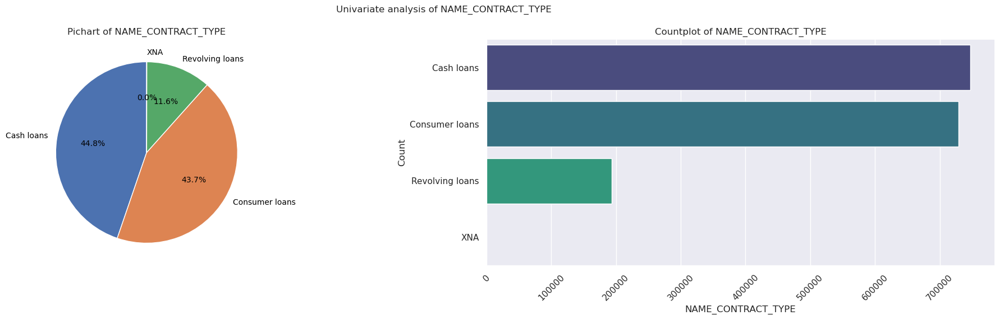

<Figure size 640x480 with 0 Axes>

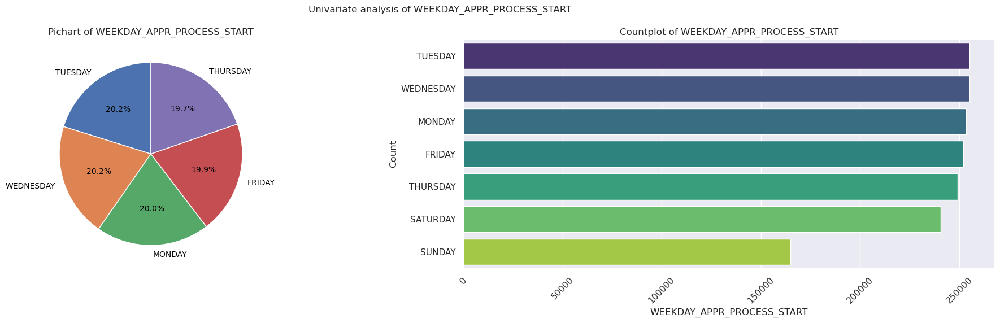

<Figure size 640x480 with 0 Axes>

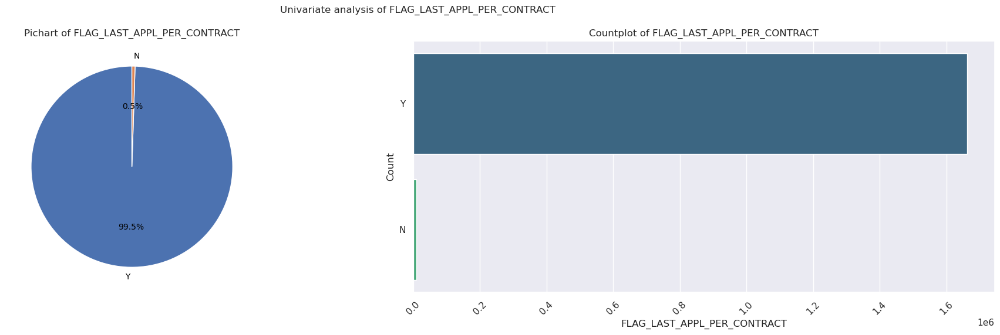

<Figure size 640x480 with 0 Axes>

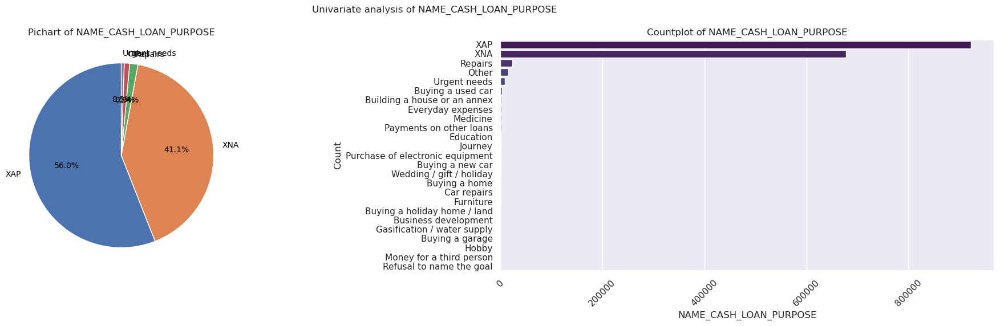

<Figure size 640x480 with 0 Axes>

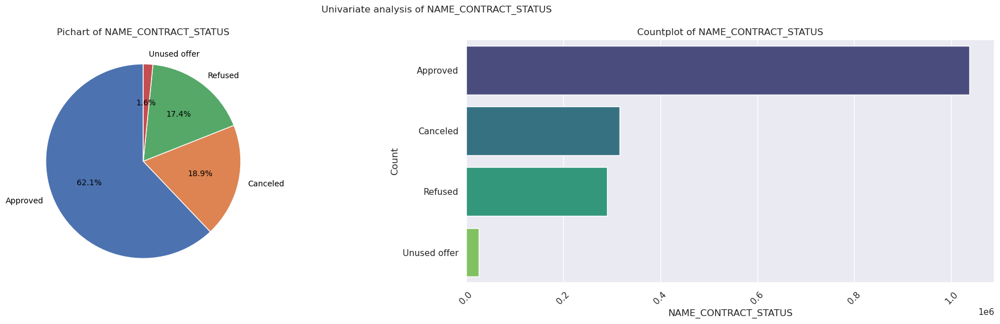

<Figure size 640x480 with 0 Axes>

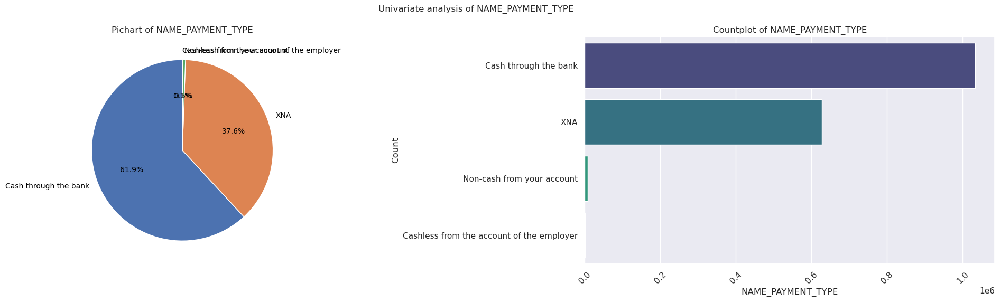

<Figure size 640x480 with 0 Axes>

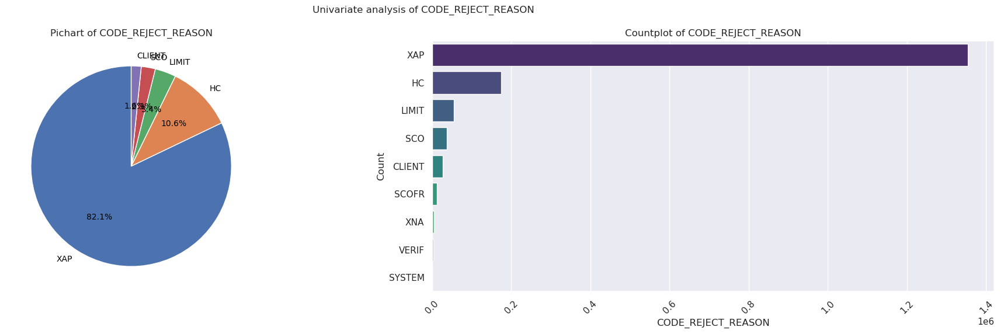

<Figure size 640x480 with 0 Axes>

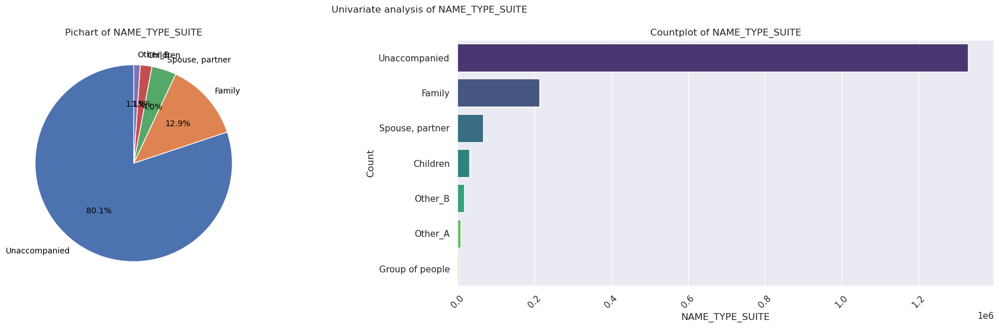

<Figure size 640x480 with 0 Axes>

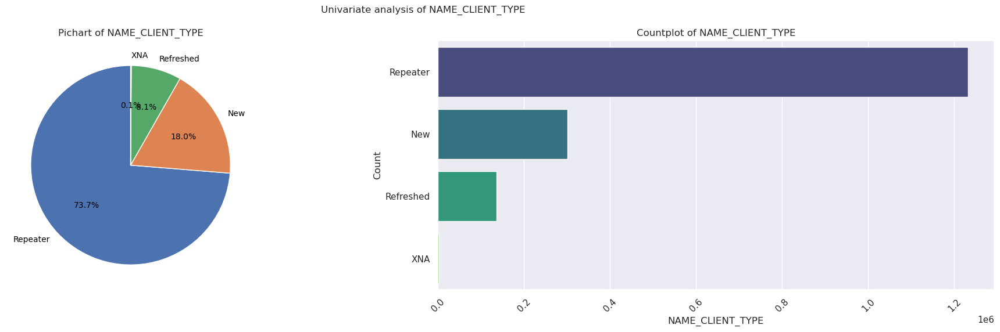

<Figure size 640x480 with 0 Axes>

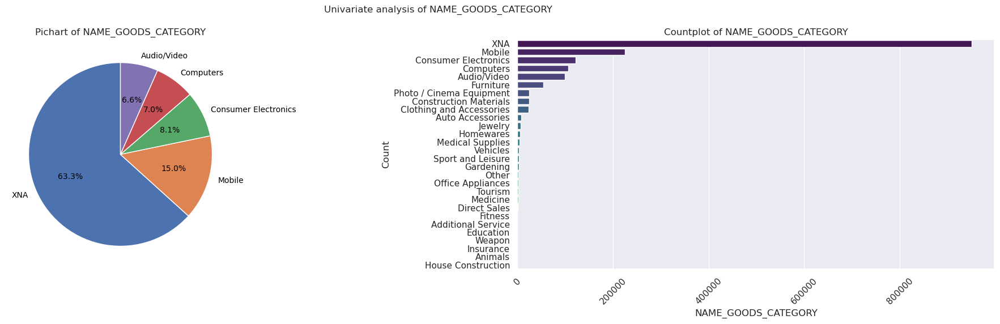

<Figure size 640x480 with 0 Axes>

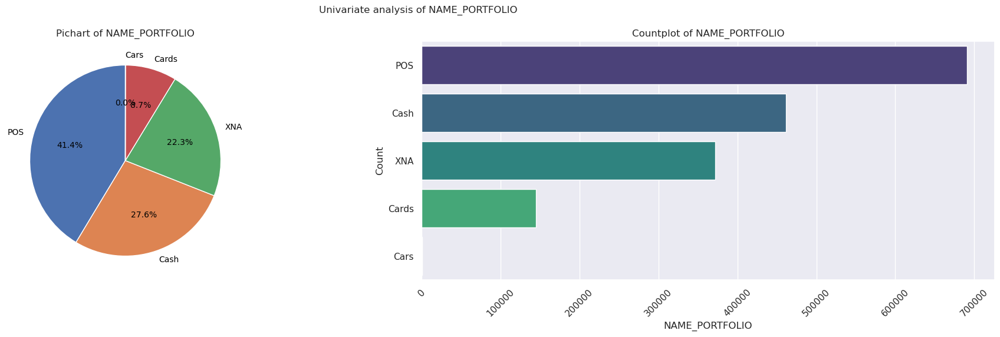

<Figure size 640x480 with 0 Axes>

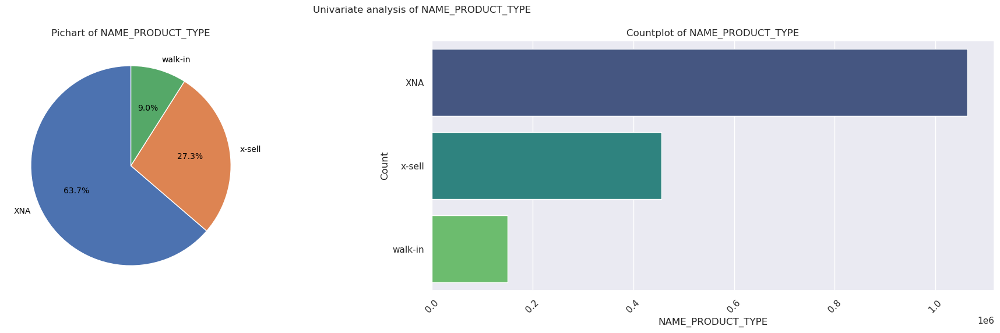

<Figure size 640x480 with 0 Axes>

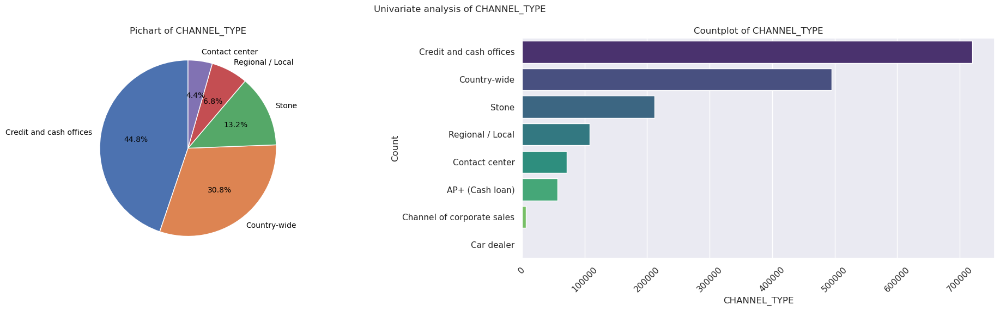

<Figure size 640x480 with 0 Axes>

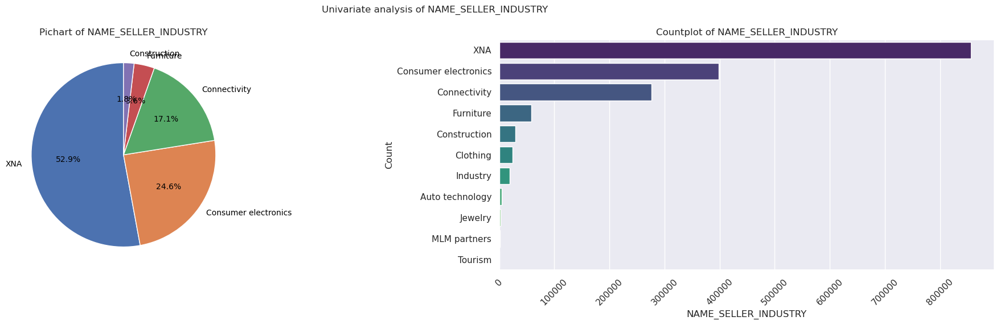

<Figure size 640x480 with 0 Axes>

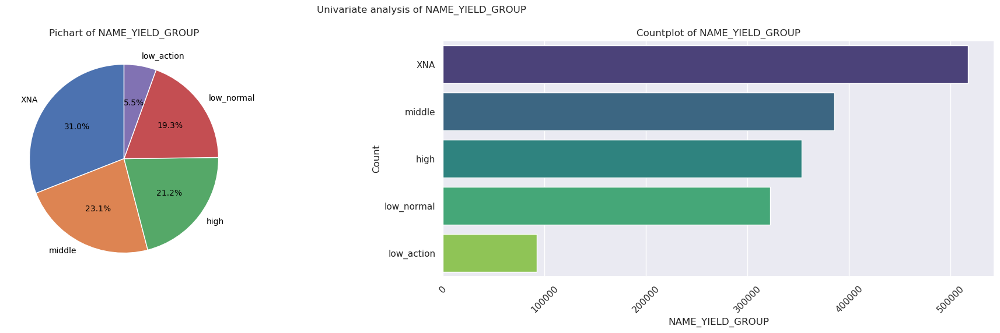

<Figure size 640x480 with 0 Axes>

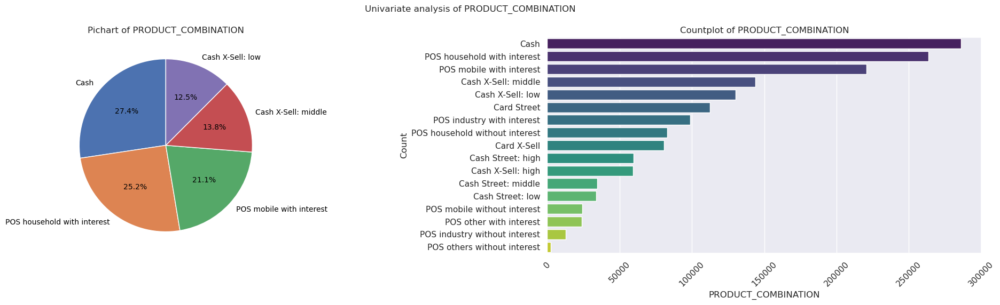

--------------------------------------------------------------------------


<Figure size 640x480 with 0 Axes>

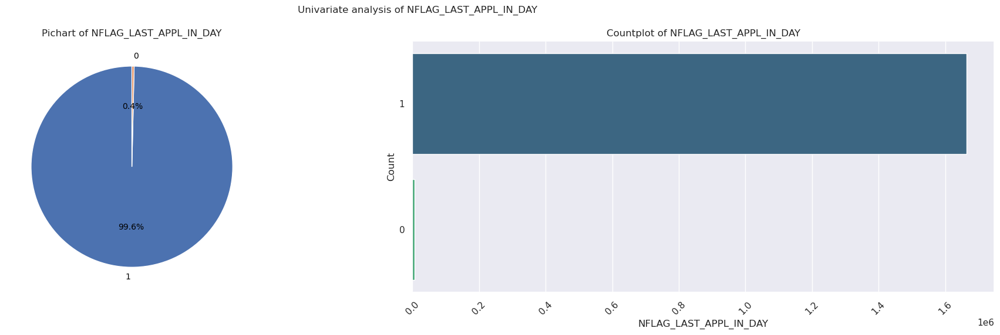

<Figure size 640x480 with 0 Axes>

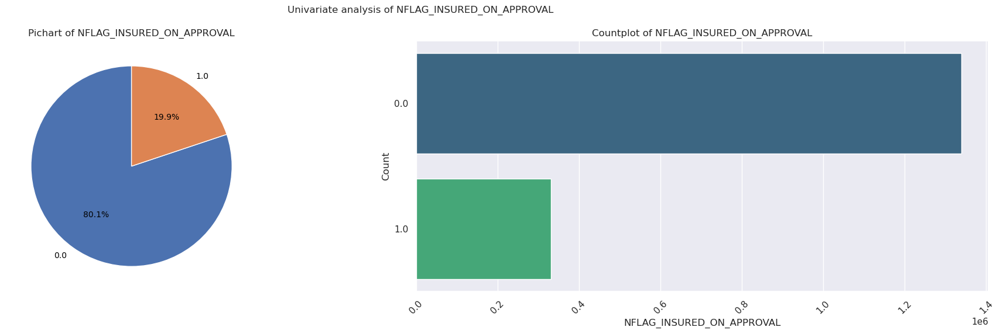

--------------------------------------------------------------------------


<Figure size 640x480 with 0 Axes>

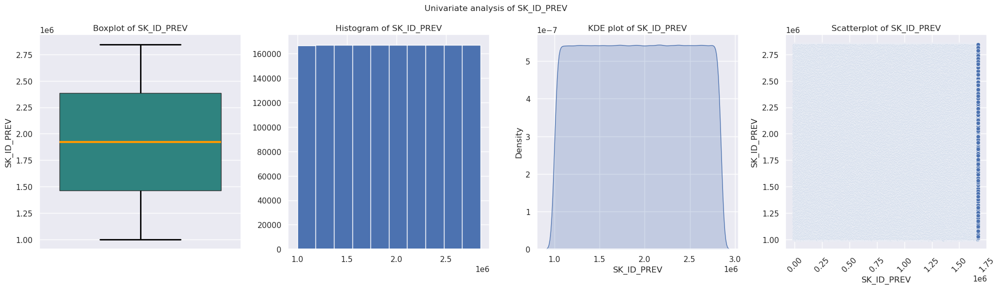

<Figure size 640x480 with 0 Axes>

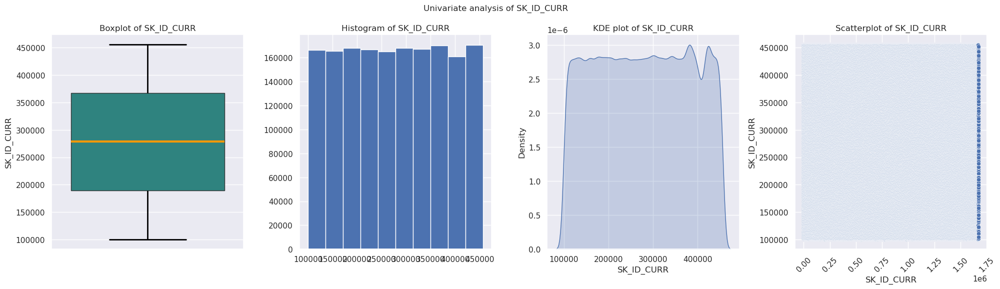

<Figure size 640x480 with 0 Axes>

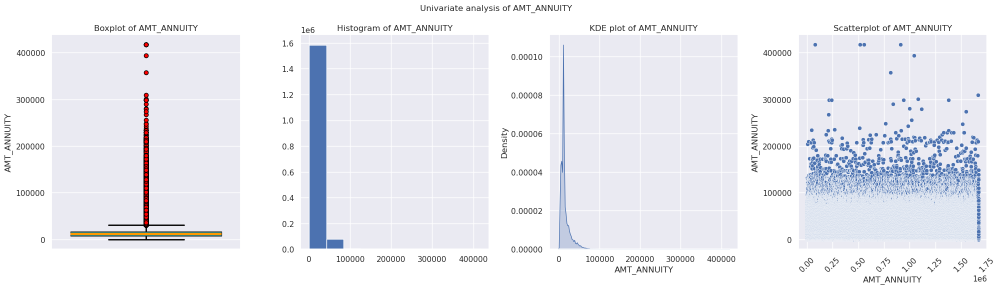

<Figure size 640x480 with 0 Axes>

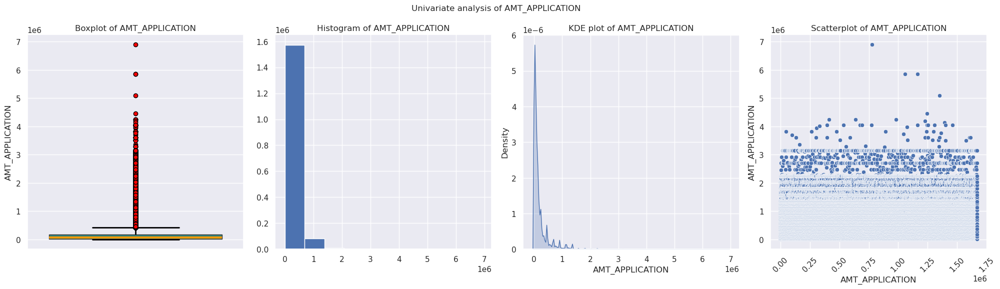

<Figure size 640x480 with 0 Axes>

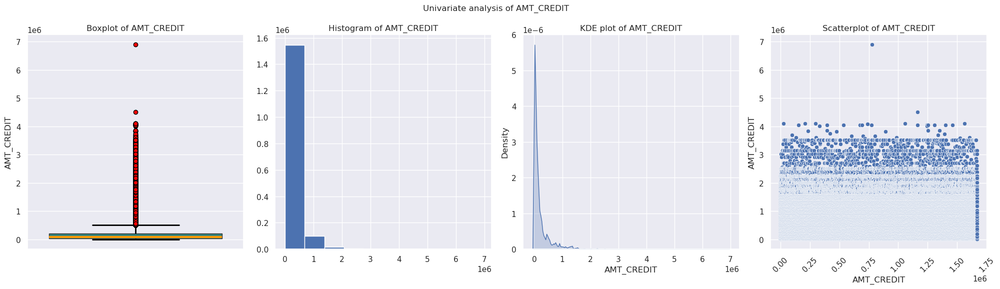

<Figure size 640x480 with 0 Axes>

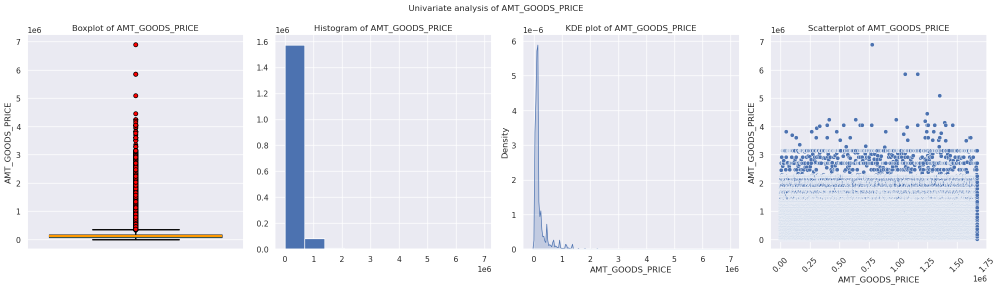

<Figure size 640x480 with 0 Axes>

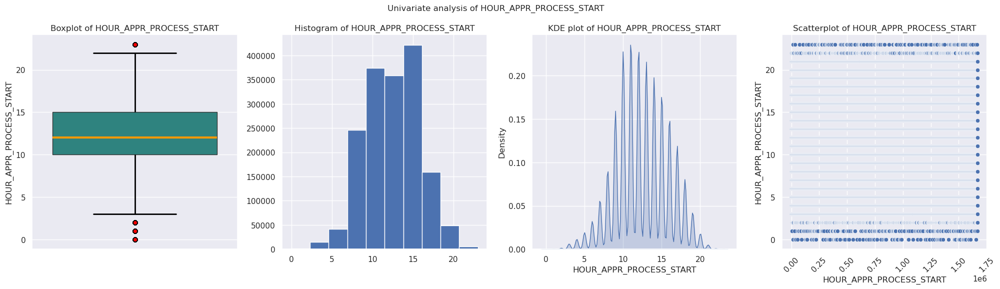

<Figure size 640x480 with 0 Axes>

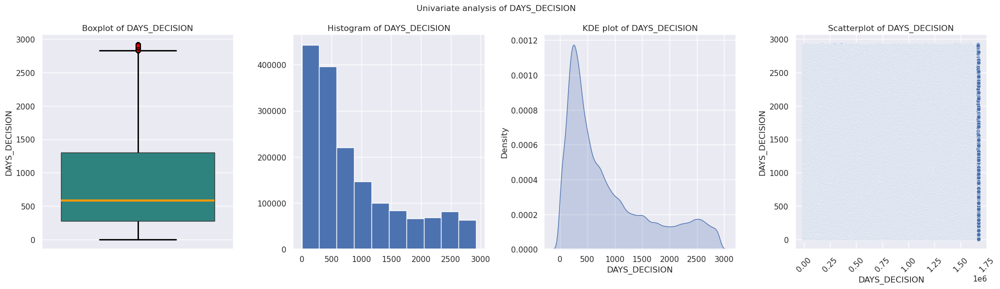

<Figure size 640x480 with 0 Axes>

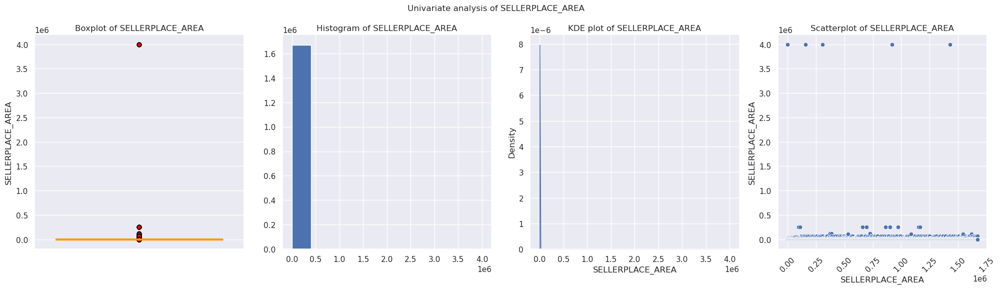

<Figure size 640x480 with 0 Axes>

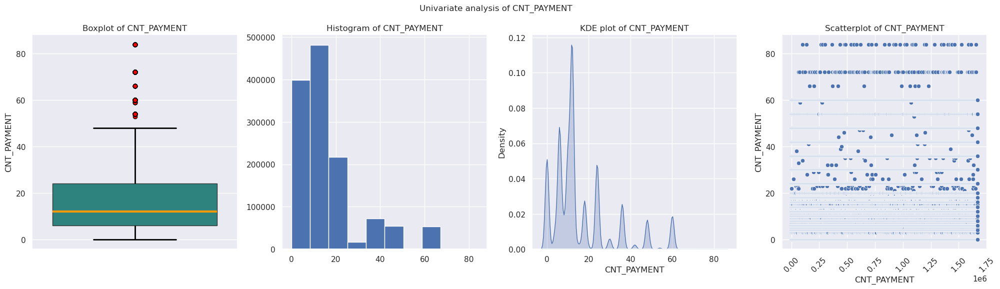

<Figure size 640x480 with 0 Axes>

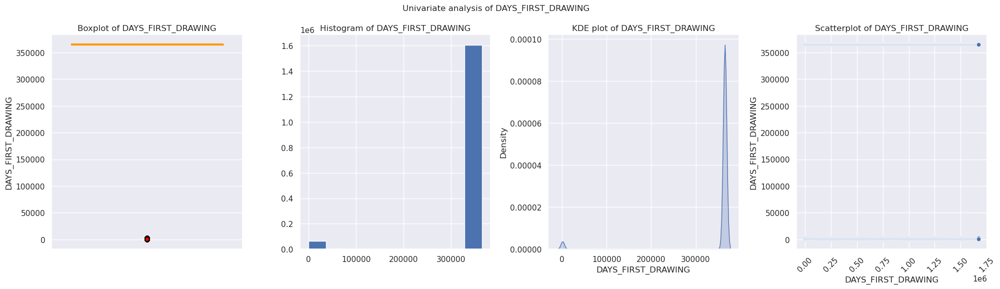

<Figure size 640x480 with 0 Axes>

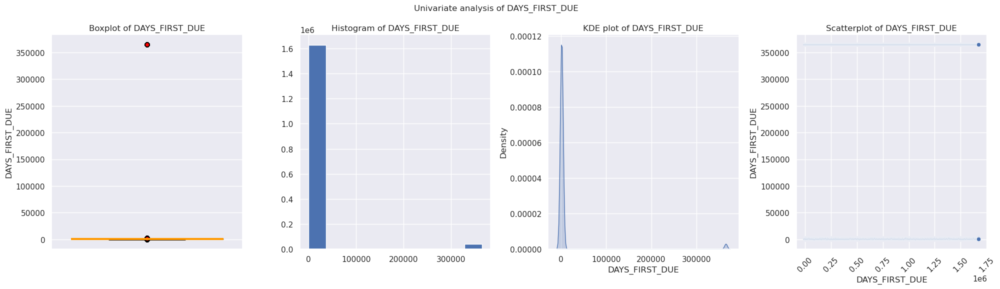

<Figure size 640x480 with 0 Axes>

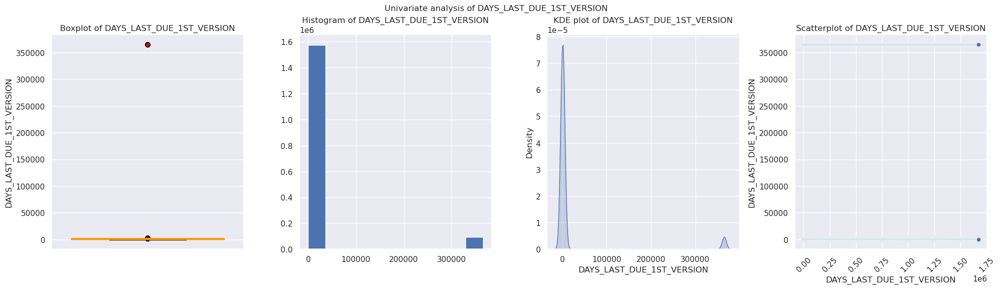

<Figure size 640x480 with 0 Axes>

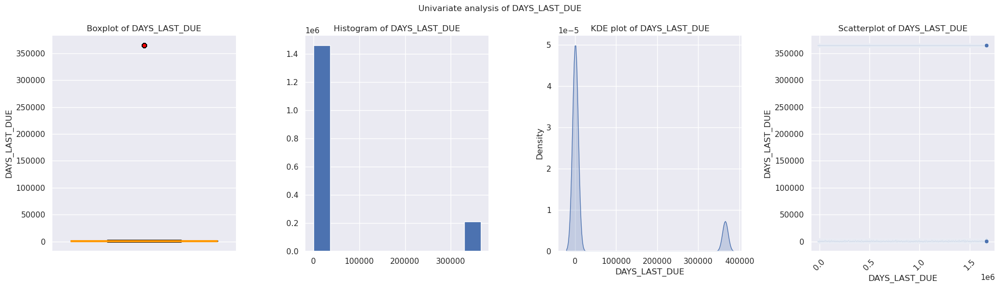

<Figure size 640x480 with 0 Axes>

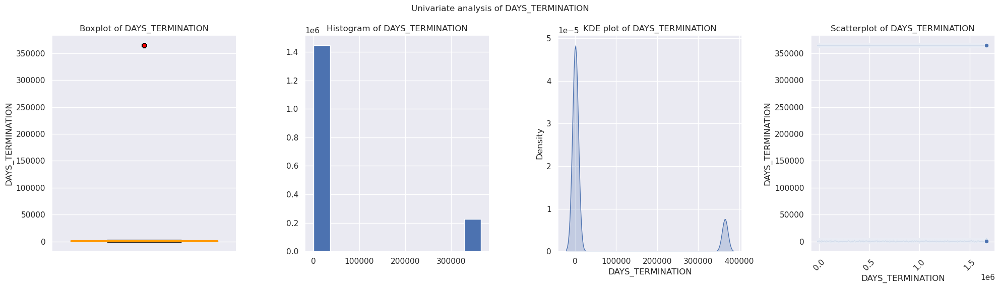

<Figure size 640x480 with 0 Axes>

In [27]:
prev_desc_cols = prev_appl_data1.describe().columns
prev_dtype_dict = dtype_dict = classify_feature_dtype(prev_appl_data1,prev_desc_cols)
prev_dtype_dict = dtype_dict['float_ts']

# univariate_plots(prev_appl_data1.head(60), prev_appl_data1.select_dtypes(object).columns, ftype="category")
# print("--------------------------------------------------------------------------")
# univariate_plots(prev_appl_data1.head(60), dtype_dict['int_cat'], ftype="category")
# print("--------------------------------------------------------------------------")
# univariate_plots(prev_appl_data1.head(60), dtype_dict['float_ts'], ftype="non_categorical")

univariate_plots(prev_appl_data1, prev_appl_data1.select_dtypes(object).columns, ftype="category")
print("--------------------------------------------------------------------------")
univariate_plots(prev_appl_data1, dtype_dict['int_cat'], ftype="category")
print("--------------------------------------------------------------------------")
univariate_plots(prev_appl_data1, dtype_dict['float_ts'], ftype="non_categorical")

- NAME_CONTRACT_TYPE - for prev applications majority are split between casloans and consumer loans

- WEEKDAY_APPR_PROCESS_START - looks like applications are processed on Sundays , which looks like a outlier
 
- CASH Loan purpose
    - Majority provided a reason as XAP,
    - the second highest is XNA, therefore this needs to be captured correctly for better insights

- NAME_CONTRACT_STATUS
    - Majority of the Applications were approved

- CODE_REJECT_RREASON
    - Again the code reject reason is not properly catured,
    - this is having greater impacts on our analysis

- Name client type
    - MAjority of the clients have reapplied for loan, which is good sign for credit agencies

- Name Good Category
    - Majority provided a reason as XNA,

- Name Product Type
    - Majority provided a reason as XNA,

- Name Seller Industry
    - Majority provided a reason as XNA,

- Name YIELD Group
    - Majority provided a reason as XNA,

- AMT_ANNUITY , AMT_APPLICATION, AMT_Credit, CNT_PAYMENT, DAYS _Termination, DAYS_LAST_DUE
    - There are outliers

In [28]:
show_stats(prev_appl_data1, prev_appl_data1.columns)
check_cols_null_pct(prev_appl_data1)

Total Nulls: 0,
Mode: 1000001
Median   : 1923110.5, 
Variance: 283660585606.6597, 

Describe: count   1670214.000
mean    1923089.135
std      532597.959
min     1000001.000
25%     1461857.250
50%     1923110.500
75%     2384279.750
max     2845382.000
Name: SK_ID_PREV, dtype: float64 

ValueCounts: SK_ID_PREV
2030495   0.000
1035848   0.000
1526498   0.000
2148893   0.000
2437429   0.000
Name: proportion, dtype: float64 



------------------------------------------------------------------
Total Nulls: 0,
Mode: 187868
Median   : 278714.5, 
Variance: 10570888003.009909, 

Describe: count   1670214.000
mean     278357.174
std      102814.824
min      100001.000
25%      189329.000
50%      278714.500
75%      367514.000
max      456255.000
Name: SK_ID_CURR, dtype: float64 

ValueCounts: SK_ID_CURR
187868   0.005
265681   0.004
173680   0.004
242412   0.004
206783   0.004
Name: proportion, dtype: float64 



------------------------------------------------------------------
Total Nulls:

CNT_PAYMENT                   22.286
PRODUCT_COMBINATION            0.021
AMT_CREDIT                     0.000
NAME_YIELD_GROUP               0.000
NAME_PORTFOLIO                 0.000
NAME_PRODUCT_TYPE              0.000
CHANNEL_TYPE                   0.000
SELLERPLACE_AREA               0.000
NAME_SELLER_INDUSTRY           0.000
SK_ID_PREV                     0.000
NAME_CLIENT_TYPE               0.000
DAYS_FIRST_DRAWING             0.000
DAYS_FIRST_DUE                 0.000
DAYS_LAST_DUE_1ST_VERSION      0.000
DAYS_LAST_DUE                  0.000
DAYS_TERMINATION               0.000
NAME_GOODS_CATEGORY            0.000
NAME_TYPE_SUITE                0.000
SK_ID_CURR                     0.000
CODE_REJECT_REASON             0.000
NAME_PAYMENT_TYPE              0.000
DAYS_DECISION                  0.000
NAME_CONTRACT_STATUS           0.000
NAME_CASH_LOAN_PURPOSE         0.000
NFLAG_LAST_APPL_IN_DAY         0.000
FLAG_LAST_APPL_PER_CONTRACT    0.000
HOUR_APPR_PROCESS_START        0.000
W

In [29]:
prev_appl_data1['CNT_PAYMENT']= prev_appl_data1['CNT_PAYMENT'].fillna(prev_appl_data1['CNT_PAYMENT'].mode()[0])
prev_appl_data1['PRODUCT_COMBINATION'] = prev_appl_data1['PRODUCT_COMBINATION'].fillna(prev_appl_data1['PRODUCT_COMBINATION'].mode()[0])

#### Data Imbalance

11.387150050352467

<Axes: xlabel='TARGET'>

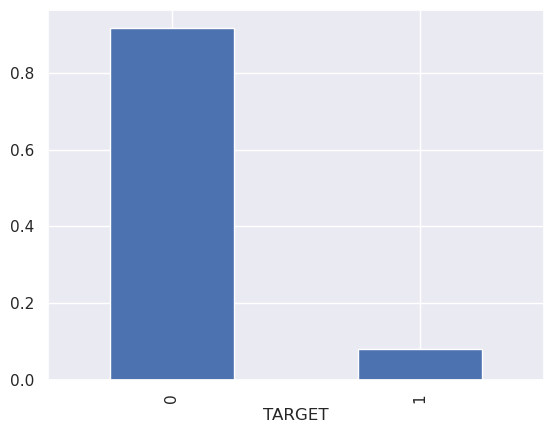

In [30]:
# curr_appl_data1['TARGET'].head(10)
target_ratio_one = (curr_appl_data1['TARGET'] == 1).sum()
target_ratio_zero = (curr_appl_data1['TARGET'] == 0).sum()
target_ratio = target_ratio_zero/target_ratio_one
target_ratio

curr_appl_data1['TARGET'].value_counts(normalize=True).plot.bar()

#### Merged/Combined Data Analysis

In [31]:
combined_appl_data = pd.merge(left=curr_appl_data1, right=prev_appl_data1, on="SK_ID_CURR", how='inner', suffixes=[None,'_right'])
combined_appl_data.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,YEARS_BIRTH,YEARS_EMPLOYED,YEARS_REGISTRATION,YEARS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,TOTALAREA_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,YEARS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,FLOORSMAX,YEARS_BEGINEXPLOITATION,AMT_CREDIT_BINS,YEARS_EMPLOYED_BINS,AGE_Category,SK_ID_PREV,NAME_CONTRACT_TYPE_right,AMT_ANNUITY_right,AMT_APPLICATION,AMT_CREDIT_right,AMT_GOODS_PRICE_right,WEEKDAY_APPR_PROCESS_START_right,HOUR_APPR_PROCESS_START_right,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE_right,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,100002,1,Cash loans,M,No,Yes,0,202500.000,406597.500,24700.500,351000.000,Unaccompanied,Working,Secondary,Single,House,0.019,25,1,9,5,1,1,0,1,1,0,Laborers,1.000,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.263,0.139,0.015,No,2.000,2.000,2.000,2.000,3,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.000,0.000,0.000,0.000,0.000,1.000,0.083,0.972,400-600k,0-10,<30,1038818,Consumer loans,9251.775,179055.000,179055.000,179055.000,SATURDAY,9,Y,1,XAP,Approved,606,XNA,XAP,Unaccompanied,New,Vehicles,POS,XNA,Stone,500,Auto technology,24.000,low_normal,POS other with interest,365243,565,125,25,17,0.000
1,100003,0,Cash loans,F,No,No,0,270000.000,1293502.500,35698.500,1129500.000,Family,State servant,Higher education,Married,House,0.004,45,3,3,0,1,1,0,1,1,0,Core staff,2.000,1,1,MONDAY,11,0,0,0,0,0,0,School,0.622,0.535,0.071,No,1.000,0.000,1.000,0.000,2,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.000,0.000,0.000,0.000,0.000,0.000,0.292,0.985,1M+,0-10,40-50,1810518,Cash loans,98356.995,900000.000,1035882.000,900000.000,FRIDAY,12,Y,1,XNA,Approved,746,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.000,low_normal,Cash X-Sell: low,365243,716,386,536,527,1.000
2,100003,0,Cash loans,F,No,No,0,270000.000,1293502.500,35698.500,1129500.000,Family,State servant,Higher education,Married,House,0.004,45,3,3,0,1,1,0,1,1,0,Core staff,2.000,1,1,MONDAY,11,0,0,0,0,0,0,School,0.622,0.535,0.071,No,1.000,0.000,1.000,0.000,2,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.000,0.000,0.000,0.000,0.000,0.000,0.292,0.985,1M+,0-10,40-50,2636178,Consumer loans,64567.665,337500.000,348637.500,337500.000,SUNDAY,17,Y,1,XAP,Approved,828,Cash through the bank,XAP,Family,Refreshed,Furniture,POS,XNA,Stone,1400,Furniture,6.000,middle,POS industry with interest,365243,797,647,647,639,0.000
3,100003,0,Cash loans,F,No,No,0,270000.000,1293502.500,35698.500,1129500.000,Family,State servant,Higher

In [32]:
show_stats(combined_appl_data, combined_appl_data.columns)
check_cols_null_pct(combined_appl_data)

Total Nulls: 0,
Mode: 265681
Median   : 278992.0, 
Variance: 10570263760.57637, 

Describe: count   1413701.000
mean     278481.288
std      102811.788
min      100002.000
25%      189364.000
50%      278992.000
75%      367556.000
max      456255.000
Name: SK_ID_CURR, dtype: float64 

ValueCounts: SK_ID_CURR
265681   0.005
173680   0.005
242412   0.005
206783   0.005
389950   0.005
Name: proportion, dtype: float64 



------------------------------------------------------------------
Total Nulls: 0,
Mode: 0

Unique: [1 0]

Median   : 0.0, 
Variance: 0.07906159747213361, 

Describe: count   1413701.000
mean          0.087
std           0.281
min           0.000
25%           0.000
50%           0.000
75%           0.000
max           1.000
Name: TARGET, dtype: float64 

ValueCounts: TARGET
0   91.345
1    8.655
Name: proportion, dtype: float64 



------------------------------------------------------------------
Total Nulls: 0,
Mode: Cash loans

Unique: ['Cash loans' 'Revolving loans'

AMT_CREDIT_right                   0.000
TARGET                             0.000
AMT_ANNUITY_right                  0.000
NAME_CONTRACT_TYPE_right           0.000
SK_ID_PREV                         0.000
AGE_Category                       0.000
YEARS_EMPLOYED_BINS                0.000
AMT_CREDIT_BINS                    0.000
YEARS_BEGINEXPLOITATION            0.000
FLOORSMAX                          0.000
AMT_REQ_CREDIT_BUREAU_YEAR         0.000
AMT_REQ_CREDIT_BUREAU_QRT          0.000
AMT_REQ_CREDIT_BUREAU_MON          0.000
AMT_REQ_CREDIT_BUREAU_WEEK         0.000
AMT_REQ_CREDIT_BUREAU_DAY          0.000
AMT_REQ_CREDIT_BUREAU_HOUR         0.000
FLAG_DOCUMENT_21                   0.000
FLAG_DOCUMENT_20                   0.000
FLAG_DOCUMENT_19                   0.000
FLAG_DOCUMENT_18                   0.000
FLAG_DOCUMENT_17                   0.000
FLAG_DOCUMENT_16                   0.000
FLAG_DOCUMENT_15                   0.000
FLAG_DOCUMENT_14                   0.000
FLAG_DOCUMENT_13

In [33]:
# combined_desc_cols = combined_appl_data.describe().columns
# dtype_dict = classify_feature_dtype(combined_appl_data, combined_desc_cols)
combined_appl_data.iloc[(combined_appl_data.SK_ID_CURR.value_counts() > 1).index, :].sort_index()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,YEARS_BIRTH,YEARS_EMPLOYED,YEARS_REGISTRATION,YEARS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,TOTALAREA_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,YEARS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,FLOORSMAX,YEARS_BEGINEXPLOITATION,AMT_CREDIT_BINS,YEARS_EMPLOYED_BINS,AGE_Category,SK_ID_PREV,NAME_CONTRACT_TYPE_right,AMT_ANNUITY_right,AMT_APPLICATION,AMT_CREDIT_right,AMT_GOODS_PRICE_right,WEEKDAY_APPR_PROCESS_START_right,HOUR_APPR_PROCESS_START_right,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE_right,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
100002,125444,1,Cash loans,F,No,Yes,0,180000.000,1350000.000,39465.000,1350000.000,Family,Pensioner,Secondary,Married,House,0.031,55,1000,29,10,1,0,0,1,0,0,Pensioner,2.000,2,2,SATURDAY,8,0,0,0,0,0,0,XNA,0.722,0.521,0.103,No,1.000,0.000,1.000,0.000,6,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.000,0.000,0.000,0.000,0.000,0.000,0.167,0.978,1M+,60+,50-60,1678168,Consumer loans,13229.460,53950.500,46435.500,53950.500,SUNDAY,15,Y,1,XAP,Approved,2512,Cash through the bank,XAP,Family,Repeater,Mobile,POS,XNA,Country-wide,212,Connectivity,4.000,low_normal,POS mobile with interest,365243,2481,2391,2391,2386,1.000
100003,125445,0,Cash loans,F,No,Yes,1,72000.000,354276.000,20466.000,292500.000,Unaccompanied,Working,Secondary,Civil marriage,House,0.009,43,3,17,10,1,1,0,1,0,0,Cooking staff,3.000,2,2,WEDNESDAY,13,0,0,0,1,1,0,Business Entity Type 3,0.559,0.585,0.083,No,1.000,0.000,1.000,0.000,6,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.000,0.000,0.000,0.000,1.000,2.000,0.167,0.972,200-400k,0-10,40-50,1217532,Consumer loans,2358.990,18391.500,20214.000,18391.500,WEDNESDAY,10,Y,1,XAP,Approved,2443,Cash through the bank,XAP,Other_B,New,Mobile,POS,XNA,Country-wide,61,Connectivity,12.000,high,POS mobile with interest,365243,2412,2082,2112,2110,1.000
100004,125445,0,Cash loans,F,No,Yes,1,72000.000,354276.000,20466.000,292500.000,Unaccompanied,Working,Secondary,Civil marriage,House,0.009,43,3,17,10,1,1,0,1,0,0,Cooking staff,3.000,2,2,WEDNESDAY,13,0,0,0,1,1,0,Business Entity Type 3,0.559,0.585,0.083,No,1.000,0.000,1.000,0.000,6,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.000,0.000,0.000,0.000,1.000,2.000,0.167,0.972,200-400k,0-10,40-50,1443027,Cash loans,10332.720,90000.000,95940.000,90000.000,WEDNESDAY,13,Y,1,XNA,Approved,1022,Cash through the bank,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.000,middle,Cash X-Sell: middle,365243,992,662,752,744,1.000
100006,125445,

In [34]:
comb_target_train_0 = combined_appl_data.loc[combined_appl_data['TARGET'] == 0]
comb_target_train_1 = combined_appl_data.loc[combined_appl_data['TARGET'] == 1]  

In [35]:
combined_desc_cols = combined_appl_data.describe().columns
FLAG_COLS = combined_appl_data.filter(like="FLAG").columns
combined_desc_cols = list(set(combined_desc_cols) - set(FLAG_COLS))
combined_dtype_dict = classify_feature_dtype(combined_appl_data, combined_desc_cols)
combined_dtype_floats = combined_dtype_dict['float_ts']
combined_desc_cols

['YEARS_EMPLOYED',
 'FLOORSMAX',
 'YEARS_BEGINEXPLOITATION',
 'SELLERPLACE_AREA',
 'REG_REGION_NOT_WORK_REGION',
 'DAYS_TERMINATION',
 'YEARS_ID_PUBLISH',
 'DAYS_FIRST_DRAWING',
 'CNT_FAM_MEMBERS',
 'DEF_30_CNT_SOCIAL_CIRCLE',
 'CNT_CHILDREN',
 'CNT_PAYMENT',
 'AMT_GOODS_PRICE',
 'AMT_ANNUITY',
 'AMT_REQ_CREDIT_BUREAU_MON',
 'AMT_REQ_CREDIT_BUREAU_QRT',
 'AMT_ANNUITY_right',
 'DAYS_LAST_DUE',
 'AMT_GOODS_PRICE_right',
 'OBS_60_CNT_SOCIAL_CIRCLE',
 'AMT_REQ_CREDIT_BUREAU_DAY',
 'AMT_CREDIT',
 'DEF_60_CNT_SOCIAL_CIRCLE',
 'HOUR_APPR_PROCESS_START',
 'REG_CITY_NOT_LIVE_CITY',
 'LIVE_REGION_NOT_WORK_REGION',
 'SK_ID_CURR',
 'AMT_INCOME_TOTAL',
 'HOUR_APPR_PROCESS_START_right',
 'OBS_30_CNT_SOCIAL_CIRCLE',
 'REGION_POPULATION_RELATIVE',
 'AMT_REQ_CREDIT_BUREAU_WEEK',
 'AMT_CREDIT_right',
 'SK_ID_PREV',
 'REG_CITY_NOT_WORK_CITY',
 'DAYS_LAST_DUE_1ST_VERSION',
 'YEARS_LAST_PHONE_CHANGE',
 'TARGET',
 'REGION_RATING_CLIENT_W_CITY',
 'AMT_REQ_CREDIT_BUREAU_HOUR',
 'YEARS_BIRTH',
 'REG_REGION_NOT

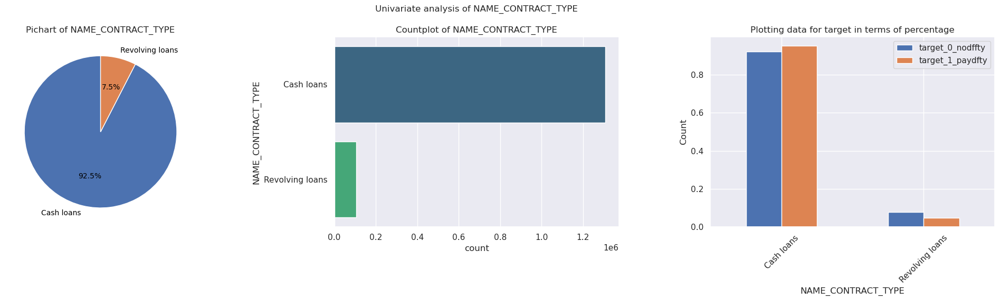

<Figure size 640x480 with 0 Axes>

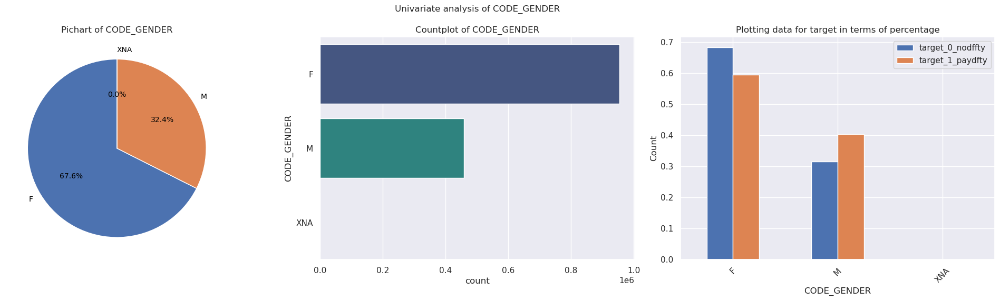

<Figure size 640x480 with 0 Axes>

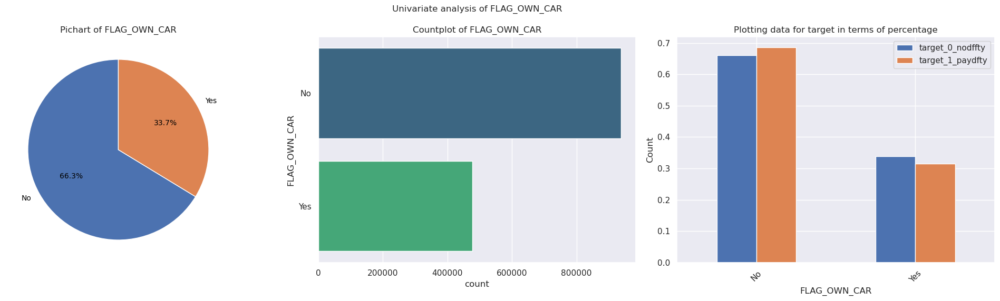

<Figure size 640x480 with 0 Axes>

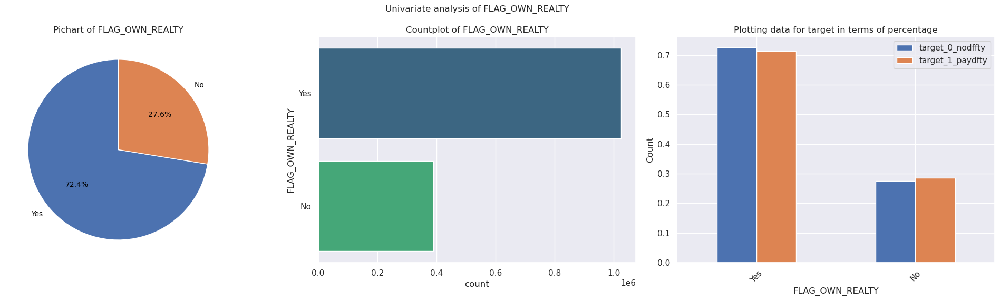

<Figure size 640x480 with 0 Axes>

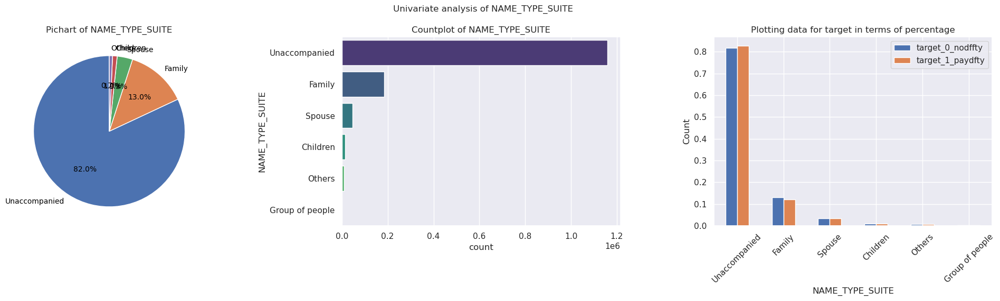

<Figure size 640x480 with 0 Axes>

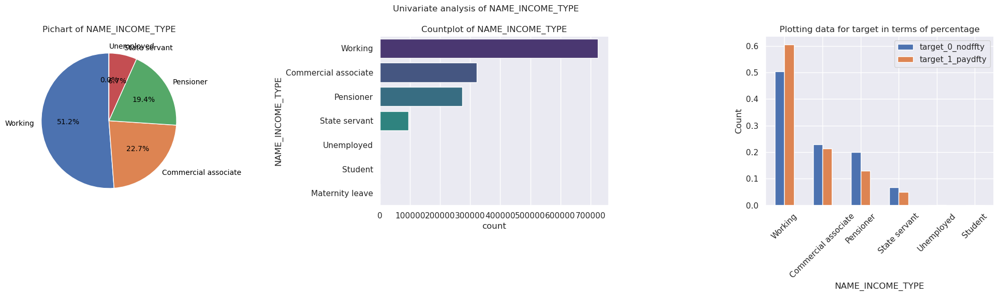

<Figure size 640x480 with 0 Axes>

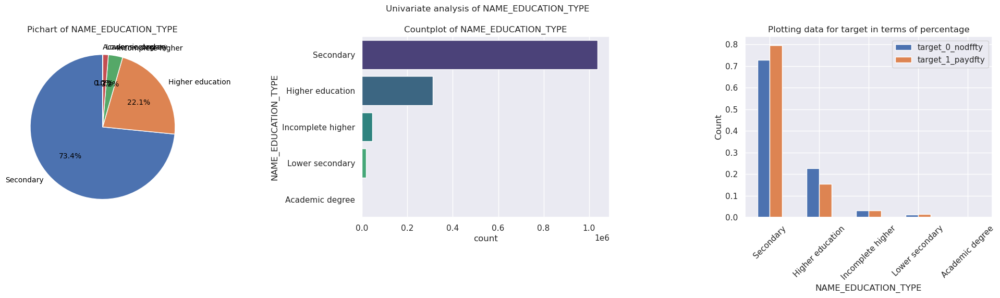

<Figure size 640x480 with 0 Axes>

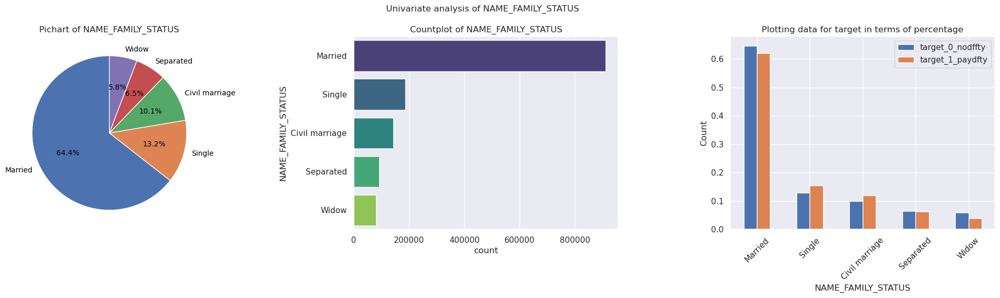

<Figure size 640x480 with 0 Axes>

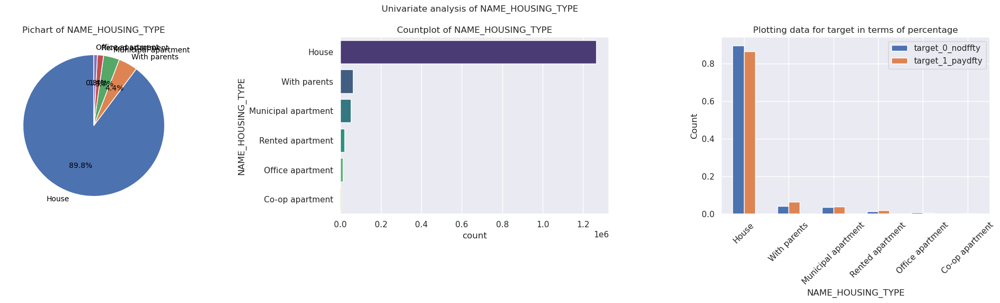

<Figure size 640x480 with 0 Axes>

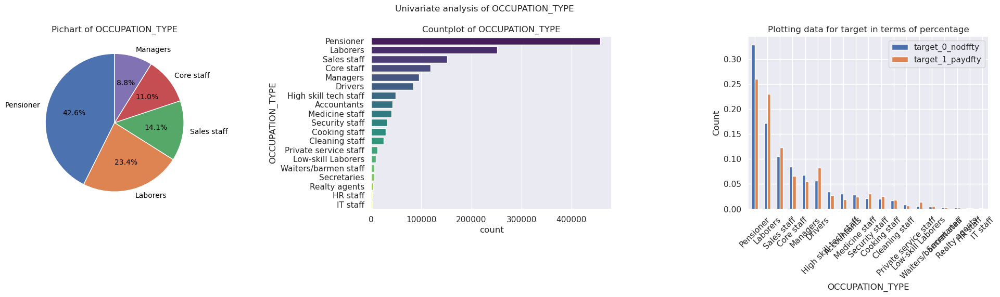

<Figure size 640x480 with 0 Axes>

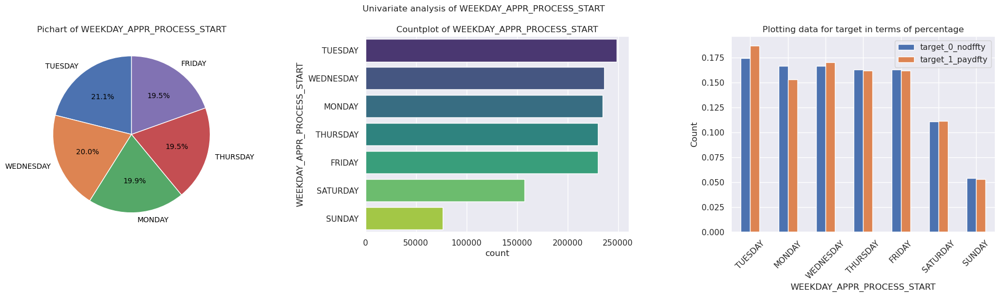

<Figure size 640x480 with 0 Axes>

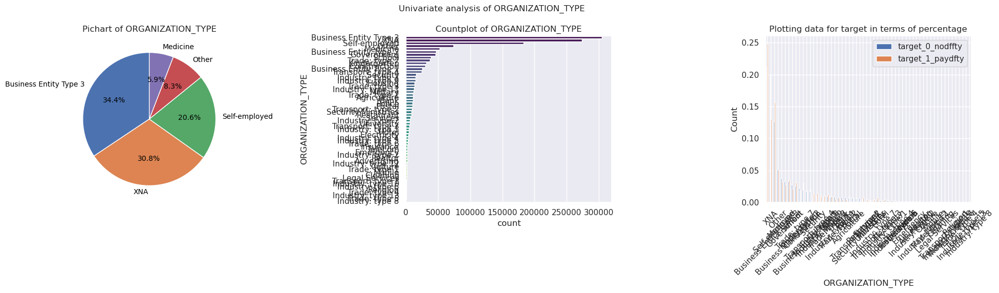

<Figure size 640x480 with 0 Axes>

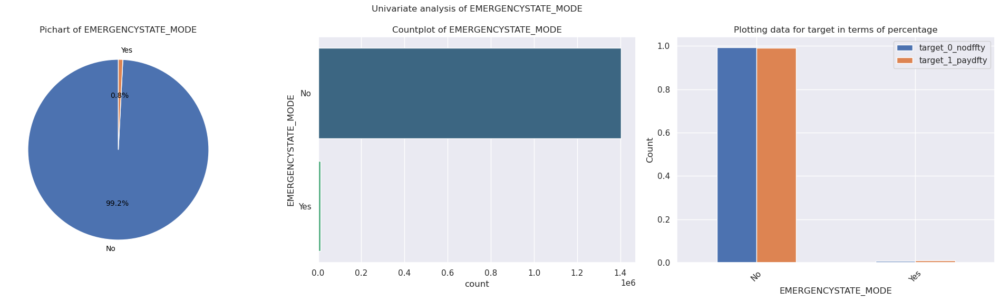

<Figure size 640x480 with 0 Axes>

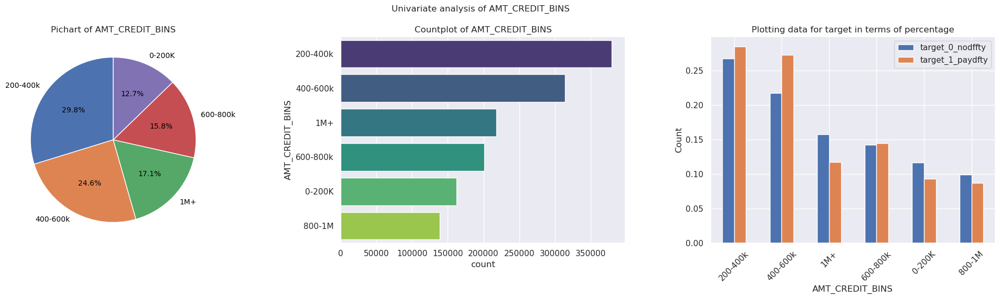

<Figure size 640x480 with 0 Axes>

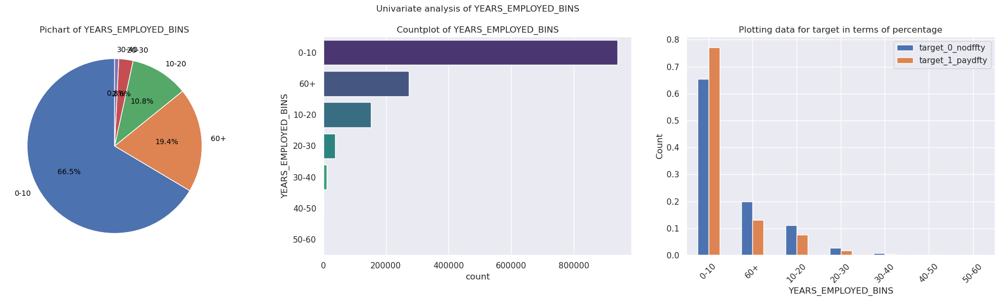

<Figure size 640x480 with 0 Axes>

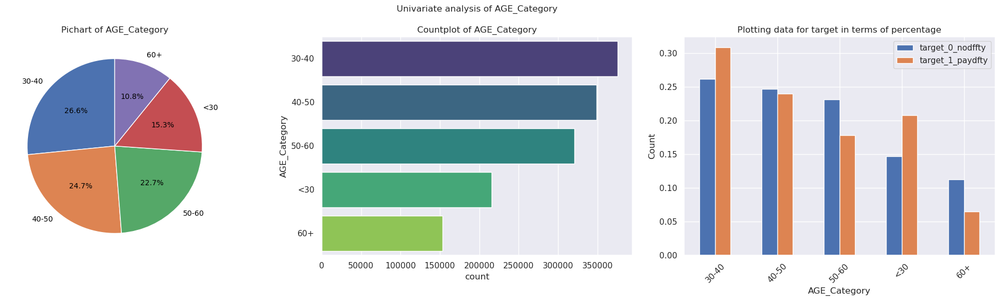

<Figure size 640x480 with 0 Axes>

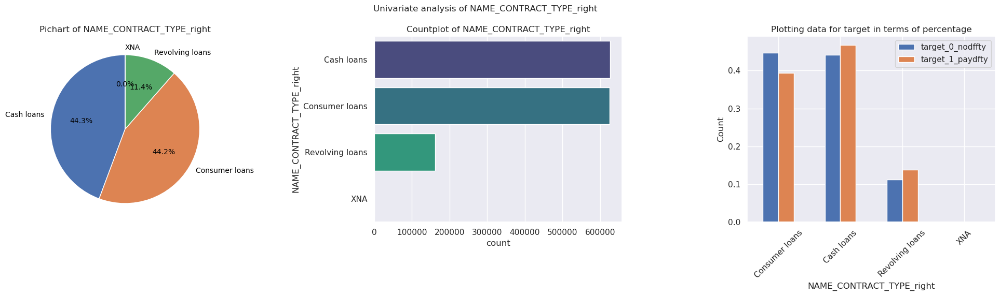

<Figure size 640x480 with 0 Axes>

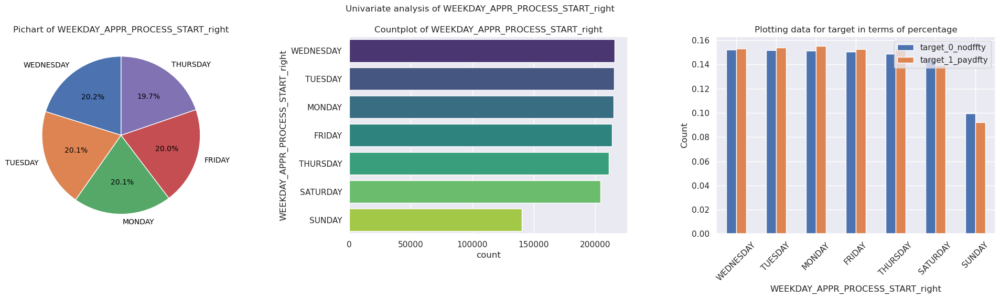

<Figure size 640x480 with 0 Axes>

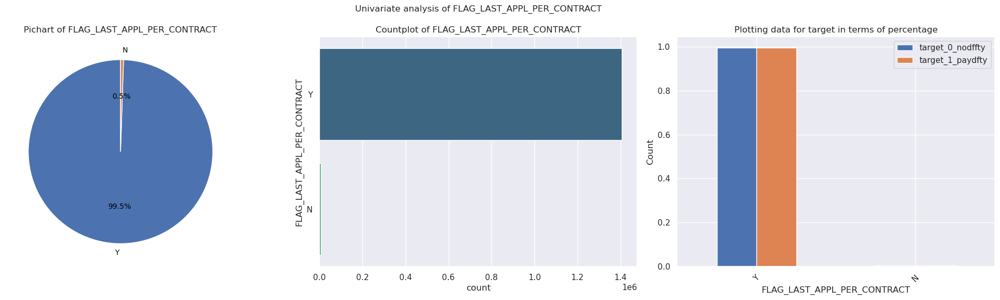

<Figure size 640x480 with 0 Axes>

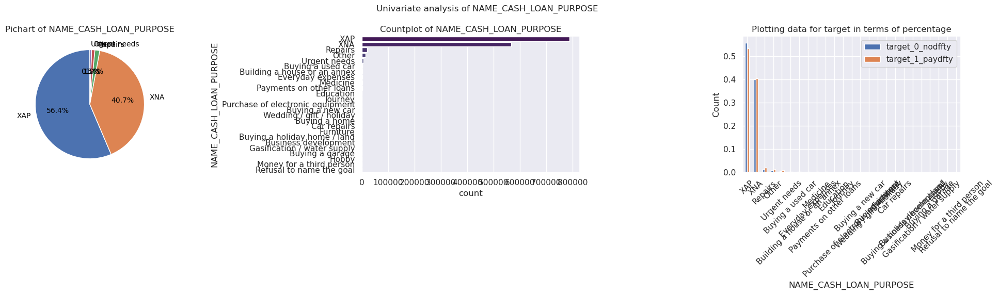

<Figure size 640x480 with 0 Axes>

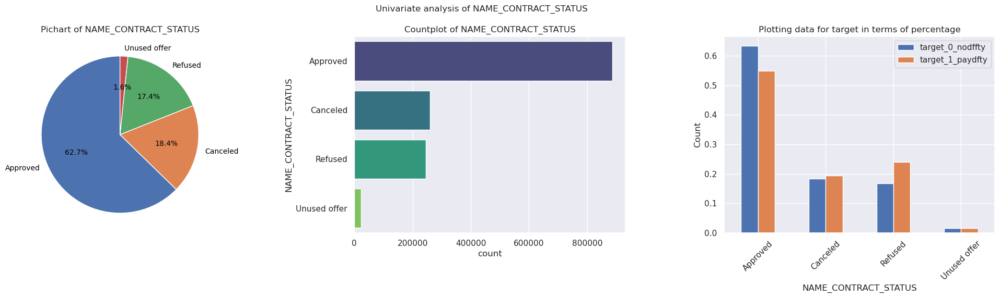

<Figure size 640x480 with 0 Axes>

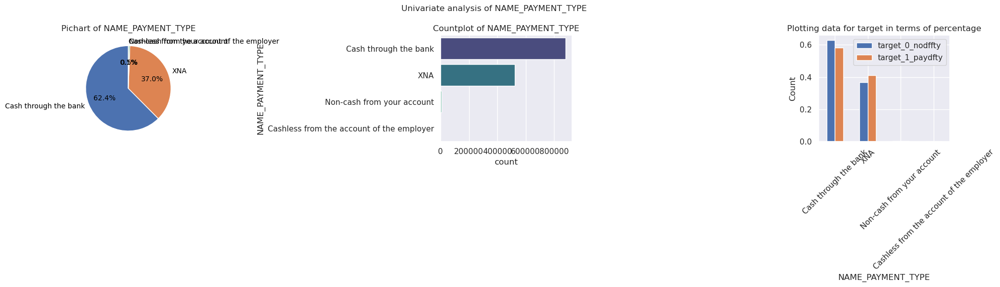

<Figure size 640x480 with 0 Axes>

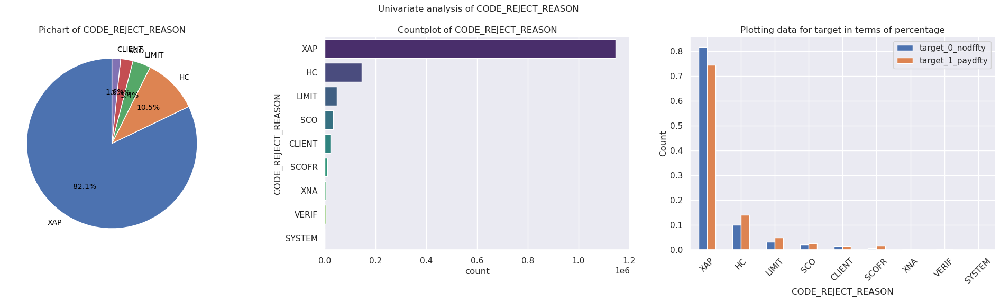

<Figure size 640x480 with 0 Axes>

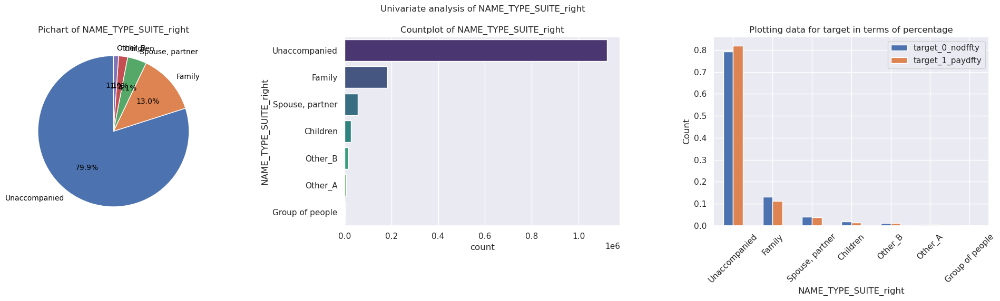

<Figure size 640x480 with 0 Axes>

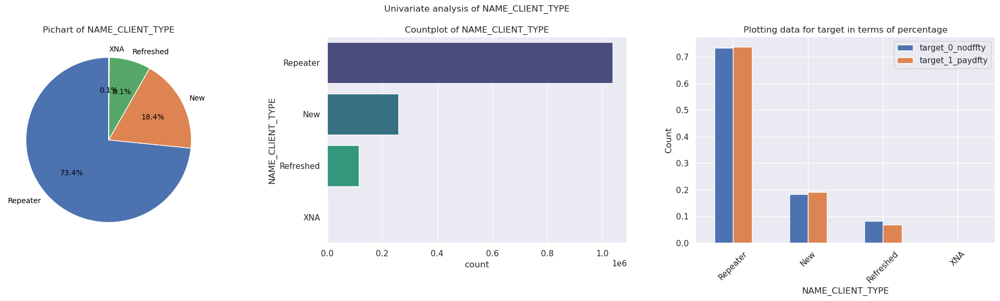

<Figure size 640x480 with 0 Axes>

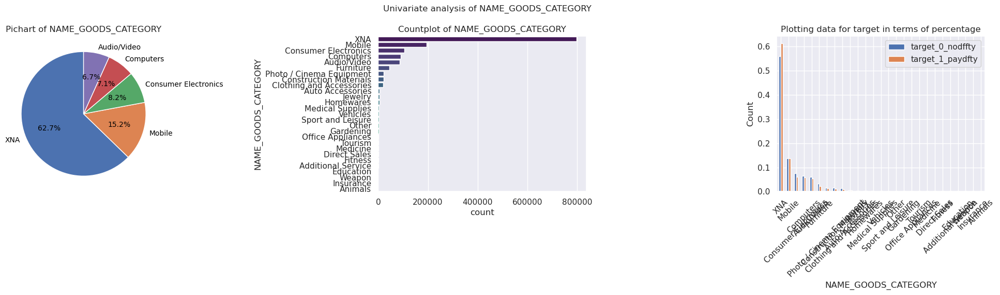

<Figure size 640x480 with 0 Axes>

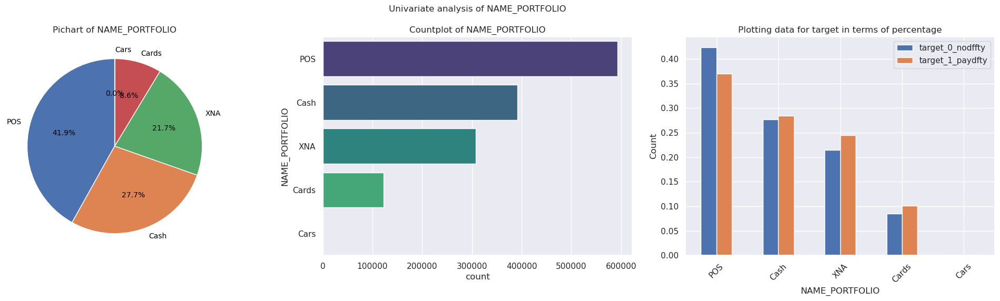

<Figure size 640x480 with 0 Axes>

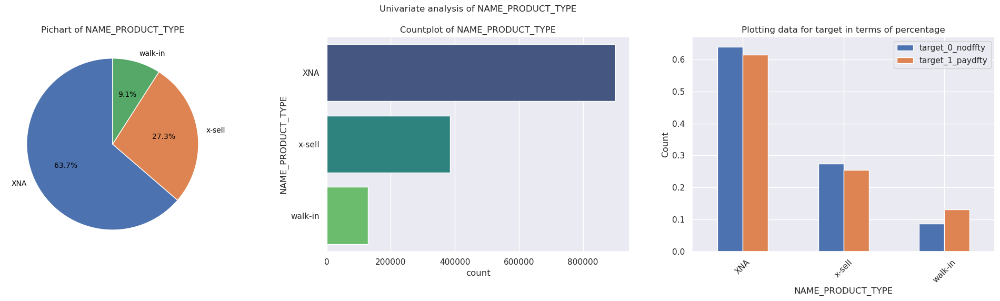

<Figure size 640x480 with 0 Axes>

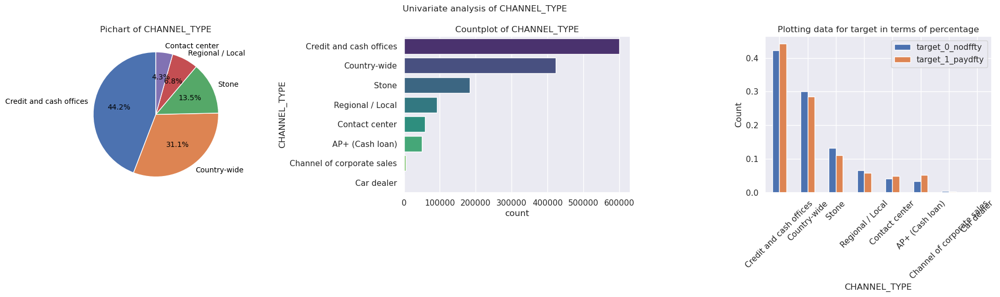

<Figure size 640x480 with 0 Axes>

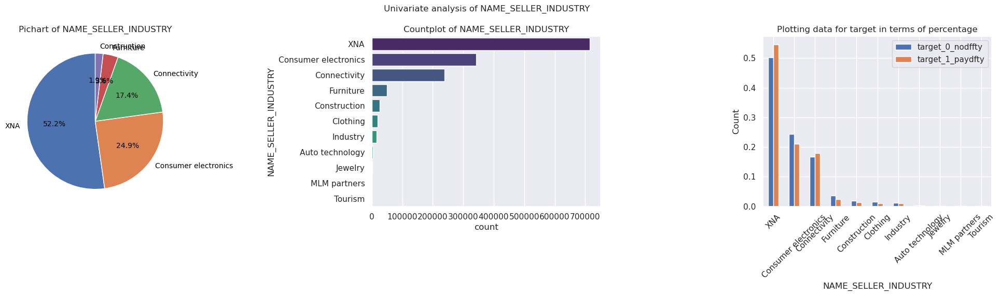

<Figure size 640x480 with 0 Axes>

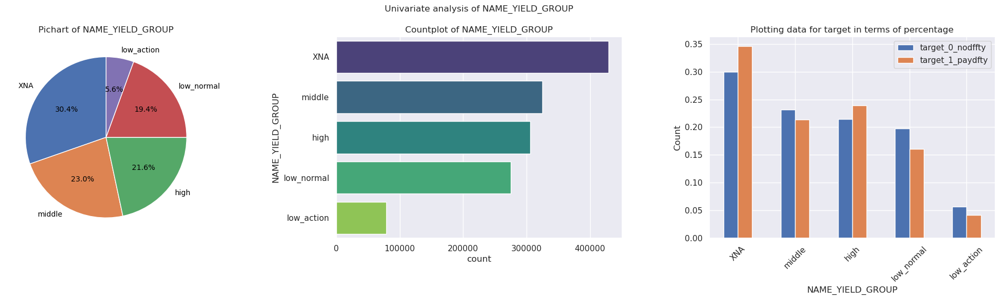

<Figure size 640x480 with 0 Axes>

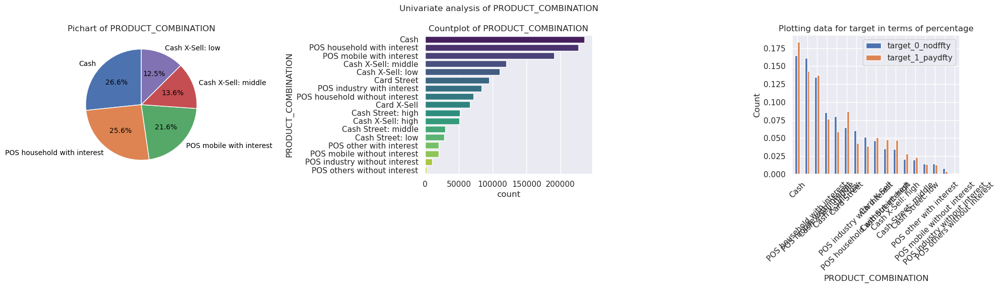

--------------------------------------------------------------------------


<Figure size 640x480 with 0 Axes>

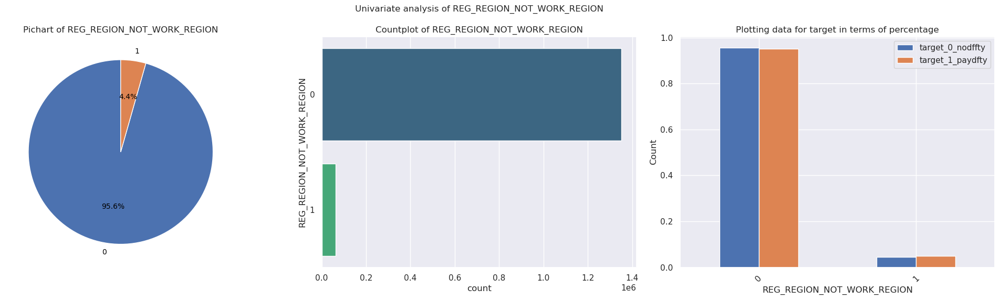

<Figure size 640x480 with 0 Axes>

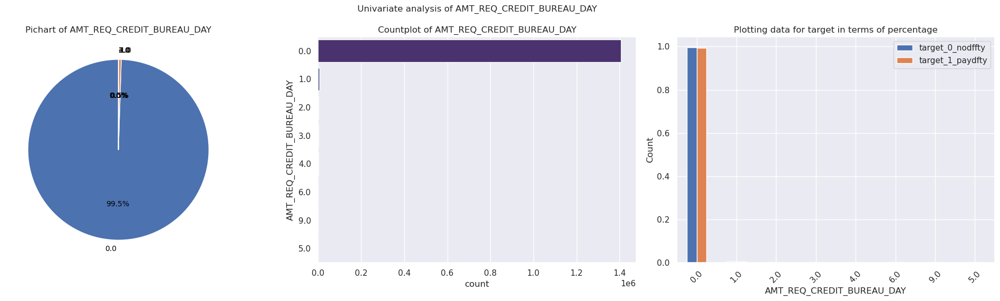

<Figure size 640x480 with 0 Axes>

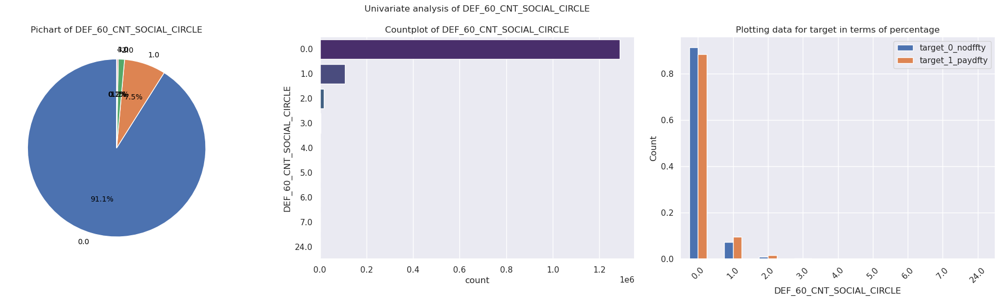

<Figure size 640x480 with 0 Axes>

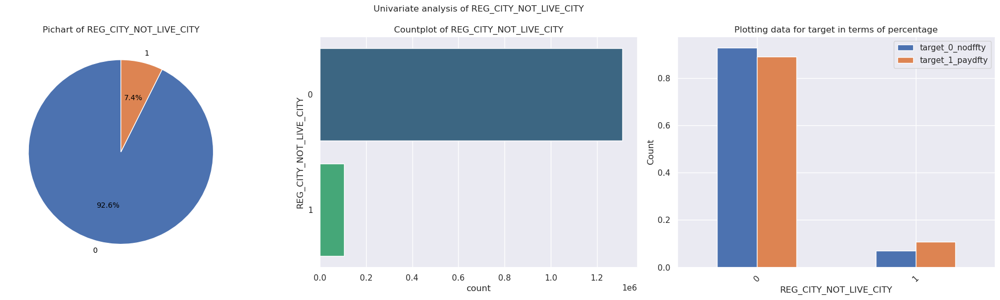

<Figure size 640x480 with 0 Axes>

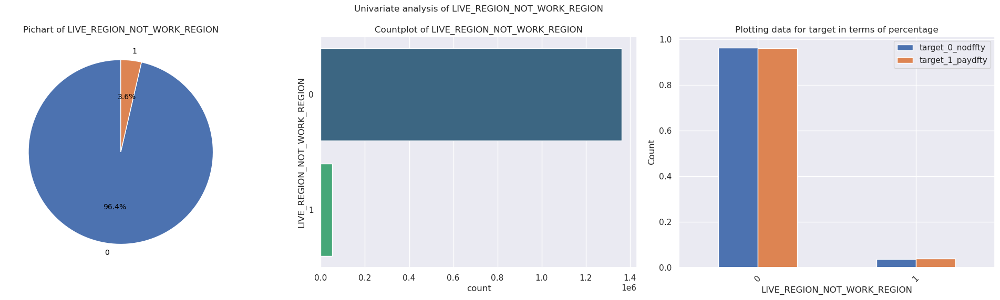

<Figure size 640x480 with 0 Axes>

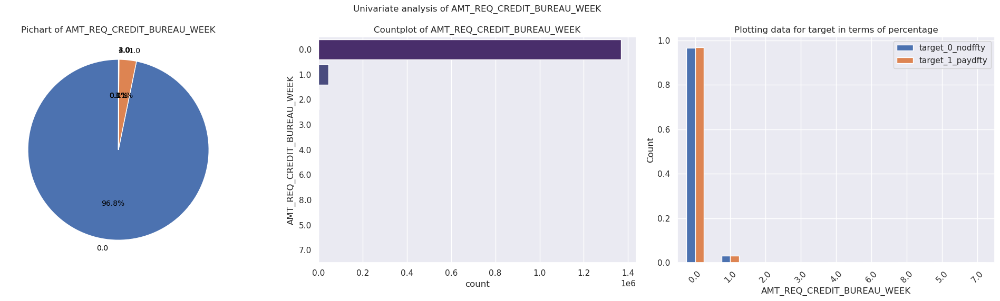

<Figure size 640x480 with 0 Axes>

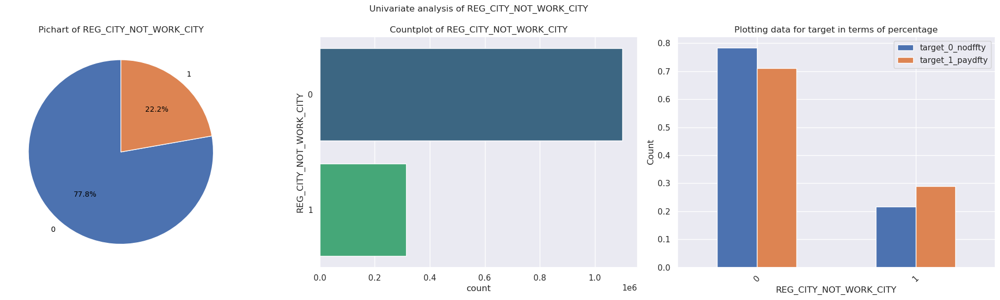

<Figure size 640x480 with 0 Axes>

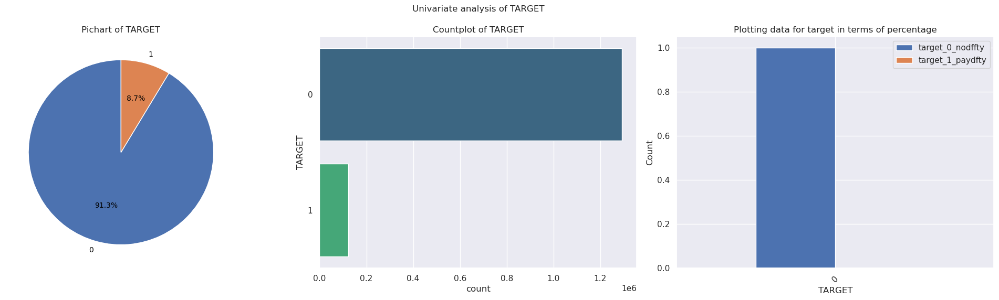

<Figure size 640x480 with 0 Axes>

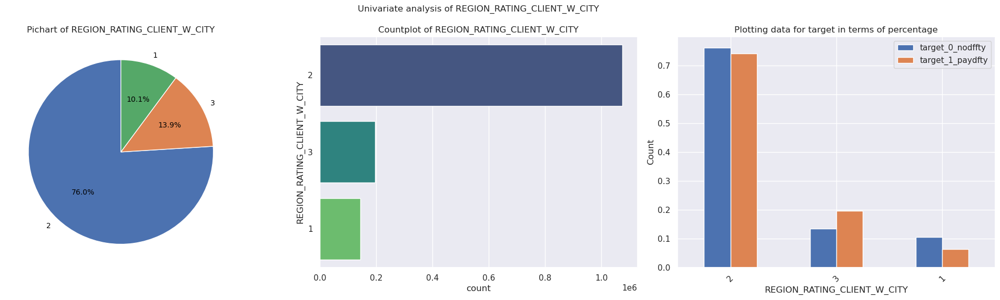

<Figure size 640x480 with 0 Axes>

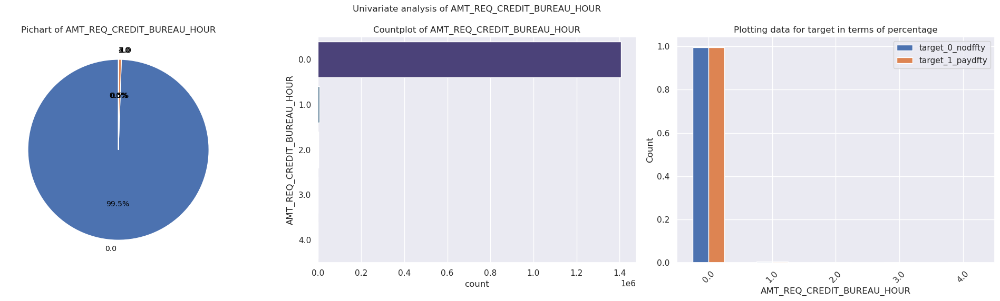

<Figure size 640x480 with 0 Axes>

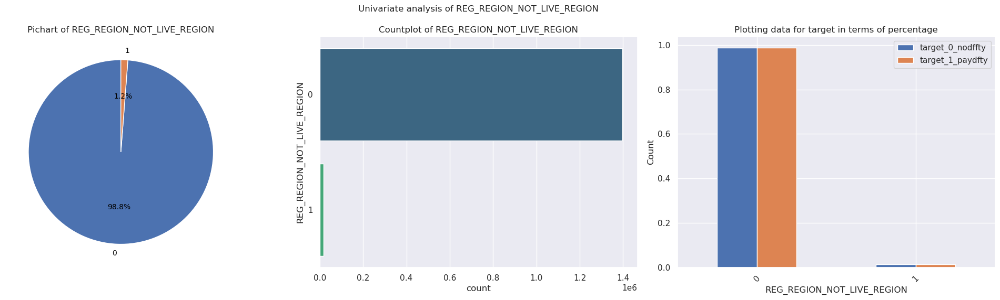

<Figure size 640x480 with 0 Axes>

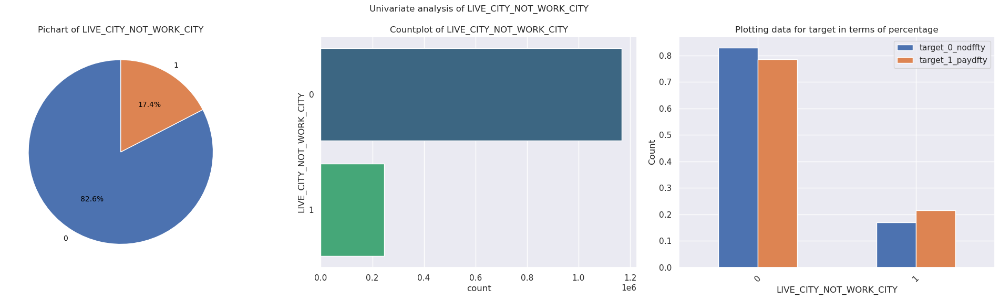

<Figure size 640x480 with 0 Axes>

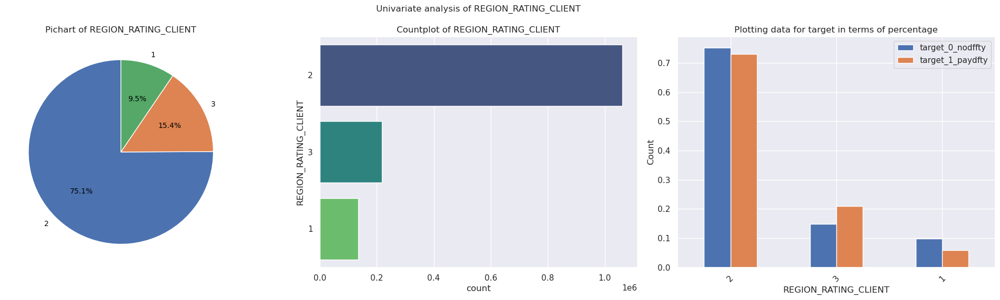

--------------------------------------------------------------------------


<Figure size 640x480 with 0 Axes>

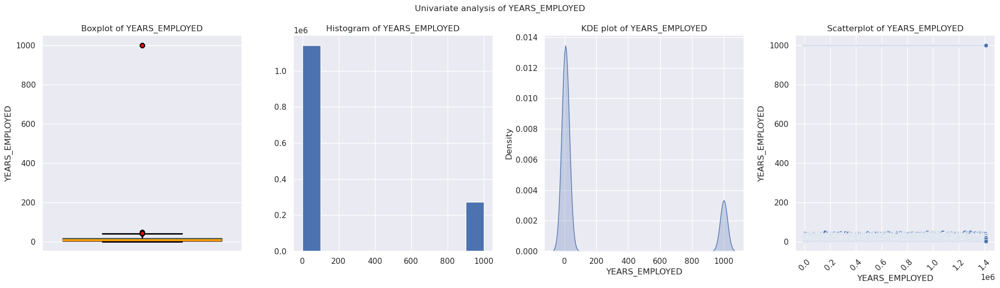

<Figure size 640x480 with 0 Axes>

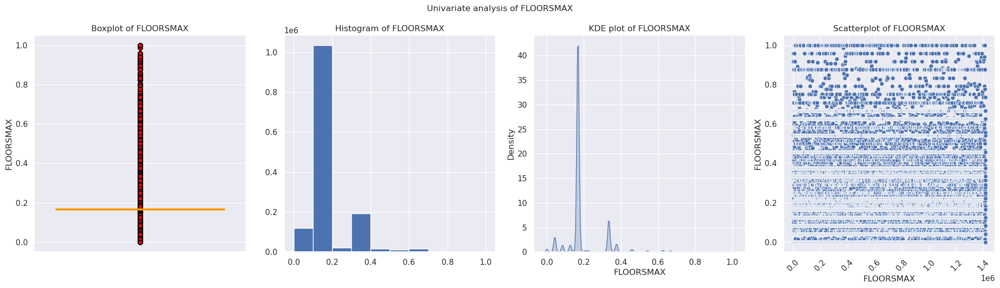

<Figure size 640x480 with 0 Axes>

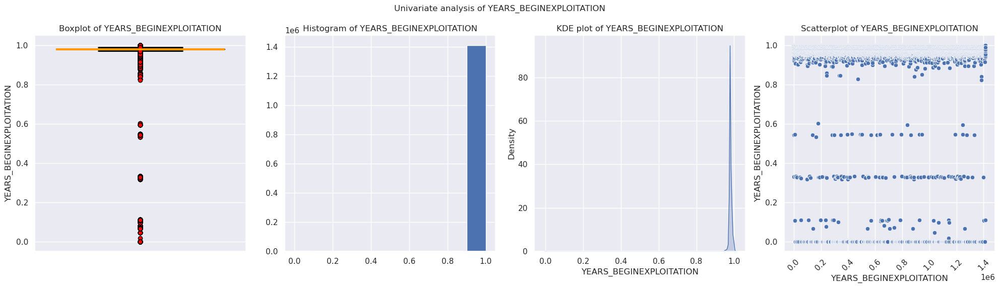

<Figure size 640x480 with 0 Axes>

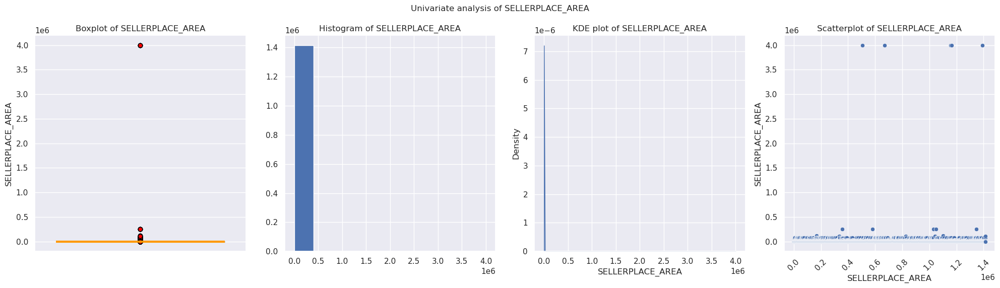

<Figure size 640x480 with 0 Axes>

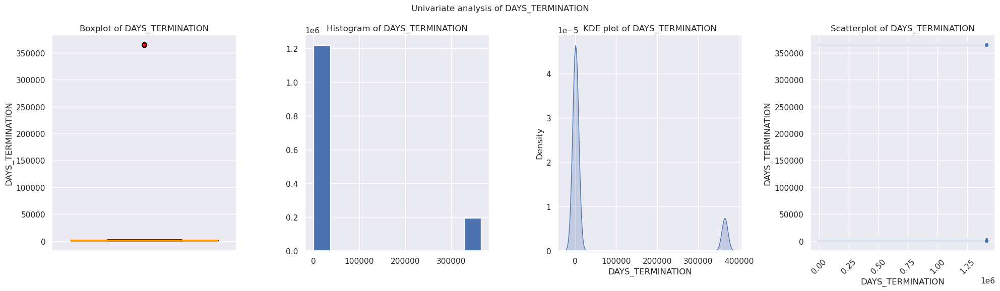

<Figure size 640x480 with 0 Axes>

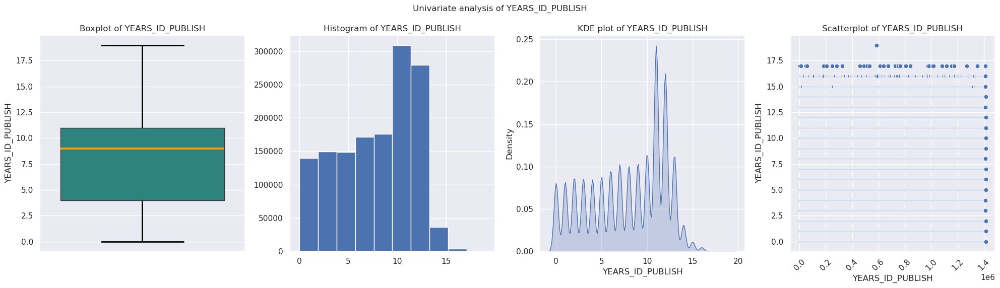

<Figure size 640x480 with 0 Axes>

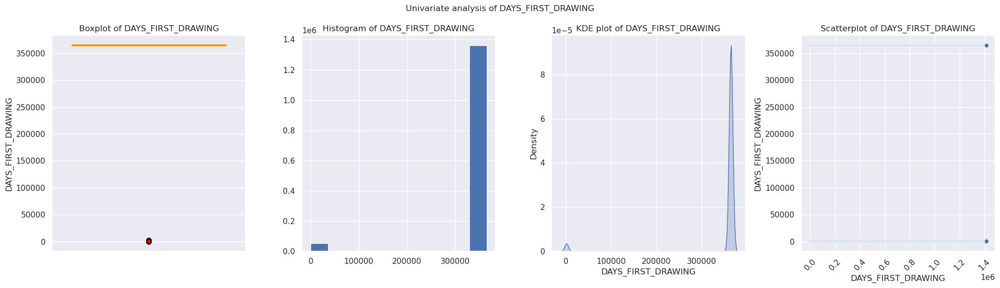

<Figure size 640x480 with 0 Axes>

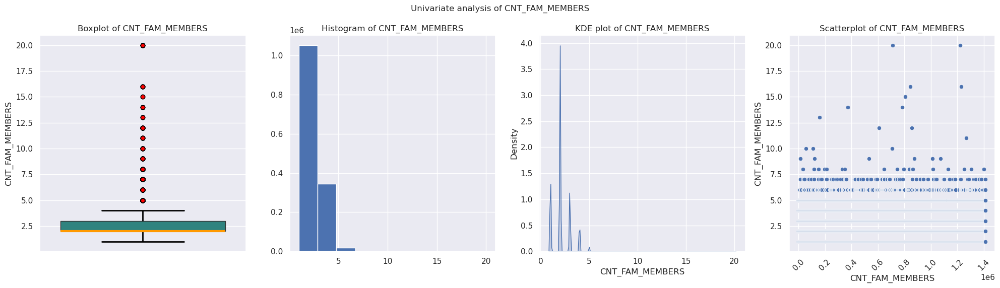

<Figure size 640x480 with 0 Axes>

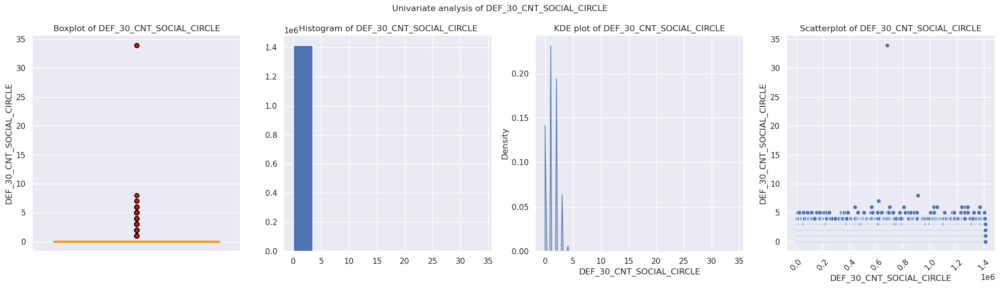

<Figure size 640x480 with 0 Axes>

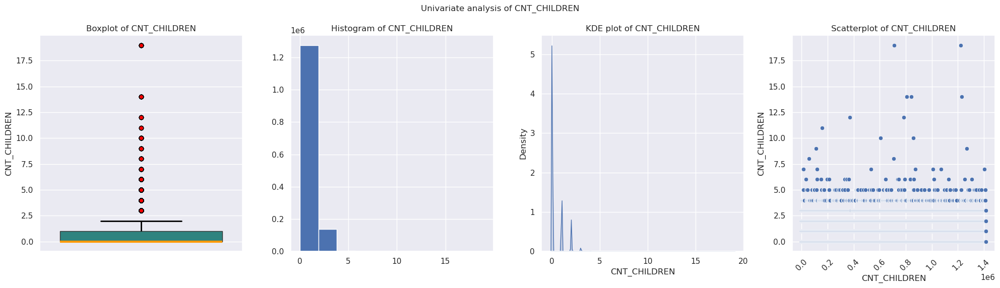

<Figure size 640x480 with 0 Axes>

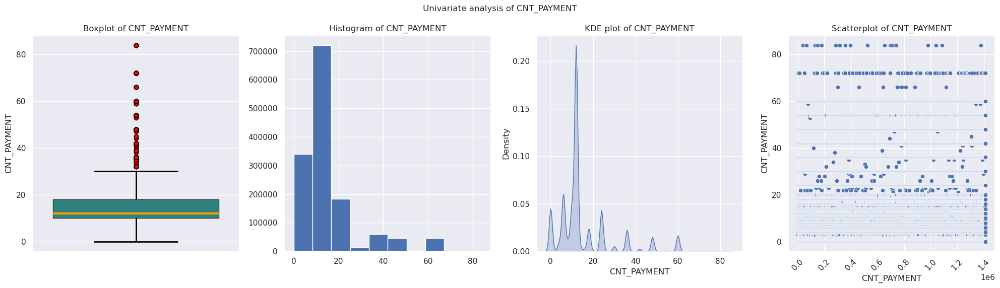

<Figure size 640x480 with 0 Axes>

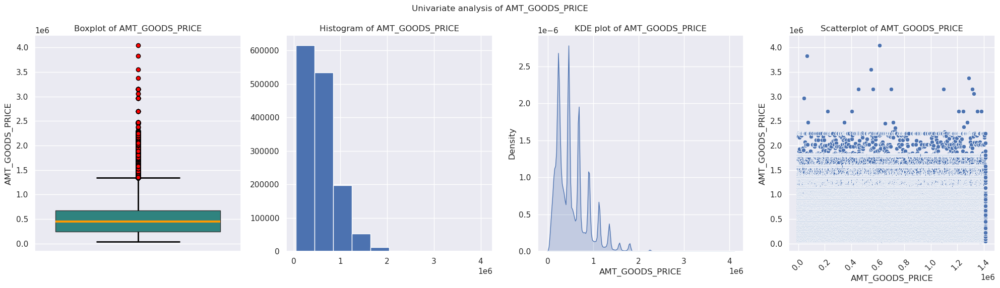

<Figure size 640x480 with 0 Axes>

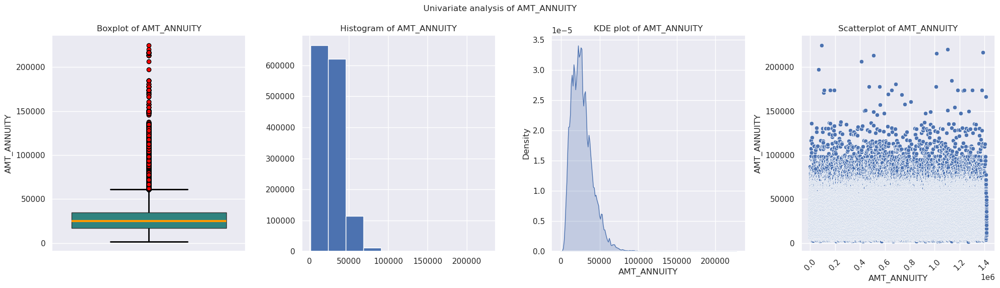

<Figure size 640x480 with 0 Axes>

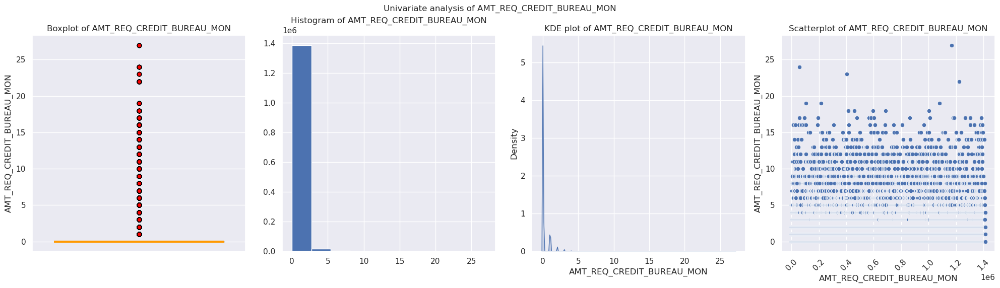

<Figure size 640x480 with 0 Axes>

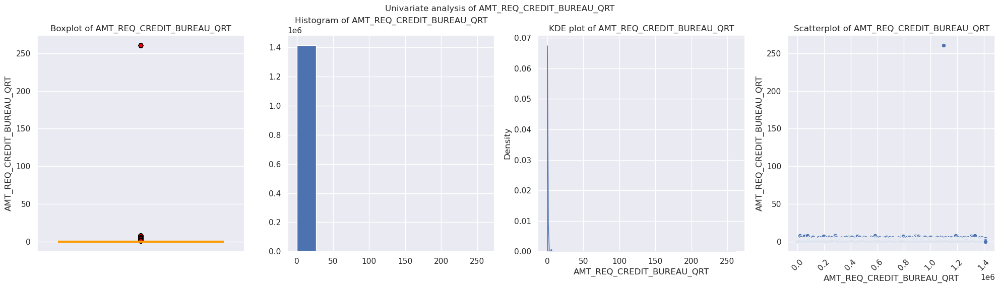

<Figure size 640x480 with 0 Axes>

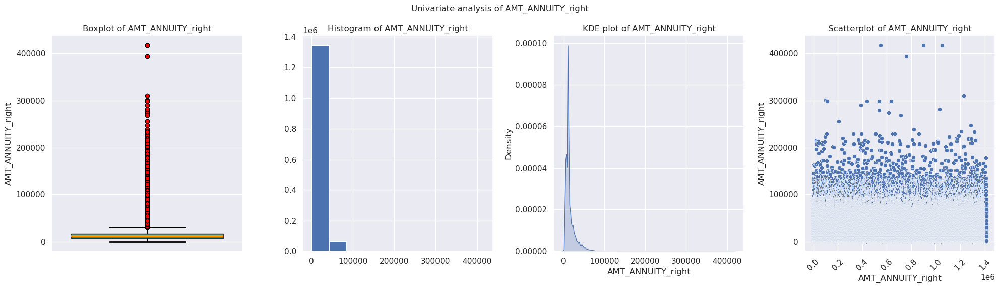

<Figure size 640x480 with 0 Axes>

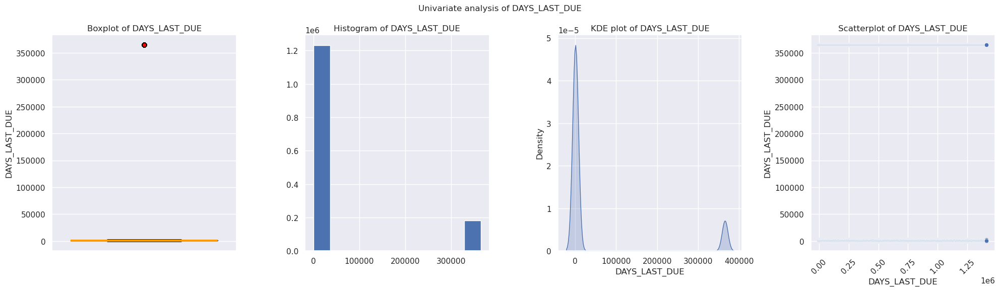

<Figure size 640x480 with 0 Axes>

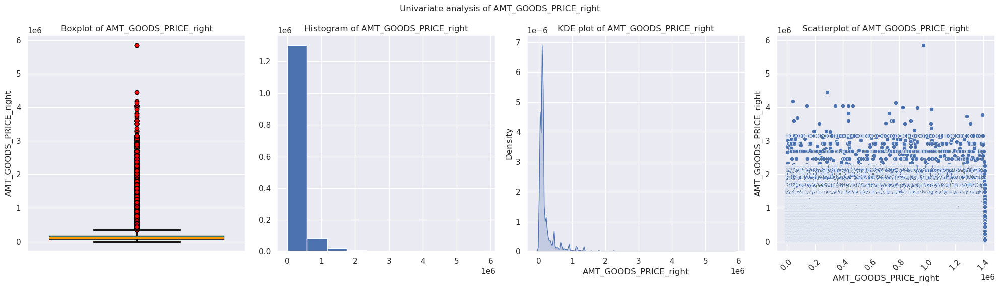

<Figure size 640x480 with 0 Axes>

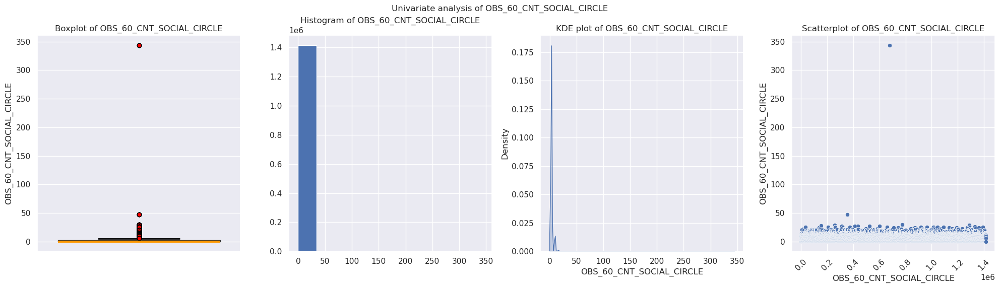

<Figure size 640x480 with 0 Axes>

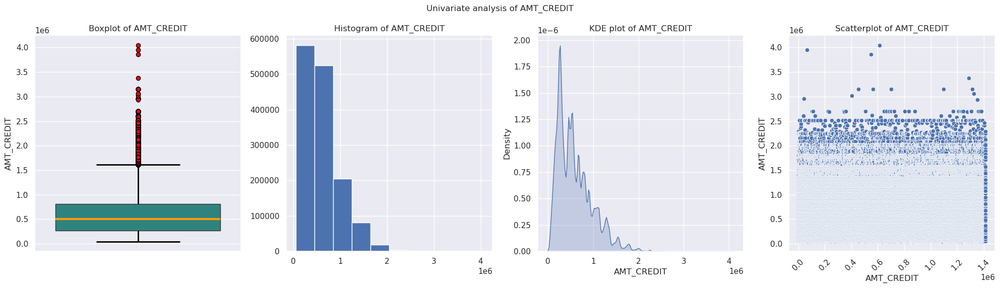

<Figure size 640x480 with 0 Axes>

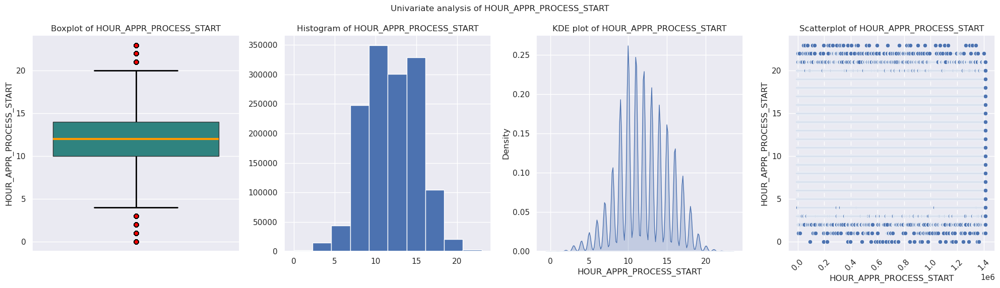

<Figure size 640x480 with 0 Axes>

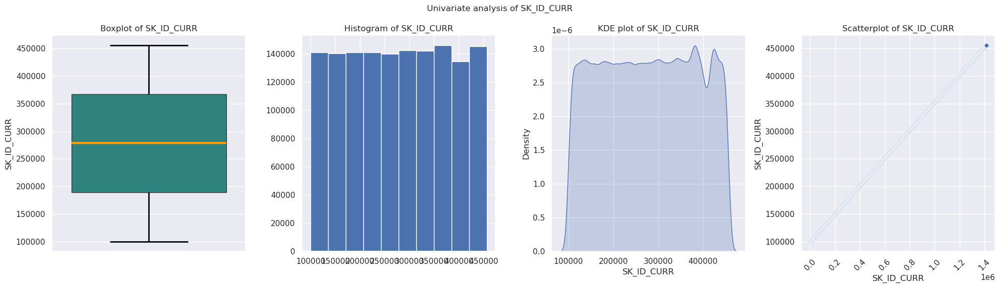

<Figure size 640x480 with 0 Axes>

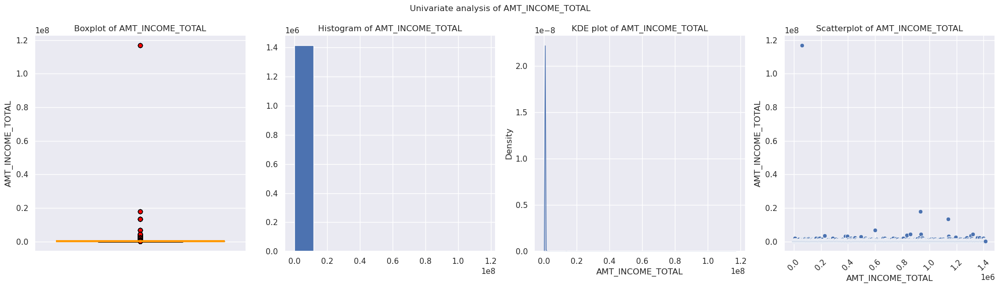

<Figure size 640x480 with 0 Axes>

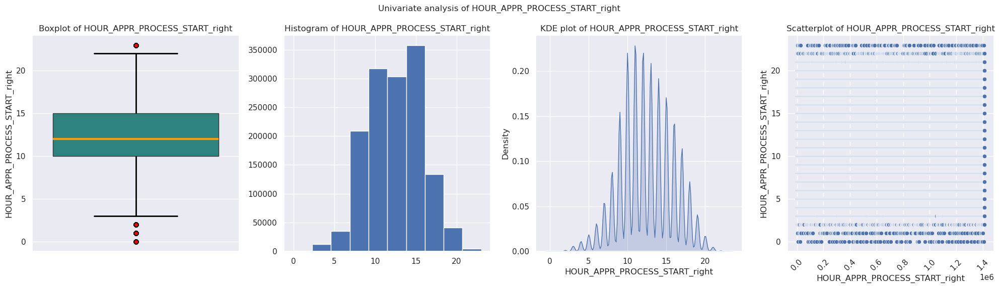

<Figure size 640x480 with 0 Axes>

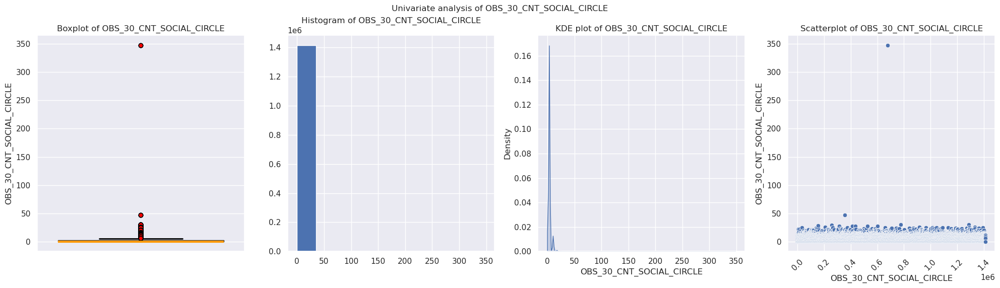

<Figure size 640x480 with 0 Axes>

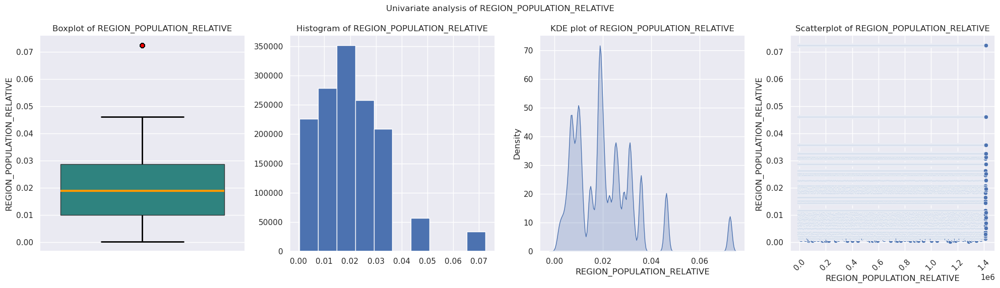

<Figure size 640x480 with 0 Axes>

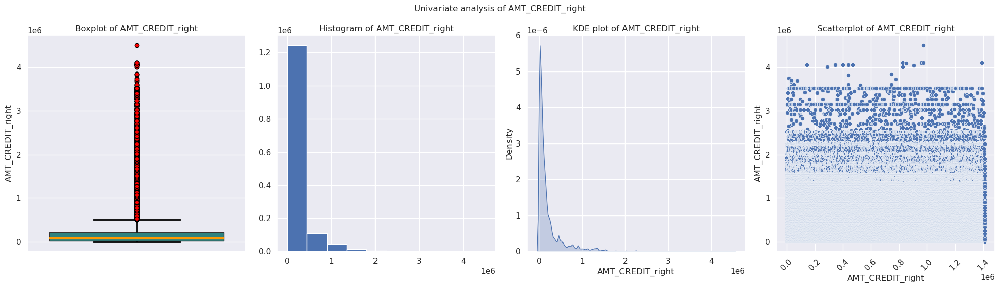

<Figure size 640x480 with 0 Axes>

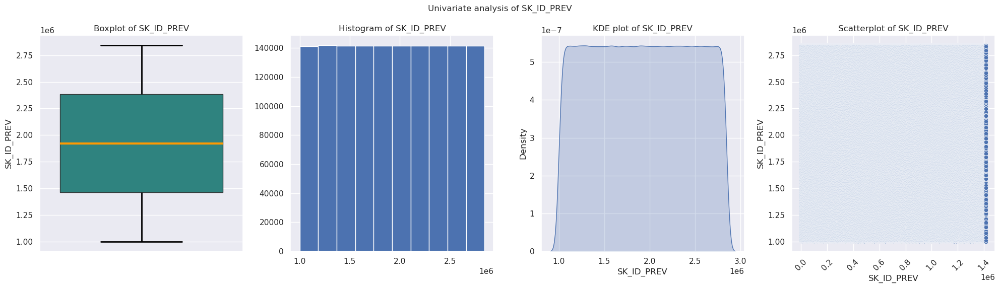

<Figure size 640x480 with 0 Axes>

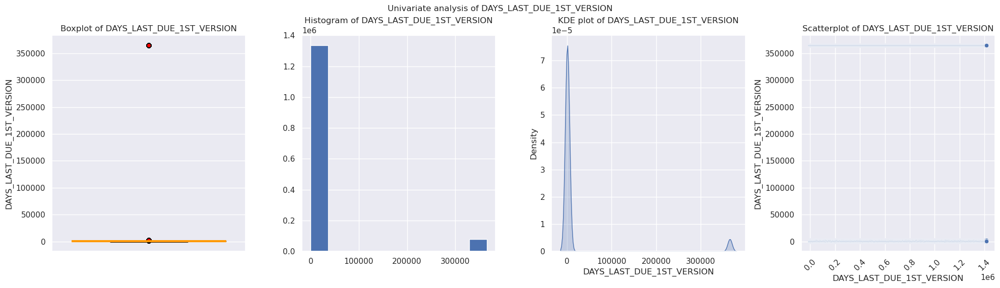

<Figure size 640x480 with 0 Axes>

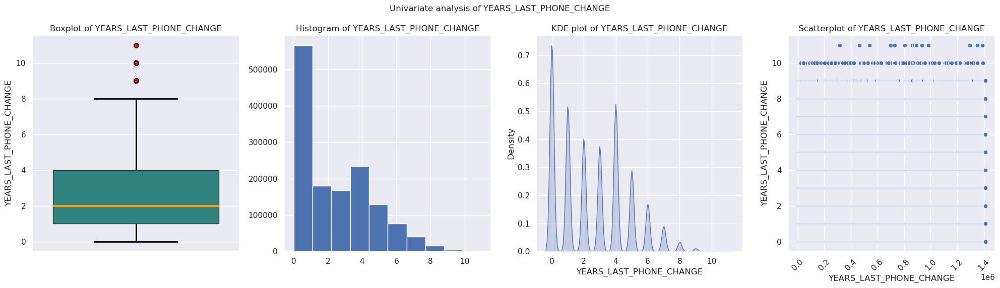

<Figure size 640x480 with 0 Axes>

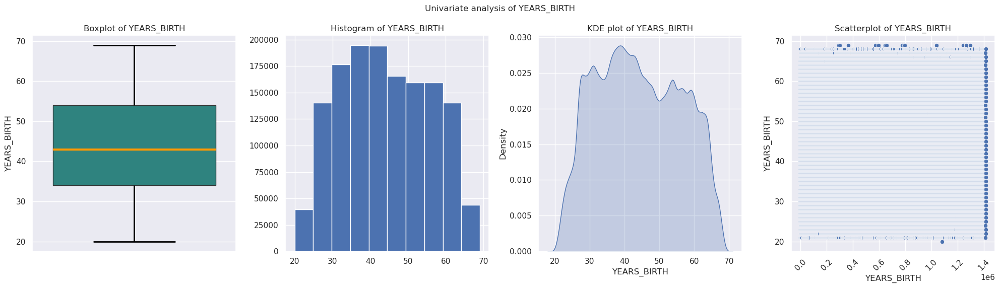

<Figure size 640x480 with 0 Axes>

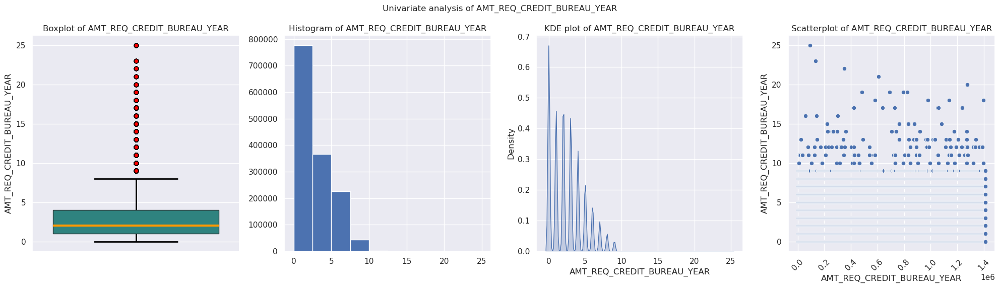

<Figure size 640x480 with 0 Axes>

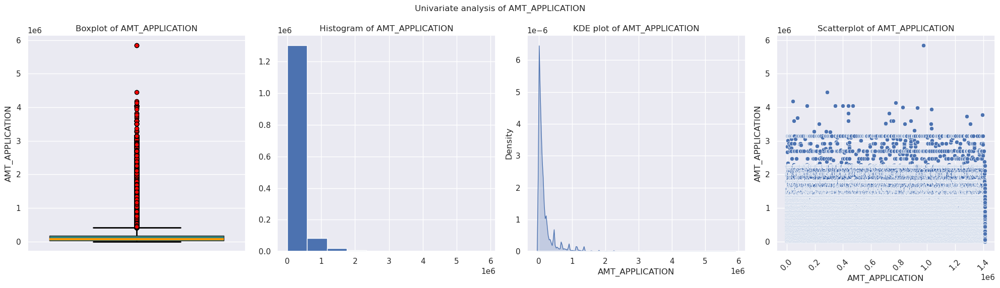

<Figure size 640x480 with 0 Axes>

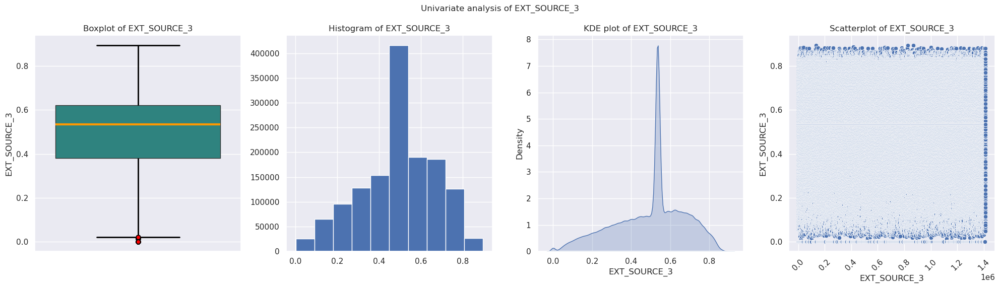

<Figure size 640x480 with 0 Axes>

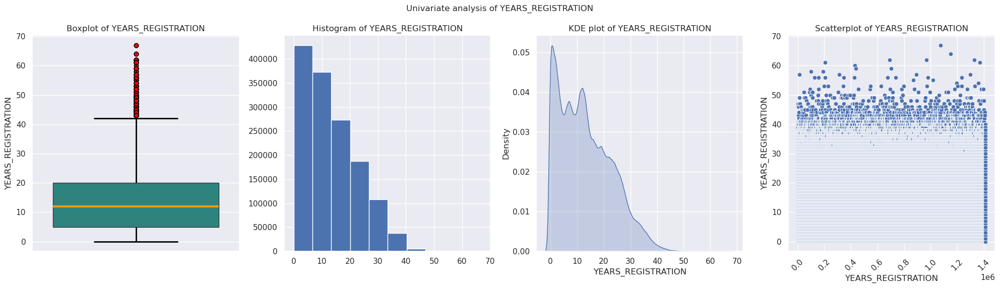

<Figure size 640x480 with 0 Axes>

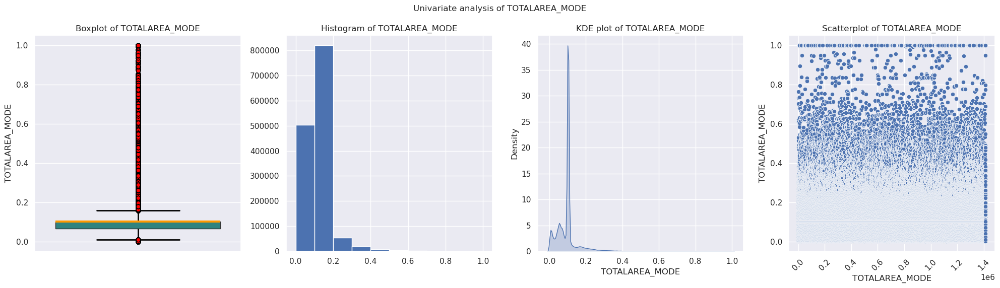

<Figure size 640x480 with 0 Axes>

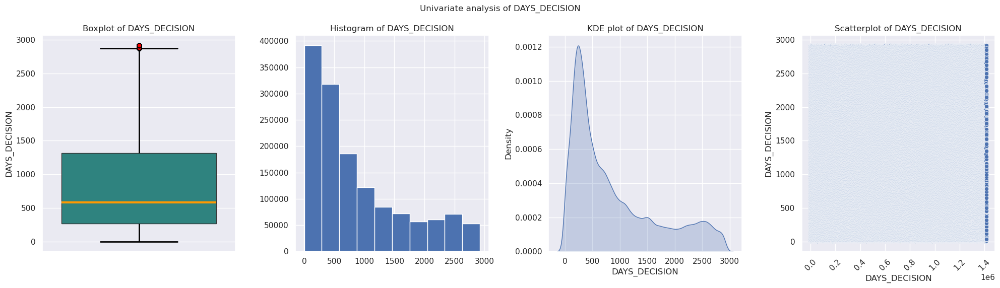

<Figure size 640x480 with 0 Axes>

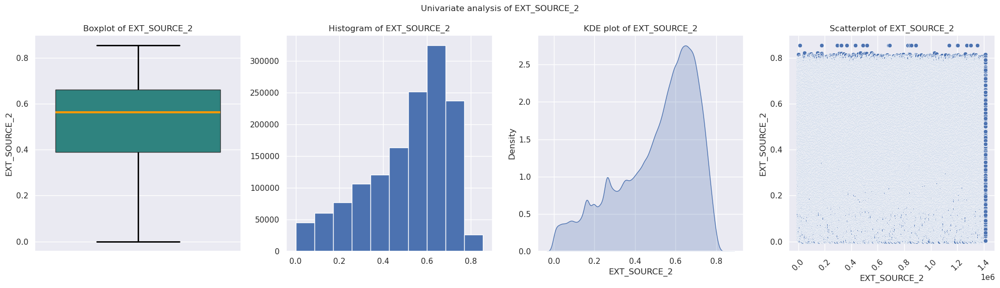

<Figure size 640x480 with 0 Axes>

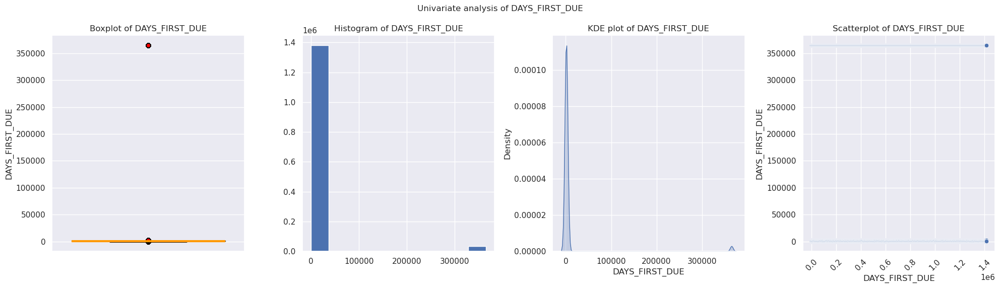

<Figure size 640x480 with 0 Axes>

In [36]:
# univariate_plots(combined_appl_data.head(60), combined_appl_data.select_dtypes(include=['category','object']).columns, t0 = comb_target_train_0, t1 = comb_target_train_1, ftype="category")
# print("--------------------------------------------------------------------------")
# univariate_plots(combined_appl_data.head(60), combined_dtype_dict['int_cat'], t0 = comb_target_train_0, t1 = comb_target_train_1, ftype="category")
# print("--------------------------------------------------------------------------")
# univariate_plots(combined_appl_data.head(60), combined_dtype_dict['float_ts'], ftype="non_categorical")

univariate_plots(combined_appl_data, combined_appl_data.select_dtypes(include=['category','object']).columns, t0 = comb_target_train_0, t1 = comb_target_train_1, ftype="category")
print("--------------------------------------------------------------------------")
univariate_plots(combined_appl_data, combined_dtype_dict['int_cat'], t0 = comb_target_train_0, t1 = comb_target_train_1, ftype="category")
print("--------------------------------------------------------------------------")
univariate_plots(combined_appl_data, combined_dtype_dict['float_ts'], ftype="non_categorical")

#### Bivariate Analysis

<Figure size 800x500 with 0 Axes>

<Axes: xlabel='NAME_EDUCATION_TYPE', ylabel='percent'>

([0, 1, 2, 3, 4],
 [Text(0, 0, 'Higher education'),
  Text(1, 0, 'Secondary'),
  Text(2, 0, 'Incomplete higher'),
  Text(3, 0, 'Lower secondary'),
  Text(4, 0, 'Academic degree')])

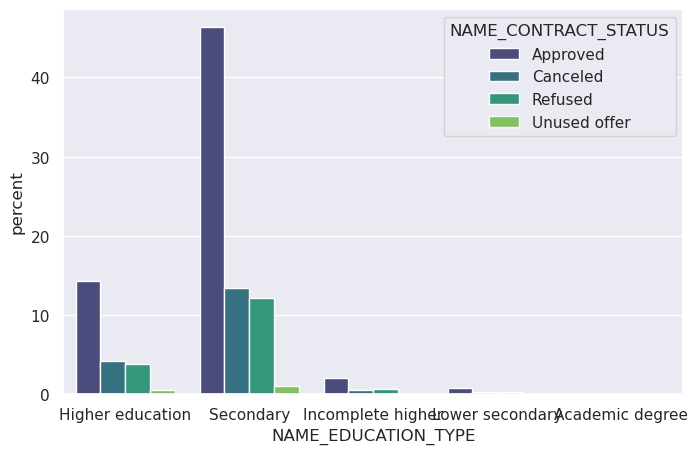

In [37]:
plt.figure(figsize=(8,5))
sns.countplot(x='NAME_EDUCATION_TYPE', hue='NAME_CONTRACT_STATUS', data=comb_target_train_0, palette='viridis', stat="percent")
plt.xticks(rotation=0)
plt.show()

<Figure size 800x500 with 0 Axes>

<Axes: xlabel='NAME_CONTRACT_TYPE', ylabel='proportion'>

([0, 1], [Text(0, 0, 'Cash loans'), Text(1, 0, 'Revolving loans')])

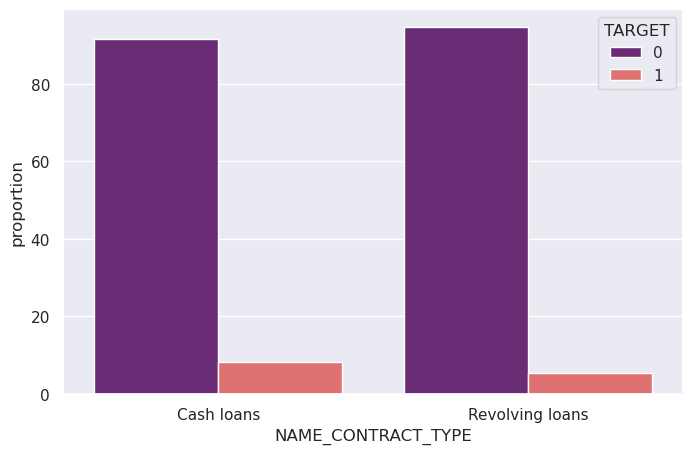

In [38]:
plt.figure(figsize=(8,5))
grouped_df = (curr_appl_data1.groupby(["NAME_CONTRACT_TYPE"])["TARGET"].value_counts(normalize=True)*100).reset_index()
sns.barplot(x='NAME_CONTRACT_TYPE', y='proportion', hue='TARGET', data=grouped_df, palette='magma')
plt.xticks(rotation=0)
plt.show()

In [39]:
# sns.pairplot(curr_appl_data1[curr_dtype_dict])
# sns.pairplot(prev_appl_data1[prev_dtype_dict])

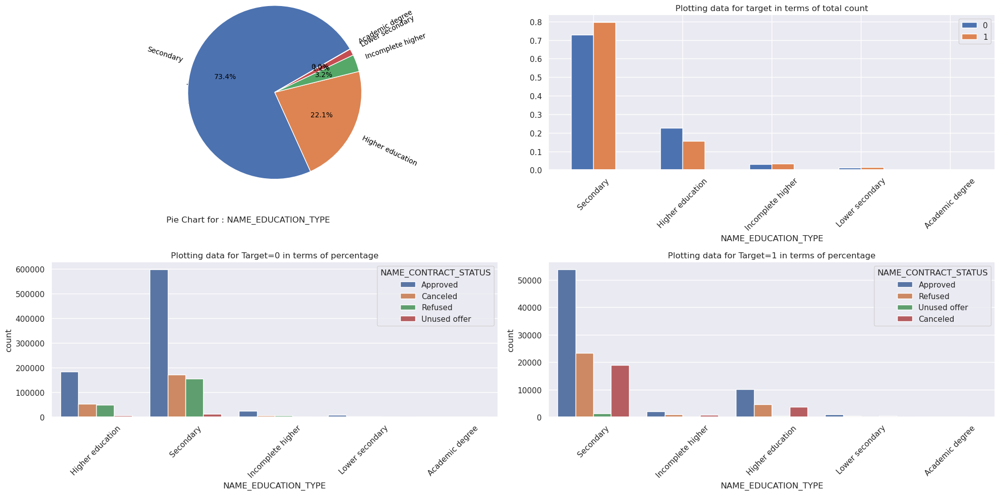

<Figure size 640x480 with 0 Axes>

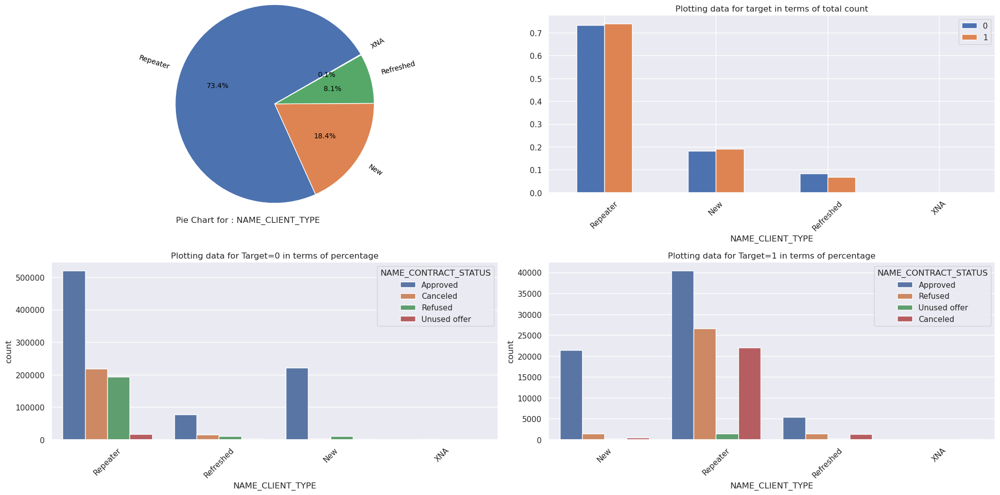

<Figure size 640x480 with 0 Axes>

In [40]:
bivariate_plots(df=combined_appl_data, col='NAME_EDUCATION_TYPE', hue='NAME_CONTRACT_STATUS', train0=comb_target_train_0, train1=comb_target_train_1 )
bivariate_plots(df=combined_appl_data, col='NAME_CLIENT_TYPE', hue='NAME_CONTRACT_STATUS', train0=comb_target_train_0, train1=comb_target_train_1 )

Client who are Secondary educated have mostly applied for the loan, 
They have the greater chance of paying their installments on time without difficulties among the given categories.

Most loan applicants are Repeaters
Also Most loan applicants who do not have difficulty in paying their installments are Repeaters among the given categories.

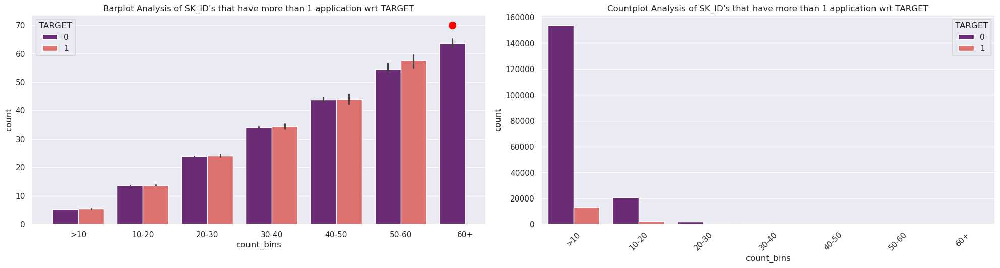

<Figure size 640x480 with 0 Axes>

In [41]:
sk_id_tg = combined_appl_data.groupby(by=['SK_ID_CURR'])['TARGET'].value_counts() # grouped all sku ids wrt target
sk_id_tg_df = sk_id_tg[sk_id_tg > 2].reset_index()

sk_id_tg_df['count_bins'] = pd.cut(sk_id_tg_df['count'], bins=[0,10,20,30,40,50,60,70], labels=['>10','10-20','20-30','30-40','40-50','50-60','60+'])

fig, axes = plt.subplots(1, 2, figsize=(20, 6));
sns.barplot(x='count_bins', y='count', hue='TARGET',  data=sk_id_tg_df, palette='magma', ax=axes[0]);
axes[0].set_title("Barplot Analysis of SK_ID's that have more than 1 application wrt TARGET"); plt.xticks(rotation=45); 
axes[0].plot([5.8], [70], marker='o', color='red',  markersize=10, linestyle='--', linewidth=2)

sns.countplot(x='count_bins', hue='TARGET',  data=sk_id_tg_df, palette='magma', ax=axes[1])
axes[1].set_title("Countplot Analysis of SK_ID's that have more than 1 application wrt TARGET"); plt.xticks(rotation=45); 
fig.subplots_adjust(wspace=0.5, hspace=0.3);

plt.tight_layout();
plt.subplots_adjust(top=0.85);
plt.show();
plt.clf();

In [42]:
sk_id_tg[sk_id_tg > 60]
sk_id_tg[sk_id_tg > 60].count()

SK_ID_CURR  TARGET
173680      0         72
198355      0         63
206783      0         67
238250      0         61
242412      0         68
265681      0         73
280586      0         61
345161      0         62
382179      0         64
389950      0         64
446486      0         62
Name: count, dtype: int64

11

- Using the combined data (application.csv , prev_application.csv) 
- Having looked at the graph, it was very surprising to see the count_bins 60+ category, 
- Those sku's have no payment difficulties. there were 11 of them.
- Further analysis may give out the reason for such outcomes.

#### Correlation Matrix

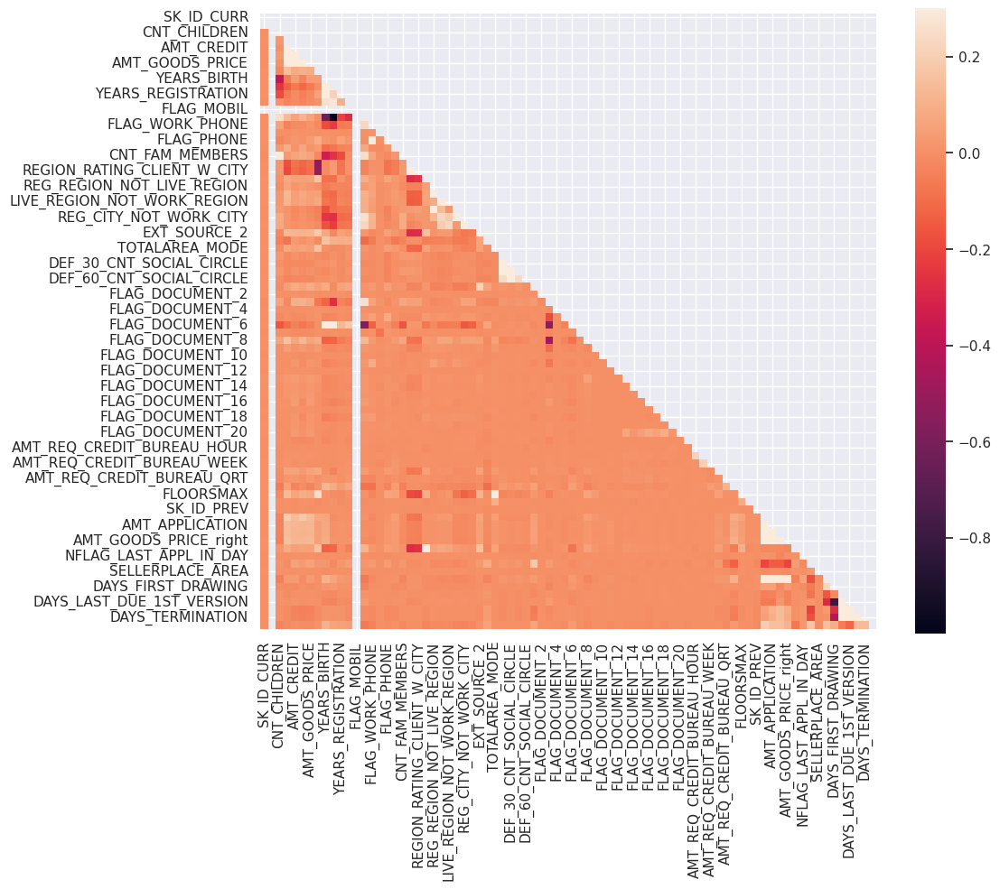

In [43]:
import numpy as np
corr = comb_target_train_0[comb_target_train_0.select_dtypes(exclude=['category','object']).columns].corr()
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True
f, ax = plt.subplots(figsize=(11, 9))
with sns.axes_style("white"):
    ax = sns.heatmap(corr, mask=mask, vmax=.3, square=True)

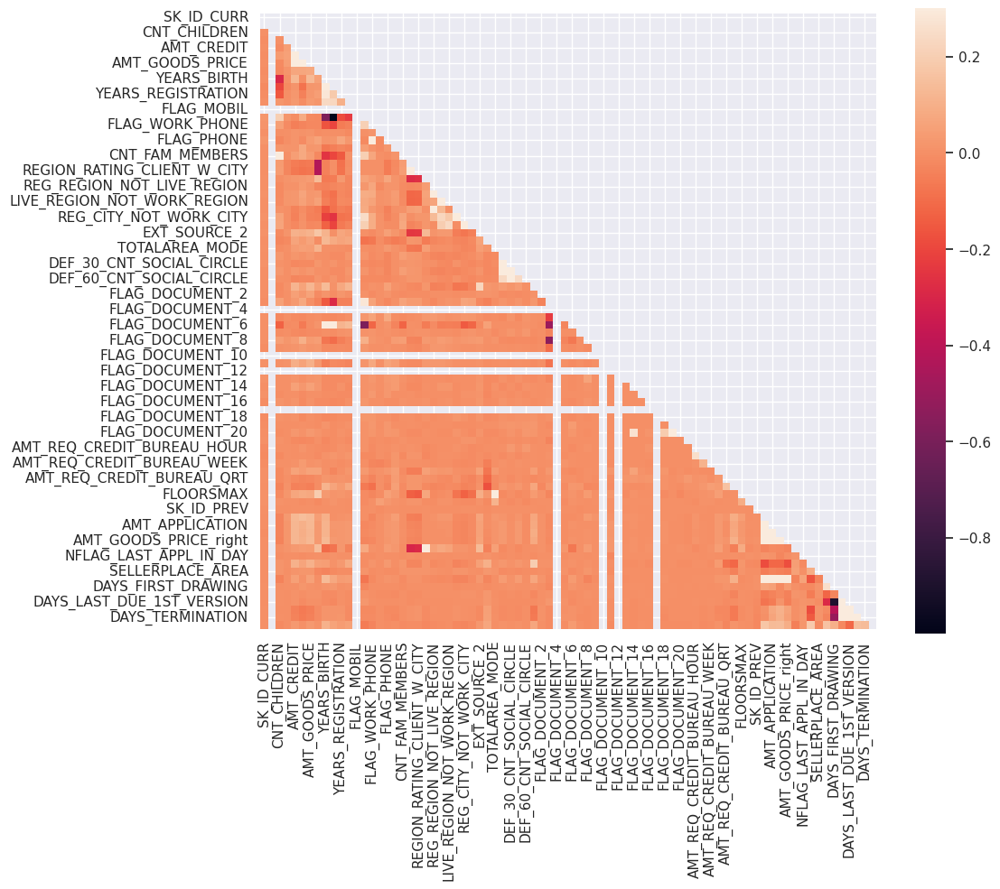

In [44]:
import numpy as np
corr = comb_target_train_1[comb_target_train_1.select_dtypes(exclude=['category','object']).columns].corr()
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True
f, ax = plt.subplots(figsize=(11, 9))
with sns.axes_style("white"):
    ax = sns.heatmap(corr, mask=mask, vmax=.3, square=True)

Heatmap correlation of all numerical features
It is more or less similar for both targets
AMT_CREDIT is high for Yongsters 'YEARS_BIRTH'
AMT_CREDIT is high for low 'CNT_CHILDREN'	

#### Top 10 Correlations

In [45]:
corr_0 = curr_target_train_0.corr(numeric_only=True).abs()
corr_0 = corr_0.unstack()
correlation_0 = corr_0.sort_values()
correlation_0 = corr_0.dropna()
# correlation_0

correlation_0 = correlation_0[correlation_0 != 1.0]
correlation_target_zero = correlation_0.reset_index()
correlation_target_zero.sort_values(by=0, ascending=False).head(10)

,level_0,level_1,0
507,YEARS_EMPLOYED,FLAG_EMP_PHONE,1.000
752,FLAG_EMP_PHONE,YEARS_EMPLOYED,1.000
2014,OBS_60_CNT_SOCIAL_CIRCLE,OBS_30_CNT_SOCIAL_CIRCLE,0.999
1891,OBS_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,0.999
313,AMT_GOODS_PRICE,AMT_CREDIT,0.987
190,AMT_CREDIT,AMT_GOODS_PRICE,0.987
1196,REGION_RATING_CLIENT_W_CITY,REGION_RATING_CLIENT,0.950
1134,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,0.950
78,CNT_CHILDREN,CNT_FAM_MEMBERS,0.879
1055,CNT_FAM_MEMBERS,CNT_CHILDREN,0.879


In [46]:
corr_1 = curr_target_train_1.corr(numeric_only=True).abs()
corr_1 = corr_1.unstack()
correlation_1 = corr_1.sort_values()
correlation_1 = corr_1.dropna()
# correlation_1

correlation_1 = correlation_1[correlation_1 != 1.0]
correlation_target_one = correlation_1.reset_index()
correlation_target_one.sort_values(by=0, ascending=False).head(10)

,level_0,level_1,0
474,YEARS_EMPLOYED,FLAG_EMP_PHONE,1.000
646,FLAG_EMP_PHONE,YEARS_EMPLOYED,1.000
1712,OBS_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,0.998
1827,OBS_60_CNT_SOCIAL_CIRCLE,OBS_30_CNT_SOCIAL_CIRCLE,0.998
293,AMT_GOODS_PRICE,AMT_CREDIT,0.983
178,AMT_CREDIT,AMT_GOODS_PRICE,0.983
1003,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,0.957
1061,REGION_RATING_CLIENT_W_CITY,REGION_RATING_CLIENT,0.957
929,CNT_FAM_MEMBERS,CNT_CHILDREN,0.885
73,CNT_CHILDREN,CNT_FAM_MEMBERS,0.885


<Axes: >

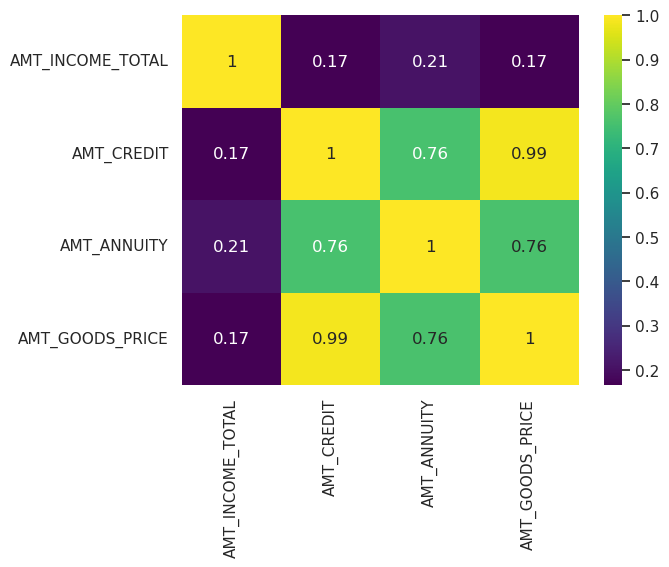

In [47]:
a = combined_appl_data[["AMT_INCOME_TOTAL","AMT_CREDIT","AMT_ANNUITY","AMT_GOODS_PRICE"]].corr()
sns.heatmap(a, annot=True, cmap="viridis")

Heatmap correlation of critical features

In [48]:
# curr_appl_data1.to_csv('curr.csv')
# prev_appl_data1.to_csv('prev.csv')

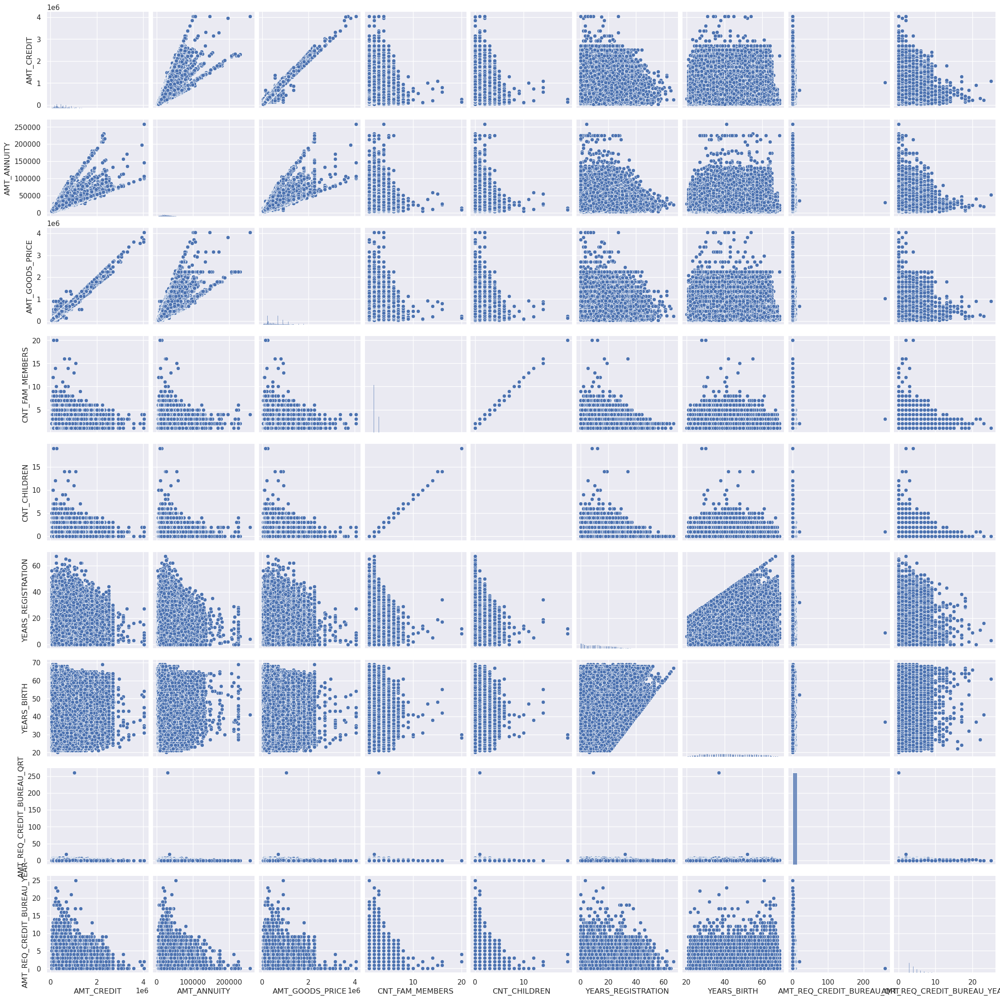

In [49]:
pairplot = sns.pairplot(curr_appl_data1[['AMT_CREDIT','AMT_ANNUITY', 'AMT_GOODS_PRICE', 'CNT_FAM_MEMBERS', 'CNT_CHILDREN', 'YEARS_REGISTRATION', 'YEARS_BIRTH', 'AMT_REQ_CREDIT_BUREAU_QRT', 'AMT_REQ_CREDIT_BUREAU_YEAR']])
plt.show();
# Rotate the x-axis labels
# for ax in pairplot.axes.flat:
#     ax.set_xlabel(ax.get_xlabel(), rotation=90,  labelpad=10)
#     ax.set_ylabel(ax.get_ylabel(), rotation=0, ha='right', labelpad=10)


Some of the high linear relationships observed as below:
• 'AMT_CREDIT','AMT_ANNUITY','AMT_GOODS_PRICE’,
• Therefore More the price of the goods, higher the credit amount
• 'CNT_FAM_MEMBERS','CNT_CHILDREN’,
• 'YEARS_REGISTRATION','YEARS_BIRTH’, 
• 'AMT_CREDIT  vs 'AMT_REQ_CREDIT_BUREAU_YEAR’,
